---
### EE4211 Project Final

Group 3 : Hai Di Lao 

> Law Yiwei Jason,  A0135840J

> Sourav Dey, A0104279E

> Yew Wei Jian, A0162423N
 
> Xi Meng, A0126317L

---


### Initialization:



---


**Importing Packages required:**


---





In [1]:
import numpy as np
import pandas as pd
import datetime
import time
import matplotlib.pyplot as plt
from pandas import read_csv
from scipy.stats.stats import pearsonr
from collections import defaultdict
import sklearn
from sklearn.linear_model import LinearRegression
from datetime import datetime 
from sklearn.svm import SVR

---

Reading CSV File from Google Drive (Uploaded the original file from IVLE onto Google Drive)

---



In [2]:
file_id = '1yBw5C7YYpzET7SWc_C8-noCh7L8RH3aD'
link='https://drive.google.com/uc?export=download&id={FILE_ID}'
csv_url=link.format(FILE_ID=file_id)
df = read_csv(csv_url,parse_dates=True, dayfirst=True)

### 1. Interim:


---

We have sorted the values by dataid and localminute, with dataid being sorted first before localminute.
Conversion of the column 'localminute' from 'String' to 'Timestamp' format.

This achieves two things:

1.   Reduces the date such that it only shows YY-MM-DD HH:MM:SS. The omitted characters describe the nanoseconds of the reading timestamps and are assumed to be constant throughout this project. Makes it neater as the other values do not affect our decisions. 
2.   Pandas' 'Timestamp' is equivalent to python's 'datetime' format, it would allow us to use various 'Timestamp' functions such as comparison, day, month, resampling later on. 



---


In [3]:
df_sorted = df.sort_values(by=["dataid", "localminute"])
houses = df_sorted.dataid.unique()

# Conversion of localminute from string to TimeStamp
local_minute = list(pd.to_datetime(df_sorted.localminute.str[:19]))
df_sorted = df_sorted.drop(columns = 'localminute')
df_sorted['localminute'] = local_minute


**1.1) How many houses are there?**

In [4]:
number_of_houses = len(houses)
print(f"There are a total of {number_of_houses} that are included in this measurement study.")
print(f'There are a total of {len(df_sorted)} data points in this study.')

There are a total of 157 that are included in this measurement study.
There are a total of 1584823 data points in this study.


---
Next, we compute the difference in meter value and time between two consecutive readings for each house in this study. 

The difference in meter value and the difference in time value would be added as new dataframe columns of 'meter_diff' and 'time_diff' respectively.

---



In [5]:
# This takes awhile to run 
# Add the difference between consecutive meter value readings in a new column 
df_grouped = df_sorted
df_withdiff = pd.DataFrame()

df_grouped = df_grouped.groupby('dataid')

for house in houses: 
  meter_difference = []
  time_difference = []
  meter_previous = None
  time_previous = None
  df_house = df_grouped.get_group(house).copy()
  for i,x in enumerate(df_house.index):
    meter_current = df_house.loc[x,'meter_value']
    time_current = df_house.loc[x,'localminute']
    if i == 0:
      meter_difference.append(0)
      meter_previous = meter_current
      time_difference.append(None)
      time_previous = time_current
    else:
      diff = meter_current-meter_previous
      meter_difference.append(diff)
      meter_previous = meter_current
      diff = (time_current-time_previous).total_seconds()
      time_difference.append(diff)
      time_previous = time_current
  df_house['meter_diff'] = meter_difference
  df_house['time_diff'] = time_difference
  df_withdiff = pd.concat([df_withdiff,df_house])
  
print('Completed!')

Completed!


In [6]:
df_withdiff.head(5)
#NaN is for first entry of each house

,dataid,meter_value,localminute,meter_diff,time_diff
83,35,93470,2015-10-01 00:14:44,0,NaN
244,35,93470,2015-10-01 00:42:34,0,1670.0
723,35,93470,2015-10-01 02:02:37,0,4803.0
790,35,93470,2015-10-01 02:12:38,0,601.0
829,35,93470,2015-10-01 02:20:36,0,478.0


**1.1) Identifying malfunctioning meters and time periods**

Looking at the data increments between each consecutive reading, we noted that there was a large distribution of incremental readings. We sought to first understand the data distribution of each increment of data and aggregate their frequency in the dictionary freq_dist. Here, the dict key is the incremental change and the corresponding value is the number of times the such an incremental change was observed.


---



In [7]:
#Get the individual deltas between every single time increment for all 157 houses 
prev_value = 0
overall_raw = []
duplicates = 0
non_identical_duplicates = 0


for house in houses:
  
    df_copy = df_withdiff.copy()
    df_copy = df_copy[df_copy['dataid'].isin([house])]
    values = list(df_copy['meter_diff'])
    times = list(df_copy['time_diff'])
    
    i=1
    
    while i < len(values):
 
        if times[i] != 0:
            overall_raw.append(values[i])
        
        elif times[i] == 0 and values[i] == 0:
            duplicates +=1
            
        elif times[i] == 0 and values[i] != 0: #same time value -> but the value changes.
            non_identical_duplicates +=1
          
        i+=1
        

#Get the frequency distribution for each interval and store in dict

freq_dist = {}
for i in overall_raw:
    if i in freq_dist:
        freq_dist[i] += 1.0
    else:
        freq_dist[i] = 1.0



---
Upon getting the all the incremental readings, we sort the readings in decreasing order of its frequency. That is to say, the first element on the list will be the incremental change that was observed the most often in the entire dataset spanning the 157 houses. Similarly, the second element on the list will be the incremental change value that was the second most frequent in the dataset, and so on. 

From here, we assumed that 99% of the values obtained were correct and that the outlying 1% of readings should be classified as erroneous readings. From here, we establish an if loop determines the values that fall within the 99% threshold of all the obtained readings. We start by adding the most frequent reading value and checking to see if it exceeds the 0.99 threshold. If not, we proceed to add the second most frequent reading and so on and so forth, up until the point where the cdf value of 0.99 is exceeded.

At this juncture,all the incremental readings whose frequencies were tallied in the previous step from an array of the acceptable values for this dataset. That is to say, any value that falls outside this dataset is considered to be unacceptable and should be dealt with accordingly in the following steps.

---



In [8]:
# Get the most common values of the each interval jump in descending order

ordered_freq_dist = sorted(freq_dist.items(), key = lambda x: x[1])
ordered_freq_dist.reverse()
edited_freq_dist = []


# Convert it to a single dimension list
for element in ordered_freq_dist:
    edited_freq_dist.append(element[0])

# Find out point up to where 99% of values are correct. Assumes that outlying 1% of readings are bad.
cumulative_freq=0
threshold_values = []

for element in edited_freq_dist:
    cdf = cumulative_freq/len(overall_raw)
    if (cdf<0.99):
        cumulative_freq += freq_dist[element]
        threshold_values.append(element)
    else:
        break
        
        
print(f'There are {len(threshold_values)} acceptable increment values.')
print('The acceptable increment values are:')
print(threshold_values)

There are 17 acceptable increment values.
The acceptable increment values are:
[0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30, 32]


---

**1.1 Generate new dataframe after deleting away error rows**

---

With the threshold defined above, we got rid of the errors & duplicates in the dataset. 

It is important to get rid of the errors and duplicates as these might cause errors when finding the correlation between houses.  

The difference between readings is used for correlation, as such, the removal of the erroneous increases would not 

In [9]:
# To remove difference < 0
df_without_errors = df_withdiff.loc[~(df_withdiff['meter_diff']<min(threshold_values))]
  
# To remove difference > 32
df_without_errors = df_without_errors.loc[~(df_without_errors['meter_diff']>max(threshold_values))]  
print(f'After removing the errors from meter readings, there are {len(df_without_errors)} datapoints left')

# To remove duplicate timings: 
df_z = df_without_errors.groupby('dataid')
df_zzz = pd.DataFrame()
for house in houses: 
  df_house = df_z.get_group(house).copy()
  df_house.drop_duplicates(subset = 'localminute',keep = 'first',inplace = True)
  df_zzz = pd.concat([df_zzz,df_house])

df_without_errors = df_zzz.copy()
print(f'After removing the duplicate readings, there are {len(df_without_errors)} datapoints left')

After removing the errors from meter readings, there are 1570319 datapoints left
After removing the duplicate readings, there are 1561995 datapoints left


In [10]:
## This set of code is to generate the error periods. 
## As it may take quite long to run (more than 20 minutes)
## We have shown a sample at the bottom for reference. 

df_wo_errors = df_without_errors.groupby('dataid')
df_w_errors = df_withdiff.groupby('dataid')

start_error = []
end_error = []

prev_house = 0


"""
Change 'print_out_errors' to True if you want to see the error messages and times.
Printing out all the errors takes more time (a few minutes).
Format: "[Index]:[Type of Error] at [Time]"

"""
prev_error = False
print_out_errors = False

for house in houses:
    df_x = df_wo_errors.get_group(house).copy()
    df_y = df_w_errors.get_group(house).copy()
    dropped_error = 0 
    toohigh_error = 0 
    duplicate_error = 0
    print(f'Errors & Duplicates for house {house}')
    print('--------------------------------------------------------------------------------------')


    current_error = False

    prev_y = 0

    for i,y in enumerate(df_y.index):
      try:

        z=df_x.loc[y]
        current_error = False

      except KeyError:

        current_error = True

        if df_y.loc[y].meter_diff < 0:
          dropped_error += 1
          if print_out_errors == True:
            print(f'[{y}]:Meter reading dropped ({df_y.loc[y].meter_diff}) at {df_y.loc[y].localminute}')        

        elif df_y.loc[y].meter_diff > 32:
          toohigh_error += 1
          if print_out_errors == True:
            print(f'[{y}]:Meter reading rose above threshold ({df_y.loc[y].meter_diff}) at {df_y.loc[y].localminute}')

        else:
          duplicate_error += 1
          if print_out_errors == True:
            print(f'[{y}]:Duplicate reading at {df_y.loc[y].localminute}')


      if (prev_error == True and current_error == False): 
        end_error.append(y)

      elif (df_y.loc[y].dataid != prev_house and prev_error == True):
        end_error.append(prev_y)

      elif prev_error == False and current_error == True:
        start_error.append(y)


      prev_house = df_y.loc[y].dataid
      prev_error = current_error
      prev_y = y
    print(len(start_error))
    print(len(end_error))


print(len(start_error))
print(len(end_error))

Errors & Duplicates for house 35
--------------------------------------------------------------------------------------
75
75
Errors & Duplicates for house 44
--------------------------------------------------------------------------------------
116
116
Errors & Duplicates for house 77
--------------------------------------------------------------------------------------
172
172
Errors & Duplicates for house 94
--------------------------------------------------------------------------------------
182
182
Errors & Duplicates for house 114
--------------------------------------------------------------------------------------
272
272
Errors & Duplicates for house 187
--------------------------------------------------------------------------------------
341
341
Errors & Duplicates for house 222
--------------------------------------------------------------------------------------
434
434
Errors & Duplicates for house 252
---------------------------------------------------------------------

7968
7968
Errors & Duplicates for house 3635
--------------------------------------------------------------------------------------
8016
8016
Errors & Duplicates for house 3723
--------------------------------------------------------------------------------------
8106
8106
Errors & Duplicates for house 3778
--------------------------------------------------------------------------------------
8150
8150
Errors & Duplicates for house 3849
--------------------------------------------------------------------------------------
8251
8251
Errors & Duplicates for house 3893
--------------------------------------------------------------------------------------
8397
8397
Errors & Duplicates for house 3918
--------------------------------------------------------------------------------------
8539
8539
Errors & Duplicates for house 4029
--------------------------------------------------------------------------------------
8618
8618
Errors & Duplicates for house 4031
-------------------------------

15625
15625
Errors & Duplicates for house 7900
--------------------------------------------------------------------------------------
15769
15769
Errors & Duplicates for house 7919
--------------------------------------------------------------------------------------
15826
15826
Errors & Duplicates for house 7965
--------------------------------------------------------------------------------------
15881
15880
Errors & Duplicates for house 7989
--------------------------------------------------------------------------------------
15883
15883
Errors & Duplicates for house 8059
--------------------------------------------------------------------------------------
15932
15932
Errors & Duplicates for house 8084
--------------------------------------------------------------------------------------
15987
15987
Errors & Duplicates for house 8086
--------------------------------------------------------------------------------------
16157
16157
Errors & Duplicates for house 8155
---------------

In [11]:
for i,x in enumerate(end_error):
    print(f'For house {df_withdiff.loc[x].dataid}, error between {df_withdiff.loc[start_error[i]].localminute} and {df_withdiff.loc[x].localminute}.')
  

For house 35, error between 2015-10-20 09:00:12 and 2015-10-20 09:41:07.
For house 35, error between 2015-10-27 00:10:09 and 2015-10-27 01:14:04.
For house 35, error between 2015-12-04 09:25:29 and 2015-12-04 09:55:22.
For house 35, error between 2016-01-01 05:18:49 and 2016-01-01 05:45:43.
For house 35, error between 2016-01-01 15:55:02 and 2016-01-01 15:56:01.
For house 35, error between 2016-01-05 17:25:59 and 2016-01-05 17:38:59.
For house 35, error between 2016-01-06 10:41:01 and 2016-01-06 10:57:46.
For house 35, error between 2016-01-08 14:25:50 and 2016-01-08 14:30:49.
For house 35, error between 2016-01-08 19:11:57 and 2016-01-08 19:35:02.
For house 35, error between 2016-01-09 00:34:11 and 2016-01-09 00:38:05.
For house 35, error between 2016-01-09 06:38:56 and 2016-01-09 06:56:50.
For house 35, error between 2016-01-09 07:17:51 and 2016-01-09 08:03:58.
For house 35, error between 2016-01-13 10:39:10 and 2016-01-13 10:43:07.
For house 35, error between 2016-01-13 11:00:56 and

For house 114, error between 2016-01-13 08:58:34 and 2016-01-13 10:10:42.
For house 114, error between 2016-01-13 18:26:40 and 2016-01-13 19:25:50.
For house 114, error between 2016-01-14 10:42:34 and 2016-01-14 13:06:47.
For house 114, error between 2016-01-16 17:42:37 and 2016-01-16 19:54:43.
For house 114, error between 2016-01-16 21:52:35 and 2016-01-17 00:19:43.
For house 114, error between 2016-01-17 12:05:38 and 2016-01-18 01:22:42.
For house 114, error between 2016-01-18 10:32:34 and 2016-01-19 06:19:40.
For house 114, error between 2016-01-20 17:21:29 and 2016-01-20 17:35:27.
For house 114, error between 2016-01-22 13:16:47 and 2016-01-22 13:20:44.
For house 114, error between 2016-01-22 17:31:42 and 2016-01-22 17:43:45.
For house 114, error between 2016-01-22 22:57:38 and 2016-01-23 00:55:31.
For house 114, error between 2016-01-23 07:15:33 and 2016-01-23 07:19:39.
For house 114, error between 2016-01-24 04:34:34 and 2016-01-24 12:31:36.
For house 114, error between 2016-01-2

For house 370, error between 2016-02-04 09:22:16 and 2016-02-04 09:45:21.
For house 370, error between 2016-02-05 17:40:30 and 2016-02-05 18:48:22.
For house 370, error between 2016-02-07 12:17:26 and 2016-02-07 12:32:31.
For house 370, error between 2016-02-08 09:05:27 and 2016-02-08 10:14:21.
For house 370, error between 2016-02-08 23:13:19 and 2016-02-09 00:35:29.
For house 370, error between 2016-02-09 12:25:17 and 2016-02-09 14:24:26.
For house 370, error between 2016-02-09 17:10:24 and 2016-02-09 17:30:26.
For house 370, error between 2016-02-10 10:36:33 and 2016-02-10 10:45:34.
For house 370, error between 2016-02-24 10:39:32 and 2016-02-24 11:28:23.
For house 483, error between 2015-10-21 00:18:54 and 2015-10-21 00:21:12.
For house 483, error between 2015-12-18 07:04:24 and 2015-12-18 07:11:38.
For house 483, error between 2015-12-28 17:57:18 and 2015-12-28 18:14:04.
For house 483, error between 2015-12-30 19:45:03 and 2015-12-30 20:49:04.
For house 483, error between 2015-12-3

For house 744, error between 2016-01-26 22:10:15 and 2016-01-26 22:33:15.
For house 744, error between 2016-01-27 06:55:17 and 2016-01-27 07:49:08.
For house 744, error between 2016-01-28 06:48:23 and 2016-01-28 06:55:21.
For house 744, error between 2016-01-29 05:11:15 and 2016-01-29 05:45:08.
For house 744, error between 2016-01-30 18:35:13 and 2016-01-30 20:33:17.
For house 744, error between 2016-01-31 13:37:23 and 2016-01-31 14:01:27.
For house 744, error between 2016-02-01 23:03:19 and 2016-02-01 23:35:27.
For house 744, error between 2016-02-02 20:02:18 and 2016-02-02 20:41:26.
For house 744, error between 2016-02-04 00:45:10 and 2016-02-04 00:56:14.
For house 744, error between 2016-02-04 05:26:16 and 2016-02-04 11:59:12.
For house 744, error between 2016-02-05 05:49:07 and 2016-02-05 06:23:15.
For house 744, error between 2016-02-05 08:39:23 and 2016-02-05 09:02:09.
For house 744, error between 2016-02-06 05:26:18 and 2016-02-06 06:38:07.
For house 744, error between 2016-02-0

For house 1185, error between 2016-01-31 22:37:08 and 2016-01-31 23:35:06.
For house 1185, error between 2016-02-02 07:22:57 and 2016-02-02 07:27:56.
For house 1185, error between 2016-02-02 14:31:56 and 2016-02-02 14:36:56.
For house 1185, error between 2016-02-02 17:50:04 and 2016-02-02 18:08:02.
For house 1185, error between 2016-02-03 05:55:12 and 2016-02-03 06:22:03.
For house 1185, error between 2016-02-03 15:24:06 and 2016-02-03 15:35:00.
For house 1185, error between 2016-02-03 23:52:04 and 2016-02-03 23:55:00.
For house 1185, error between 2016-02-04 15:01:08 and 2016-02-04 15:03:09.
For house 1185, error between 2016-02-05 04:15:06 and 2016-02-05 04:23:02.
For house 1185, error between 2016-02-05 05:36:53 and 2016-02-05 05:49:58.
For house 1185, error between 2016-02-05 06:50:54 and 2016-02-05 06:52:52.
For house 1185, error between 2016-02-07 08:38:49 and 2016-02-07 08:41:48.
For house 1185, error between 2016-02-07 08:50:49 and 2016-02-07 08:52:51.
For house 1185, error bet

For house 1556, error between 2016-03-12 22:09:41 and 2016-03-12 22:14:41.
For house 1556, error between 2016-03-19 13:40:10 and 2016-03-19 14:34:11.
For house 1556, error between 2016-03-21 18:54:06 and 2016-03-22 15:26:48.
For house 1556, error between 2016-03-25 09:02:01 and 2016-03-25 10:47:02.
For house 1589, error between 2015-10-27 00:02:55 and 2015-10-27 00:07:54.
For house 1589, error between 2015-11-22 17:36:32 and 2015-11-22 17:47:48.
For house 1589, error between 2015-11-22 23:46:33 and 2015-11-22 23:49:39.
For house 1589, error between 2015-11-24 07:11:31 and 2015-11-24 07:14:40.
For house 1589, error between 2015-11-28 06:00:04 and 2015-11-28 06:06:03.
For house 1589, error between 2015-11-28 08:53:24 and 2015-11-28 08:54:53.
For house 1589, error between 2015-11-28 12:13:47 and 2015-11-28 12:19:30.
For house 1589, error between 2015-11-29 03:02:00 and 2015-11-29 03:05:33.
For house 1589, error between 2015-11-29 05:55:36 and 2015-11-29 06:03:00.
For house 1589, error bet

For house 1718, error between 2016-01-24 23:39:50 and 2016-01-24 23:43:46.
For house 1718, error between 2016-01-24 23:49:52 and 2016-01-24 23:50:53.
For house 1718, error between 2016-01-24 23:50:53 and 2016-01-24 23:57:50.
For house 1718, error between 2016-01-25 00:16:48 and 2016-01-25 00:27:54.
For house 1718, error between 2016-01-25 00:47:40 and 2016-01-25 01:02:45.
For house 1718, error between 2016-01-25 01:17:44 and 2016-01-25 01:19:44.
For house 1718, error between 2016-01-25 02:29:45 and 2016-01-25 02:37:46.
For house 1718, error between 2016-01-25 02:37:46 and 2016-01-25 02:48:48.
For house 1718, error between 2016-01-25 03:31:58 and 2016-01-25 03:33:00.
For house 1718, error between 2016-01-25 04:07:48 and 2016-01-25 04:09:50.
For house 1718, error between 2016-01-25 04:09:50 and 2016-01-25 04:19:52.
For house 1718, error between 2016-01-25 04:26:49 and 2016-01-25 04:28:48.
For house 1718, error between 2016-01-25 05:18:46 and 2016-01-25 05:19:46.
For house 1718, error bet

For house 1790, error between 2015-11-21 21:19:11 and 2015-11-21 21:26:12.
For house 1790, error between 2015-11-22 08:11:11 and 2015-11-22 08:16:04.
For house 1790, error between 2015-11-22 08:35:10 and 2015-11-22 09:12:02.
For house 1790, error between 2015-11-22 10:01:14 and 2015-11-22 10:10:11.
For house 1790, error between 2015-11-22 13:12:07 and 2015-11-22 13:50:07.
For house 1790, error between 2015-11-22 14:52:23 and 2015-11-22 14:56:24.
For house 1790, error between 2015-11-22 22:01:05 and 2015-11-22 22:03:03.
For house 1790, error between 2015-11-24 16:26:12 and 2015-11-24 16:31:11.
For house 1790, error between 2015-11-24 18:56:11 and 2015-11-24 19:12:05.
For house 1790, error between 2015-11-25 08:30:02 and 2015-11-25 08:39:03.
For house 1790, error between 2015-11-25 09:56:14 and 2015-11-25 09:59:18.
For house 1790, error between 2015-11-27 22:07:12 and 2015-11-27 22:22:17.
For house 1790, error between 2015-11-28 08:13:04 and 2015-11-28 08:18:59.
For house 1790, error bet

For house 1800, error between 2016-01-24 10:54:54 and 2016-01-24 14:01:44.
For house 1800, error between 2016-01-24 16:45:59 and 2016-01-24 17:47:47.
For house 1800, error between 2016-01-25 01:16:54 and 2016-01-25 03:19:26.
For house 1800, error between 2016-01-25 07:27:24 and 2016-01-25 07:43:29.
For house 1800, error between 2016-01-27 04:11:48 and 2016-01-27 04:25:43.
For house 1800, error between 2016-01-27 20:47:42 and 2016-01-27 23:17:58.
For house 1800, error between 2016-01-28 08:33:55 and 2016-01-28 08:50:54.
For house 1800, error between 2016-01-29 05:45:51 and 2016-01-29 06:17:39.
For house 1800, error between 2016-01-29 18:25:52 and 2016-01-29 19:14:43.
For house 1800, error between 2016-01-30 07:53:44 and 2016-01-30 10:01:57.
For house 1800, error between 2016-01-30 11:57:46 and 2016-01-30 13:55:48.
For house 1800, error between 2016-01-31 18:19:34 and 2016-01-31 18:43:43.
For house 1800, error between 2016-02-02 11:05:33 and 2016-02-02 13:39:51.
For house 1800, error bet

For house 2034, error between 2015-12-31 12:58:11 and 2015-12-31 13:00:56.
For house 2034, error between 2015-12-31 13:35:11 and 2015-12-31 13:36:26.
For house 2034, error between 2015-12-31 13:42:10 and 2015-12-31 13:47:41.
For house 2034, error between 2015-12-31 15:03:25 and 2015-12-31 15:03:56.
For house 2034, error between 2015-12-31 15:56:56 and 2015-12-31 15:59:11.
For house 2034, error between 2015-12-31 18:11:41 and 2015-12-31 18:13:10.
For house 2034, error between 2015-12-31 18:40:11 and 2015-12-31 18:40:40.
For house 2034, error between 2015-12-31 19:52:25 and 2015-12-31 19:53:10.
For house 2034, error between 2016-01-01 03:14:11 and 2016-01-01 03:18:11.
For house 2034, error between 2016-01-01 06:01:41 and 2016-01-01 06:02:40.
For house 2034, error between 2016-01-01 06:07:41 and 2016-01-01 06:11:55.
For house 2034, error between 2016-01-01 06:12:56 and 2016-01-01 06:14:41.
For house 2034, error between 2016-01-01 07:02:26 and 2016-01-01 07:03:11.
For house 2034, error bet

For house 2034, error between 2016-02-06 13:57:26 and 2016-02-06 13:57:57.
For house 2034, error between 2016-02-06 13:58:41 and 2016-02-06 13:59:11.
For house 2034, error between 2016-02-06 15:54:57 and 2016-02-06 15:59:11.
For house 2034, error between 2016-02-06 16:52:12 and 2016-02-06 16:53:26.
For house 2034, error between 2016-02-06 17:17:12 and 2016-02-06 17:25:12.
For house 2034, error between 2016-02-06 23:40:57 and 2016-02-06 23:45:57.
For house 2034, error between 2016-02-07 00:57:42 and 2016-02-07 01:03:41.
For house 2034, error between 2016-02-07 01:48:56 and 2016-02-07 01:50:42.
For house 2034, error between 2016-02-07 02:25:12 and 2016-02-07 02:28:42.
For house 2034, error between 2016-02-07 10:18:28 and 2016-02-07 10:19:28.
For house 2034, error between 2016-02-07 14:19:41 and 2016-02-07 14:27:27.
For house 2034, error between 2016-02-07 14:44:12 and 2016-02-07 14:44:41.
For house 2034, error between 2016-02-07 15:01:42 and 2016-02-07 15:02:57.
For house 2034, error bet

For house 2072, error between 2015-11-29 05:33:11 and 2015-11-29 05:34:09.
For house 2072, error between 2015-11-29 17:27:20 and 2015-11-29 17:47:20.
For house 2072, error between 2015-11-30 08:07:08 and 2015-11-30 08:13:06.
For house 2072, error between 2015-12-03 07:04:03 and 2015-12-03 07:28:02.
For house 2072, error between 2015-12-05 05:48:04 and 2015-12-05 05:57:09.
For house 2072, error between 2015-12-17 18:27:03 and 2015-12-17 18:29:01.
For house 2072, error between 2015-12-19 05:20:45 and 2015-12-19 05:28:47.
For house 2072, error between 2015-12-28 04:50:46 and 2015-12-28 05:10:54.
For house 2072, error between 2015-12-28 05:54:46 and 2015-12-28 06:29:51.
For house 2072, error between 2015-12-28 07:36:36 and 2015-12-28 08:47:46.
For house 2072, error between 2015-12-28 17:16:50 and 2015-12-28 17:27:47.
For house 2072, error between 2015-12-28 17:50:54 and 2015-12-28 18:08:52.
For house 2072, error between 2015-12-29 05:04:36 and 2015-12-29 05:46:46.
For house 2072, error bet

For house 2129, error between 2016-01-10 10:33:38 and 2016-01-10 10:50:35.
For house 2129, error between 2016-01-10 14:49:33 and 2016-01-10 15:36:45.
For house 2129, error between 2016-01-10 21:53:42 and 2016-01-10 22:13:41.
For house 2129, error between 2016-01-11 01:21:47 and 2016-01-11 01:24:46.
For house 2129, error between 2016-01-11 04:31:50 and 2016-01-11 04:57:56.
For house 2129, error between 2016-01-11 08:34:47 and 2016-01-11 08:41:46.
For house 2129, error between 2016-01-11 13:40:48 and 2016-01-11 13:44:45.
For house 2129, error between 2016-01-11 21:27:53 and 2016-01-11 21:47:57.
For house 2129, error between 2016-01-12 00:51:43 and 2016-01-12 00:54:43.
For house 2129, error between 2016-01-12 15:17:46 and 2016-01-12 15:32:47.
For house 2129, error between 2016-01-13 00:51:40 and 2016-01-13 02:09:45.
For house 2129, error between 2016-01-14 10:54:32 and 2016-01-14 11:34:39.
For house 2129, error between 2016-01-14 20:44:47 and 2016-01-14 21:00:50.
For house 2129, error bet

For house 2335, error between 2016-03-19 08:14:06 and 2016-03-19 09:58:28.
For house 2335, error between 2016-03-19 22:37:25 and 2016-03-19 22:40:20.
For house 2335, error between 2016-03-20 07:24:20 and 2016-03-20 08:22:06.
For house 2335, error between 2016-03-20 10:54:24 and 2016-03-20 11:10:30.
For house 2335, error between 2016-03-20 19:07:21 and 2016-03-20 19:38:25.
For house 2335, error between 2016-03-21 06:15:07 and 2016-03-21 06:26:08.
For house 2335, error between 2016-03-21 18:14:16 and 2016-03-21 19:20:10.
For house 2335, error between 2016-03-22 15:51:08 and 2016-03-22 17:31:26.
For house 2335, error between 2016-03-26 08:19:15 and 2016-03-26 12:20:10.
For house 2378, error between 2015-10-04 22:50:55 and 2015-10-05 11:34:40.
For house 2378, error between 2015-10-29 11:29:50 and 2015-10-29 22:39:49.
For house 2378, error between 2015-11-03 06:25:16 and 2015-11-03 19:05:01.
For house 2378, error between 2015-11-16 21:46:33 and 2015-11-17 00:30:49.
For house 2378, error bet

For house 2461, error between 2016-03-06 19:35:59 and 2016-03-06 19:45:58.
For house 2461, error between 2016-03-07 02:52:42 and 2016-03-07 03:14:47.
For house 2461, error between 2016-03-08 21:21:45 and 2016-03-08 21:35:47.
For house 2461, error between 2016-03-10 03:49:52 and 2016-03-10 04:25:47.
For house 2461, error between 2016-03-10 08:47:44 and 2016-03-10 09:13:41.
For house 2461, error between 2016-03-12 05:15:38 and 2016-03-12 05:29:44.
For house 2461, error between 2016-03-12 20:29:34 and 2016-03-12 20:41:33.
For house 2461, error between 2016-03-19 23:43:32 and 2016-03-19 23:45:31.
For house 2461, error between 2016-03-20 11:51:27 and 2016-03-20 12:21:30.
For house 2461, error between 2016-03-20 19:39:16 and 2016-03-20 20:13:22.
For house 2461, error between 2016-03-21 12:17:13 and 2016-03-21 12:35:19.
For house 2461, error between 2016-03-24 02:47:05 and 2016-03-24 03:01:06.
For house 2461, error between 2016-03-24 03:01:06 and 2016-03-24 03:23:05.
For house 2461, error bet

For house 2965, error between 2015-12-18 07:12:28 and 2015-12-18 09:47:11.
For house 2965, error between 2015-12-18 18:29:11 and 2015-12-18 18:33:12.
For house 2965, error between 2015-12-20 09:09:24 and 2015-12-20 10:05:24.
For house 2965, error between 2015-12-28 19:07:32 and 2015-12-28 19:15:32.
For house 2965, error between 2016-01-02 15:22:13 and 2016-01-02 17:16:26.
For house 2965, error between 2016-01-03 16:29:20 and 2016-01-03 17:12:25.
For house 2965, error between 2016-01-04 07:04:27 and 2016-01-04 10:34:35.
For house 2965, error between 2016-01-04 17:47:12 and 2016-01-04 18:05:24.
For house 2965, error between 2016-01-05 06:42:24 and 2016-01-05 06:52:27.
For house 2965, error between 2016-01-05 17:41:23 and 2016-01-05 18:20:18.
For house 2965, error between 2016-01-10 10:07:33 and 2016-01-10 10:29:32.
For house 2965, error between 2016-01-11 06:51:37 and 2016-01-11 07:51:36.
For house 2965, error between 2016-01-11 19:15:40 and 2016-01-11 19:19:43.
For house 2965, error bet

For house 3527, error between 2016-02-20 05:36:09 and 2016-02-20 06:39:06.
For house 3527, error between 2016-02-20 07:47:22 and 2016-02-20 08:14:29.
For house 3527, error between 2016-02-20 20:46:27 and 2016-02-20 21:11:15.
For house 3527, error between 2016-02-21 05:56:21 and 2016-02-21 06:58:14.
For house 3527, error between 2016-02-21 06:58:14 and 2016-02-21 08:31:14.
For house 3527, error between 2016-02-22 07:22:17 and 2016-02-22 08:05:12.
For house 3527, error between 2016-02-22 08:50:05 and 2016-02-22 09:01:10.
For house 3527, error between 2016-02-22 22:49:22 and 2016-02-23 00:32:14.
For house 3527, error between 2016-02-23 02:04:09 and 2016-02-23 02:11:13.
For house 3527, error between 2016-02-23 05:14:12 and 2016-02-23 06:37:18.
For house 3527, error between 2016-02-24 05:42:21 and 2016-02-24 06:24:13.
For house 3527, error between 2016-02-24 08:30:25 and 2016-02-24 08:38:26.
For house 3527, error between 2016-02-24 20:05:08 and 2016-02-24 20:26:16.
For house 3527, error bet

For house 3849, error between 2016-01-21 19:01:29 and 2016-01-21 23:17:29.
For house 3849, error between 2016-01-22 08:28:35 and 2016-01-22 09:45:43.
For house 3849, error between 2016-01-23 01:43:44 and 2016-01-23 02:42:39.
For house 3849, error between 2016-01-23 04:51:27 and 2016-01-23 05:07:34.
For house 3849, error between 2016-01-23 07:48:28 and 2016-01-23 11:37:43.
For house 3849, error between 2016-01-23 22:10:36 and 2016-01-24 04:50:30.
For house 3849, error between 2016-01-24 08:17:43 and 2016-01-24 08:32:42.
For house 3849, error between 2016-01-24 10:34:37 and 2016-01-24 11:01:39.
For house 3849, error between 2016-01-24 19:49:48 and 2016-01-24 20:28:36.
For house 3849, error between 2016-01-25 09:55:40 and 2016-01-25 10:53:32.
For house 3849, error between 2016-01-26 11:03:41 and 2016-01-26 12:29:29.
For house 3849, error between 2016-01-26 16:09:28 and 2016-01-26 23:35:42.
For house 3849, error between 2016-01-27 09:51:32 and 2016-01-27 09:52:34.
For house 3849, error bet

For house 4031, error between 2016-01-22 19:29:42 and 2016-01-22 19:44:43.
For house 4031, error between 2016-01-23 08:14:44 and 2016-01-23 08:26:41.
For house 4031, error between 2016-01-23 12:50:44 and 2016-01-23 12:59:44.
For house 4031, error between 2016-01-24 05:24:40 and 2016-01-24 05:53:44.
For house 4031, error between 2016-01-24 10:18:51 and 2016-01-24 10:23:51.
For house 4031, error between 2016-01-26 10:31:49 and 2016-01-26 10:37:54.
For house 4031, error between 2016-01-26 12:47:48 and 2016-01-26 12:53:47.
For house 4031, error between 2016-01-26 13:11:52 and 2016-01-26 13:17:51.
For house 4031, error between 2016-01-27 01:19:47 and 2016-01-27 02:09:58.
For house 4031, error between 2016-01-27 08:03:40 and 2016-01-27 09:05:39.
For house 4031, error between 2016-01-27 21:11:43 and 2016-01-27 21:15:40.
For house 4031, error between 2016-01-28 07:29:56 and 2016-01-28 07:31:56.
For house 4031, error between 2016-01-28 09:07:47 and 2016-01-28 09:39:44.
For house 4031, error bet

For house 4356, error between 2016-01-26 21:48:05 and 2016-01-26 22:01:05.
For house 4356, error between 2016-01-27 03:38:06 and 2016-01-27 11:45:04.
For house 4356, error between 2016-01-28 05:16:05 and 2016-01-28 08:55:05.
For house 4356, error between 2016-01-29 03:04:04 and 2016-01-29 03:36:05.
For house 4356, error between 2016-01-29 06:36:04 and 2016-01-29 09:55:05.
For house 4356, error between 2016-01-30 04:45:04 and 2016-01-30 09:35:03.
For house 4356, error between 2016-01-30 22:30:02 and 2016-01-30 23:31:03.
For house 4356, error between 2016-01-31 14:04:03 and 2016-01-31 14:17:02.
For house 4356, error between 2016-02-03 09:15:01 and 2016-02-03 09:57:01.
For house 4356, error between 2016-02-03 23:46:00 and 2016-02-03 23:52:59.
For house 4356, error between 2016-02-04 04:17:00 and 2016-02-04 08:45:00.
For house 4356, error between 2016-02-05 02:19:00 and 2016-02-05 03:16:00.
For house 4356, error between 2016-02-05 05:29:59 and 2016-02-05 14:10:59.
For house 4356, error bet

For house 4514, error between 2016-02-12 06:44:30 and 2016-02-12 06:53:33.
For house 4514, error between 2016-02-12 11:01:30 and 2016-02-12 11:08:34.
For house 4514, error between 2016-02-17 09:08:22 and 2016-02-17 10:11:22.
For house 4514, error between 2016-02-20 00:38:25 and 2016-02-20 00:59:20.
For house 4514, error between 2016-02-21 08:20:42 and 2016-02-21 08:46:34.
For house 4514, error between 2016-02-21 20:40:39 and 2016-02-21 21:06:35.
For house 4514, error between 2016-02-22 15:44:22 and 2016-02-22 15:55:21.
For house 4514, error between 2016-02-22 15:55:21 and 2016-02-22 16:08:17.
For house 4514, error between 2016-02-22 21:22:29 and 2016-02-22 21:42:35.
For house 4514, error between 2016-02-23 02:26:37 and 2016-02-23 03:38:27.
For house 4514, error between 2016-02-23 19:38:33 and 2016-02-23 19:52:34.
For house 4514, error between 2016-02-23 23:46:34 and 2016-02-24 00:10:30.
For house 4514, error between 2016-02-24 06:34:28 and 2016-02-24 07:02:32.
For house 4514, error bet

For house 4998, error between 2016-03-27 20:52:11 and 2016-03-27 21:46:17.
For house 4998, error between 2016-03-28 18:34:09 and 2016-03-28 18:41:14.
For house 4998, error between 2016-03-29 08:13:28 and 2016-03-29 08:37:22.
For house 4998, error between 2016-03-29 23:07:06 and 2016-03-29 23:36:07.
For house 4998, error between 2016-03-30 11:15:07 and 2016-03-30 11:19:10.
For house 4998, error between 2016-03-31 00:24:06 and 2016-03-31 01:00:02.
For house 5129, error between 2015-10-17 18:39:09 and 2015-10-17 19:26:09.
For house 5129, error between 2015-10-17 22:40:20 and 2015-10-17 23:22:57.
For house 5129, error between 2015-10-20 13:02:24 and 2015-10-20 13:05:24.
For house 5129, error between 2015-11-23 00:42:16 and 2015-11-23 00:48:19.
For house 5129, error between 2015-11-28 02:33:16 and 2015-11-28 03:42:27.
For house 5129, error between 2015-11-29 08:52:26 and 2015-11-29 09:50:18.
For house 5129, error between 2015-11-29 14:16:22 and 2015-11-29 19:07:17.
For house 5129, error bet

For house 5275, error between 2016-03-19 19:39:13 and 2016-03-19 23:15:21.
For house 5395, error between 2015-10-23 18:47:32 and 2015-10-24 21:41:15.
For house 5395, error between 2015-10-27 05:13:24 and 2015-10-27 06:21:27.
For house 5395, error between 2015-11-05 21:37:11 and 2015-11-08 11:02:28.
For house 5395, error between 2015-11-15 11:08:27 and 2015-11-15 12:16:17.
For house 5395, error between 2015-11-18 17:52:14 and 2015-11-18 18:39:20.
For house 5395, error between 2015-11-19 17:34:10 and 2015-11-19 17:42:08.
For house 5395, error between 2015-11-22 20:37:14 and 2015-11-23 03:31:18.
For house 5395, error between 2015-11-23 19:23:04 and 2015-11-24 02:06:13.
For house 5395, error between 2015-11-24 07:46:58 and 2015-11-24 07:51:03.
For house 5395, error between 2015-11-24 13:07:18 and 2015-11-24 14:47:09.
For house 5395, error between 2015-11-29 06:21:09 and 2015-11-29 06:57:21.
For house 5395, error between 2015-11-29 23:03:14 and 2015-12-02 23:54:09.
For house 5395, error bet

For house 5403, error between 2016-01-22 18:31:27 and 2016-01-22 18:43:29.
For house 5403, error between 2016-01-22 18:58:25 and 2016-01-22 19:04:23.
For house 5403, error between 2016-01-23 01:38:24 and 2016-01-23 01:41:29.
For house 5403, error between 2016-01-23 02:26:28 and 2016-01-23 03:14:29.
For house 5403, error between 2016-01-23 05:11:23 and 2016-01-23 05:13:23.
For house 5403, error between 2016-01-23 05:13:23 and 2016-01-23 05:33:23.
For house 5403, error between 2016-01-23 05:39:27 and 2016-01-23 05:46:28.
For house 5403, error between 2016-01-23 07:26:29 and 2016-01-23 07:34:24.
For house 5403, error between 2016-01-23 13:47:22 and 2016-01-23 13:50:23.
For house 5403, error between 2016-01-23 13:50:23 and 2016-01-23 13:53:21.
For house 5403, error between 2016-01-23 14:15:25 and 2016-01-23 14:19:29.
For house 5403, error between 2016-01-23 15:33:23 and 2016-01-23 15:35:24.
For house 5403, error between 2016-01-23 18:16:28 and 2016-01-23 18:18:28.
For house 5403, error bet

For house 5636, error between 2016-02-04 08:28:42 and 2016-02-04 08:32:43.
For house 5636, error between 2016-02-05 08:38:42 and 2016-02-05 08:40:42.
For house 5636, error between 2016-02-06 00:39:41 and 2016-02-06 01:28:40.
For house 5636, error between 2016-02-07 10:17:39 and 2016-02-07 18:20:39.
For house 5636, error between 2016-02-09 02:48:38 and 2016-02-09 03:38:38.
For house 5636, error between 2016-02-09 08:08:36 and 2016-02-09 09:30:37.
For house 5636, error between 2016-02-23 21:55:16 and 2016-02-23 22:38:16.
For house 5636, error between 2016-02-24 00:39:16 and 2016-02-24 02:13:16.
For house 5636, error between 2016-02-24 08:18:15 and 2016-02-24 09:37:15.
For house 5636, error between 2016-02-26 02:50:13 and 2016-02-26 03:37:12.
For house 5658, error between 2015-11-16 17:58:35 and 2015-11-16 21:43:35.
For house 5658, error between 2015-11-18 02:29:21 and 2015-11-18 03:45:21.
For house 5658, error between 2015-11-22 00:26:08 and 2015-11-22 04:04:08.
For house 5658, error bet

For house 5972, error between 2015-12-17 00:46:16 and 2015-12-17 01:12:20.
For house 5972, error between 2015-12-17 05:09:14 and 2015-12-17 08:06:10.
For house 5972, error between 2015-12-17 21:39:15 and 2015-12-17 23:31:18.
For house 5972, error between 2015-12-18 02:43:25 and 2015-12-18 03:10:27.
For house 5972, error between 2015-12-18 04:29:12 and 2015-12-18 04:45:14.
For house 5972, error between 2015-12-18 08:21:22 and 2015-12-18 09:06:14.
For house 5972, error between 2015-12-18 21:55:08 and 2015-12-18 22:59:15.
For house 5972, error between 2015-12-19 01:13:21 and 2015-12-19 02:58:10.
For house 5972, error between 2015-12-19 05:43:08 and 2015-12-19 06:19:08.
For house 5972, error between 2015-12-19 07:36:18 and 2015-12-19 07:37:16.
For house 5972, error between 2015-12-19 09:21:19 and 2015-12-19 10:11:16.
For house 5972, error between 2015-12-20 03:35:09 and 2015-12-20 03:53:09.
For house 5972, error between 2015-12-20 19:14:23 and 2015-12-20 19:31:08.
For house 5972, error bet

For house 6830, error between 2016-02-09 08:53:13 and 2016-02-09 09:16:12.
For house 6830, error between 2016-02-10 05:57:11 and 2016-02-10 13:14:22.
For house 6830, error between 2016-02-11 12:36:23 and 2016-02-11 13:59:21.
For house 6830, error between 2016-02-12 03:33:15 and 2016-02-12 05:27:20.
For house 6830, error between 2016-02-21 14:12:01 and 2016-02-21 16:20:10.
For house 6830, error between 2016-02-28 13:37:00 and 2016-02-28 17:52:59.
For house 6830, error between 2016-03-03 04:23:59 and 2016-03-03 08:05:47.
For house 6830, error between 2016-03-12 07:18:41 and 2016-03-12 12:16:36.
For house 6830, error between 2016-03-14 17:26:19 and 2016-03-14 18:36:40.
For house 6836, error between 2015-10-17 12:36:50 and 2015-10-17 13:37:48.
For house 6836, error between 2015-11-11 11:07:15 and 2015-11-11 19:20:11.
For house 6836, error between 2015-11-19 07:50:04 and 2015-11-19 07:55:03.
For house 6836, error between 2015-11-29 06:36:45 and 2015-11-29 06:59:47.
For house 6836, error bet

For house 6910, error between 2016-02-05 07:48:48 and 2016-02-05 07:49:52.
For house 6910, error between 2016-02-05 08:41:31 and 2016-02-05 08:42:15.
For house 6910, error between 2016-02-05 08:48:12 and 2016-02-05 08:49:15.
For house 6910, error between 2016-02-05 12:12:55 and 2016-02-05 12:13:28.
For house 6910, error between 2016-02-05 22:58:55 and 2016-02-05 23:06:45.
For house 6910, error between 2016-02-06 00:23:03 and 2016-02-06 00:25:49.
For house 6910, error between 2016-02-06 07:30:59 and 2016-02-06 07:31:44.
For house 6910, error between 2016-02-06 11:27:08 and 2016-02-06 11:34:39.
For house 6910, error between 2016-02-06 16:03:04 and 2016-02-06 16:03:52.
For house 6910, error between 2016-02-06 19:15:19 and 2016-02-06 19:17:58.
For house 6910, error between 2016-02-06 21:46:42 and 2016-02-06 21:55:01.
For house 6910, error between 2016-02-06 22:13:58 and 2016-02-06 22:14:26.
For house 6910, error between 2016-02-06 23:08:54 and 2016-02-06 23:11:25.
For house 6910, error bet

For house 7030, error between 2015-12-09 15:25:21 and 2015-12-09 15:37:26.
For house 7030, error between 2015-12-09 16:38:15 and 2015-12-09 17:29:10.
For house 7030, error between 2015-12-09 19:50:27 and 2015-12-09 20:33:18.
For house 7030, error between 2015-12-09 21:18:11 and 2015-12-09 22:24:05.
For house 7030, error between 2015-12-09 22:35:31 and 2015-12-09 23:03:12.
For house 7030, error between 2015-12-09 23:43:22 and 2015-12-10 00:25:22.
For house 7030, error between 2015-12-10 03:51:26 and 2015-12-10 04:01:20.
For house 7030, error between 2015-12-10 04:35:12 and 2015-12-10 04:41:13.
For house 7030, error between 2015-12-10 04:58:17 and 2015-12-10 05:03:17.
For house 7030, error between 2015-12-10 05:37:12 and 2015-12-10 06:06:10.
For house 7030, error between 2015-12-10 12:55:12 and 2015-12-10 13:07:18.
For house 7030, error between 2015-12-10 13:32:11 and 2015-12-10 13:36:18.
For house 7030, error between 2015-12-10 14:10:07 and 2015-12-10 14:23:07.
For house 7030, error bet

For house 7117, error between 2016-01-01 17:46:45 and 2016-01-01 17:49:46.
For house 7117, error between 2016-01-02 09:04:39 and 2016-01-02 09:24:42.
For house 7117, error between 2016-01-02 10:03:40 and 2016-01-02 10:32:46.
For house 7117, error between 2016-01-02 11:31:54 and 2016-01-02 11:34:55.
For house 7117, error between 2016-01-02 21:11:52 and 2016-01-02 21:55:43.
For house 7117, error between 2016-01-02 21:55:43 and 2016-01-02 22:17:38.
For house 7117, error between 2016-01-03 11:30:39 and 2016-01-03 11:33:38.
For house 7117, error between 2016-01-05 10:49:55 and 2016-01-05 11:10:54.
For house 7117, error between 2016-01-06 00:54:45 and 2016-01-06 01:03:41.
For house 7117, error between 2016-01-06 04:34:49 and 2016-01-06 04:36:47.
For house 7117, error between 2016-01-06 08:04:57 and 2016-01-06 08:24:45.
For house 7117, error between 2016-01-06 13:01:49 and 2016-01-06 13:05:44.
For house 7117, error between 2016-01-06 19:44:41 and 2016-01-06 19:49:42.
For house 7117, error bet

For house 7287, error between 2016-03-04 08:19:17 and 2016-03-04 08:19:31.
For house 7287, error between 2016-03-04 09:39:02 and 2016-03-04 09:42:16.
For house 7287, error between 2016-03-04 11:27:16 and 2016-03-04 11:36:46.
For house 7287, error between 2016-03-04 13:05:46 and 2016-03-04 13:12:47.
For house 7287, error between 2016-03-04 14:46:46 and 2016-03-04 14:59:16.
For house 7287, error between 2016-03-04 23:27:46 and 2016-03-04 23:30:31.
For house 7287, error between 2016-03-05 01:21:46 and 2016-03-05 01:39:01.
For house 7287, error between 2016-03-05 02:39:01 and 2016-03-05 02:39:16.
For house 7287, error between 2016-03-05 06:24:46 and 2016-03-05 06:36:31.
For house 7287, error between 2016-03-05 08:29:01 and 2016-03-05 08:35:17.
For house 7287, error between 2016-03-05 08:50:16 and 2016-03-05 08:51:16.
For house 7287, error between 2016-03-05 08:54:47 and 2016-03-05 08:55:32.
For house 7287, error between 2016-03-05 09:30:31 and 2016-03-05 09:43:31.
For house 7287, error bet

For house 7674, error between 2016-02-13 06:40:42 and 2016-02-13 06:48:57.
For house 7674, error between 2016-02-13 13:34:42 and 2016-02-13 13:43:13.
For house 7674, error between 2016-02-13 23:55:13 and 2016-02-14 00:23:12.
For house 7674, error between 2016-02-14 01:39:42 and 2016-02-14 01:44:57.
For house 7674, error between 2016-02-14 12:41:27 and 2016-02-14 12:55:57.
For house 7674, error between 2016-02-14 16:52:11 and 2016-02-14 16:53:57.
For house 7674, error between 2016-02-15 02:31:42 and 2016-02-15 02:50:42.
For house 7674, error between 2016-02-15 05:46:26 and 2016-02-15 05:47:12.
For house 7674, error between 2016-02-15 13:25:11 and 2016-02-15 13:29:57.
For house 7674, error between 2016-02-16 00:33:57 and 2016-02-16 00:42:11.
For house 7674, error between 2016-02-16 03:37:57 and 2016-02-16 03:49:41.
For house 7674, error between 2016-02-16 09:57:56 and 2016-02-16 09:58:27.
For house 7674, error between 2016-02-16 17:03:26 and 2016-02-16 17:06:12.
For house 7674, error bet

For house 7900, error between 2016-01-09 09:10:43 and 2016-01-09 12:48:41.
For house 7900, error between 2016-01-09 14:54:57 and 2016-01-09 19:22:56.
For house 7900, error between 2016-01-10 02:02:42 and 2016-01-10 02:07:48.
For house 7900, error between 2016-01-10 04:02:53 and 2016-01-10 06:46:52.
For house 7900, error between 2016-01-10 13:18:44 and 2016-01-11 10:48:44.
For house 7900, error between 2016-01-11 18:53:50 and 2016-01-11 21:38:56.
For house 7900, error between 2016-01-11 23:36:44 and 2016-01-12 02:01:00.
For house 7900, error between 2016-01-12 06:20:55 and 2016-01-12 17:08:52.
For house 7900, error between 2016-01-13 07:03:07 and 2016-01-13 19:36:09.
For house 7900, error between 2016-01-14 14:21:50 and 2016-01-14 14:40:48.
For house 7900, error between 2016-01-15 13:29:05 and 2016-01-15 20:16:49.
For house 7900, error between 2016-01-16 01:51:06 and 2016-01-16 02:11:10.
For house 7900, error between 2016-01-16 19:48:59 and 2016-01-16 20:24:49.
For house 7900, error bet

For house 8155, error between 2015-12-05 02:20:32 and 2015-12-05 02:25:32.
For house 8155, error between 2015-12-05 03:41:32 and 2015-12-05 04:03:32.
For house 8155, error between 2015-12-05 07:42:33 and 2015-12-05 10:14:32.
For house 8155, error between 2015-12-05 10:50:32 and 2015-12-05 11:40:32.
For house 8155, error between 2015-12-06 09:54:30 and 2015-12-06 10:17:31.
For house 8155, error between 2015-12-07 02:45:29 and 2015-12-07 02:55:29.
For house 8155, error between 2015-12-07 07:34:29 and 2015-12-07 08:45:28.
For house 8155, error between 2015-12-07 22:34:27 and 2015-12-07 23:07:27.
For house 8155, error between 2015-12-08 03:03:27 and 2015-12-08 07:48:26.
For house 8155, error between 2015-12-09 03:01:25 and 2015-12-09 03:08:25.
For house 8155, error between 2015-12-13 22:51:16 and 2015-12-14 00:20:15.
For house 8155, error between 2015-12-14 02:23:14 and 2015-12-14 02:32:14.
For house 8155, error between 2015-12-14 04:27:14 and 2015-12-14 05:10:15.
For house 8155, error bet

For house 8156, error between 2016-01-16 07:36:25 and 2016-01-16 07:47:25.
For house 8156, error between 2016-01-16 16:24:25 and 2016-01-16 16:39:26.
For house 8156, error between 2016-01-16 18:32:25 and 2016-01-16 18:33:25.
For house 8156, error between 2016-01-16 19:21:25 and 2016-01-16 19:40:25.
For house 8156, error between 2016-01-17 00:23:25 and 2016-01-17 00:30:25.
For house 8156, error between 2016-01-17 00:32:25 and 2016-01-17 00:44:26.
For house 8156, error between 2016-01-17 02:03:25 and 2016-01-17 02:06:25.
For house 8156, error between 2016-01-17 05:11:25 and 2016-01-17 05:14:26.
For house 8156, error between 2016-01-17 05:56:25 and 2016-01-17 06:06:25.
For house 8156, error between 2016-01-17 08:23:26 and 2016-01-17 08:33:26.
For house 8156, error between 2016-01-17 11:20:26 and 2016-01-17 11:23:25.
For house 8156, error between 2016-01-17 12:44:26 and 2016-01-17 12:53:25.
For house 8156, error between 2016-01-17 14:08:25 and 2016-01-17 14:29:25.
For house 8156, error bet

For house 8703, error between 2016-01-14 03:44:26 and 2016-01-14 04:57:25.
For house 8703, error between 2016-01-14 06:55:25 and 2016-01-18 11:33:24.
For house 8703, error between 2016-01-20 04:13:22 and 2016-01-21 12:32:21.
For house 8703, error between 2016-01-22 17:19:20 and 2016-01-22 17:58:20.
For house 8703, error between 2016-01-23 03:53:20 and 2016-01-23 14:15:20.
For house 8703, error between 2016-01-24 11:29:20 and 2016-01-25 20:35:50.
For house 8703, error between 2016-01-26 09:11:18 and 2016-01-26 11:03:18.
For house 8703, error between 2016-01-26 17:44:18 and 2016-01-26 18:02:17.
For house 8703, error between 2016-01-27 10:07:17 and 2016-01-27 15:27:17.
For house 8703, error between 2016-01-29 01:29:16 and 2016-01-30 03:57:16.
For house 8829, error between 2016-02-04 03:07:12 and 2015-10-01 00:08:04.
For house 8829, error between 2015-10-27 00:18:37 and 2015-10-27 00:34:32.
For house 8829, error between 2015-11-22 08:40:54 and 2015-11-22 08:41:56.
For house 8829, error bet

For house 8890, error between 2016-02-25 06:16:58 and 2016-02-25 06:19:00.
For house 8890, error between 2016-02-25 10:28:58 and 2016-02-25 10:47:59.
For house 8890, error between 2016-02-26 03:45:58 and 2016-02-26 03:49:55.
For house 8890, error between 2016-02-26 14:38:56 and 2016-02-26 15:13:20.
For house 8890, error between 2016-02-26 21:21:49 and 2016-02-26 21:49:47.
For house 8890, error between 2016-02-27 02:32:54 and 2016-02-27 02:44:57.
For house 8890, error between 2016-02-27 03:14:57 and 2016-02-27 03:40:05.
For house 8890, error between 2016-02-27 17:20:02 and 2016-02-27 17:28:02.
For house 8890, error between 2016-02-27 20:20:05 and 2016-02-27 20:25:03.
For house 8890, error between 2016-02-28 03:30:50 and 2016-02-28 03:37:50.
For house 8890, error between 2016-02-29 14:41:04 and 2016-02-29 15:08:00.
For house 8890, error between 2016-02-29 21:29:51 and 2016-02-29 21:39:54.
For house 8890, error between 2016-03-01 10:50:02 and 2016-03-01 11:00:59.
For house 8890, error bet

For house 9134, error between 2016-01-01 06:16:13 and 2016-01-01 06:41:21.
For house 9134, error between 2016-01-01 06:57:22 and 2016-01-01 07:02:26.
For house 9134, error between 2016-01-01 10:13:11 and 2016-01-01 10:30:13.
For house 9134, error between 2016-01-01 13:41:03 and 2016-01-01 13:44:03.
For house 9134, error between 2016-01-01 15:46:13 and 2016-01-01 16:00:13.
For house 9134, error between 2016-01-01 23:44:23 and 2016-01-01 23:57:20.
For house 9134, error between 2016-01-02 00:06:17 and 2016-01-02 00:13:17.
For house 9134, error between 2016-01-02 00:13:17 and 2016-01-02 00:34:18.
For house 9134, error between 2016-01-02 02:36:05 and 2016-01-02 02:39:05.
For house 9134, error between 2016-01-02 05:31:05 and 2016-01-02 05:34:05.
For house 9134, error between 2016-01-02 06:27:04 and 2016-01-02 06:30:04.
For house 9134, error between 2016-01-02 07:05:12 and 2016-01-02 07:16:10.
For house 9134, error between 2016-01-02 13:07:15 and 2016-01-02 13:10:18.
For house 9134, error bet

For house 9600, error between 2016-01-24 05:44:29 and 2016-01-24 06:17:38.
For house 9600, error between 2016-01-24 10:35:42 and 2016-01-24 10:50:44.
For house 9600, error between 2016-01-24 21:54:29 and 2016-01-24 22:47:36.
For house 9600, error between 2016-01-26 10:50:37 and 2016-01-26 11:38:34.
For house 9600, error between 2016-01-26 18:18:46 and 2016-01-26 19:20:28.
For house 9600, error between 2016-01-27 01:33:43 and 2016-01-27 02:54:41.
For house 9600, error between 2016-01-27 11:28:42 and 2016-01-27 13:22:28.
For house 9620, error between 2016-01-01 06:20:58 and 2016-02-07 17:05:14.
For house 9620, error between 2016-02-08 07:23:13 and 2016-02-08 07:29:13.
For house 9620, error between 2016-02-26 07:47:48 and 2016-03-11 01:47:26.
For house 9631, error between 2015-11-30 22:49:25 and 2015-12-01 03:16:22.
For house 9631, error between 2015-12-05 11:40:23 and 2015-12-05 11:49:21.
For house 9631, error between 2015-12-06 18:47:09 and 2015-12-06 22:54:12.
For house 9631, error bet

**1.2 Generate Hourly readings for month of November**

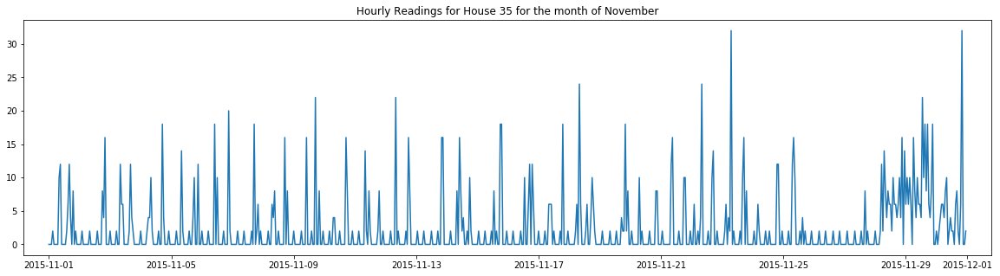

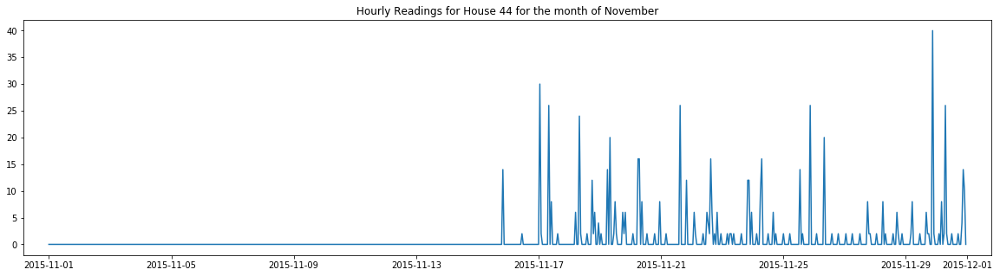

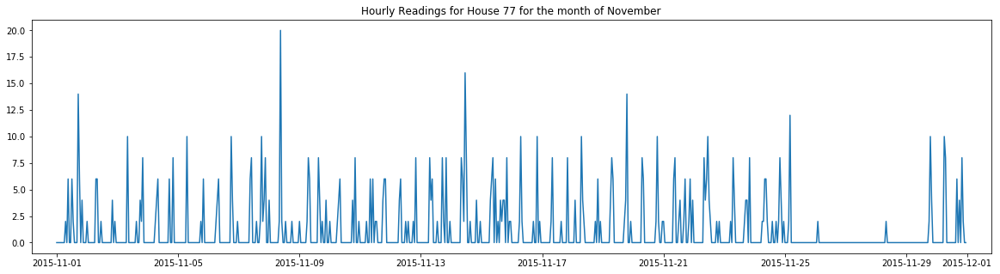

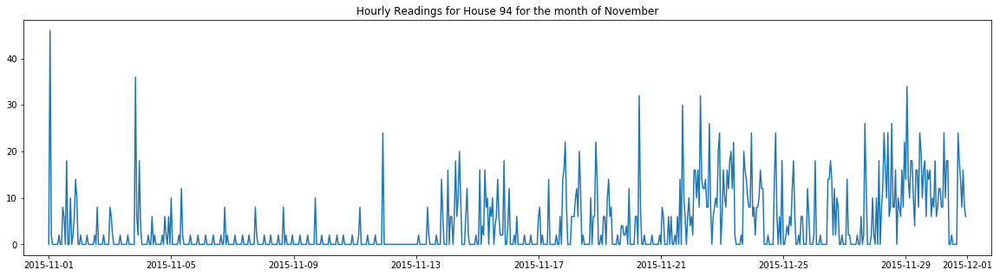

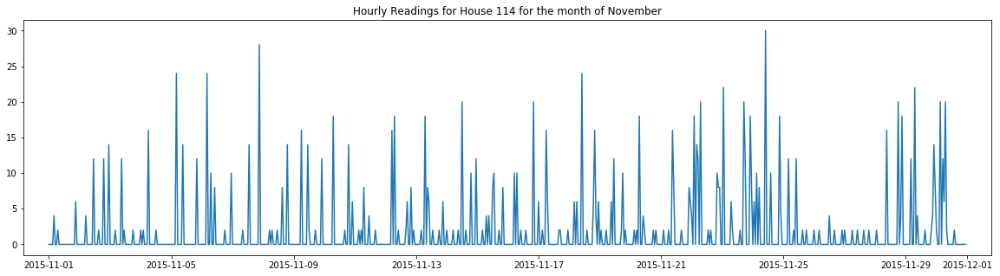

...

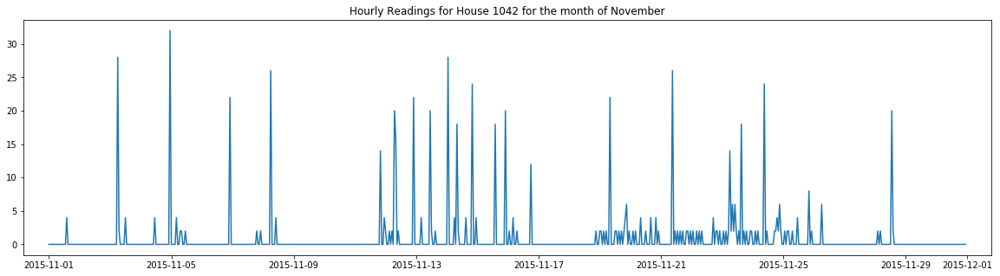

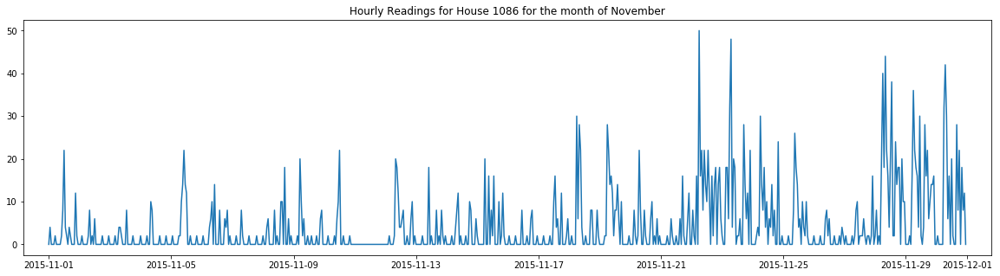

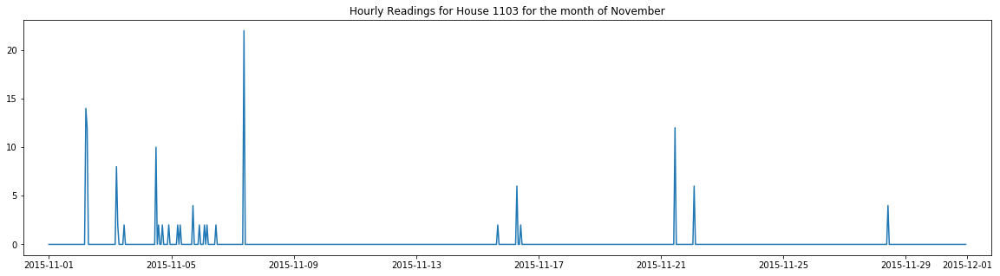

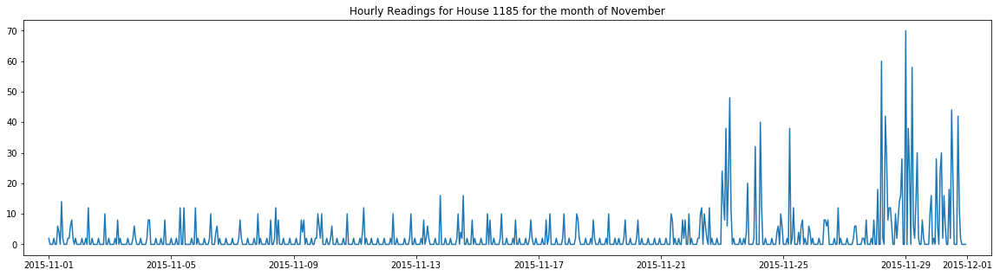

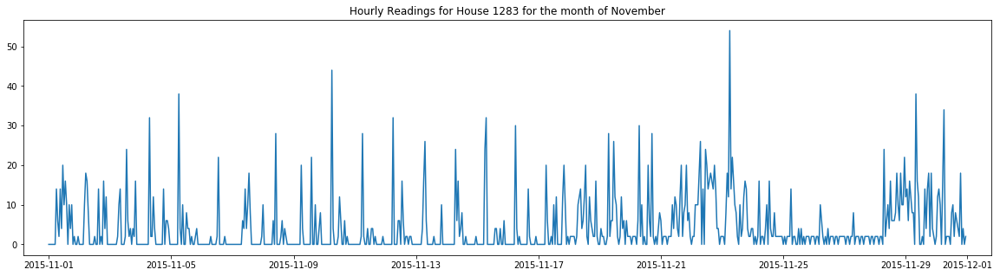

No data for house 1403 in month of November


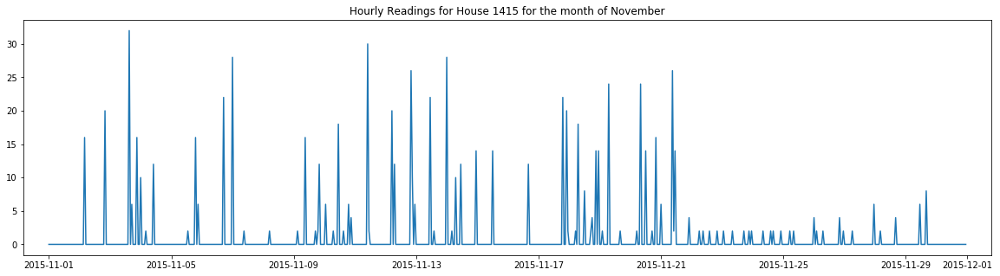

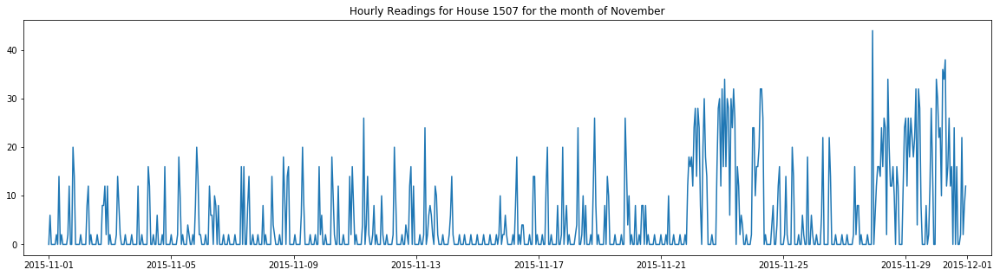

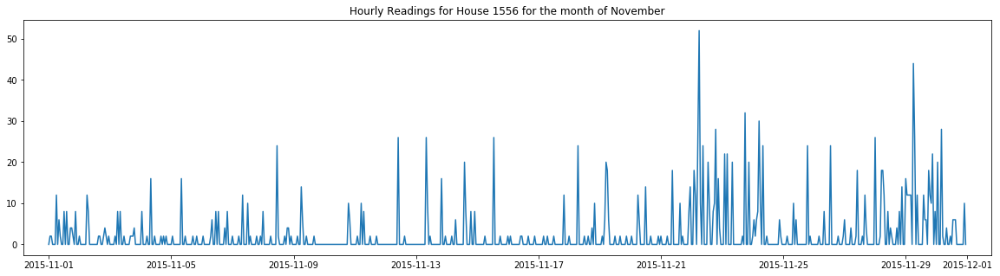

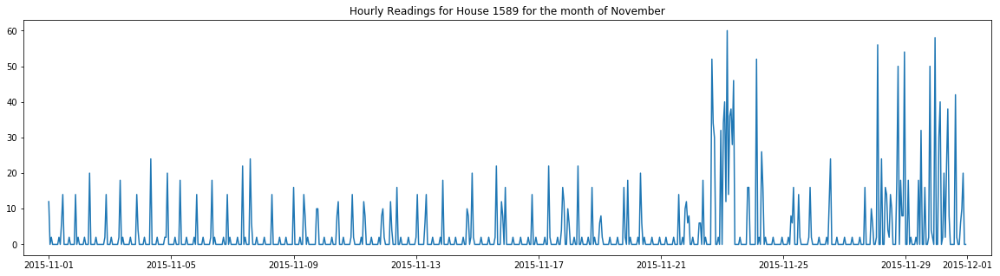

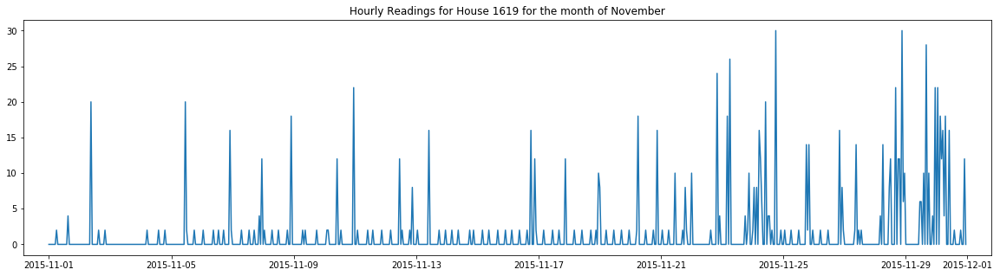

...

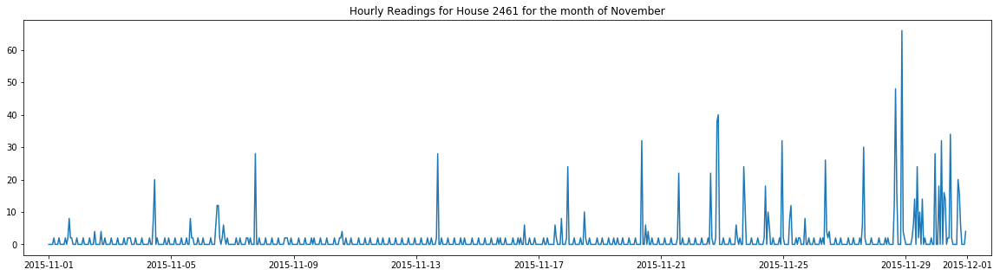

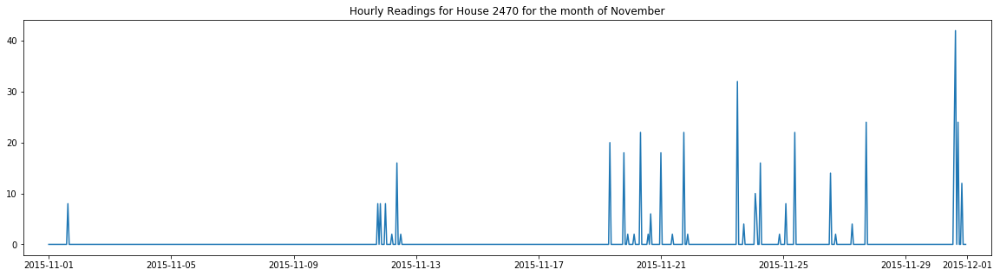

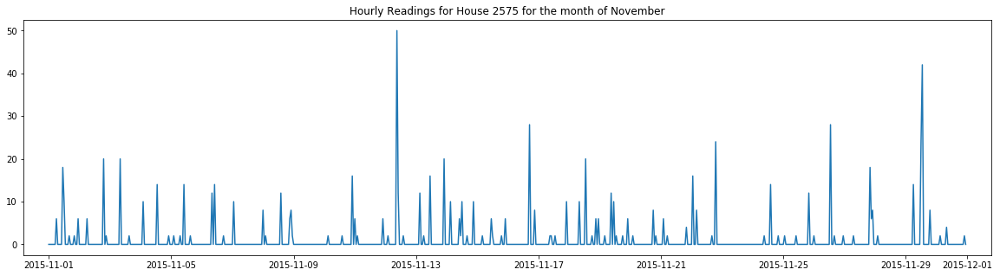

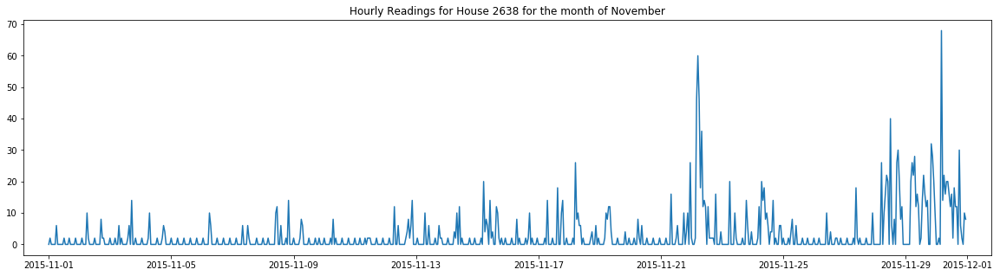

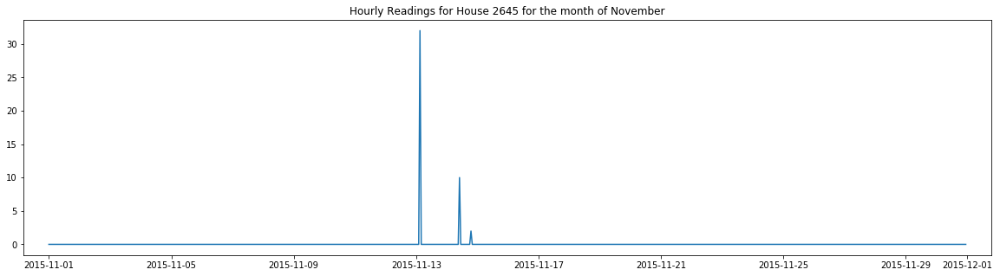

No data for house 2755 in month of November
No data for house 2814 in month of November


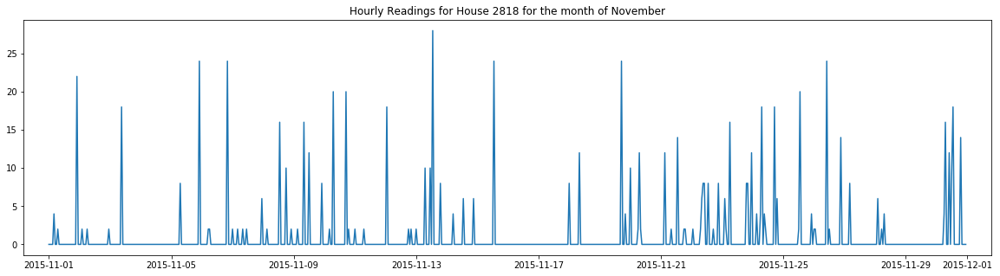

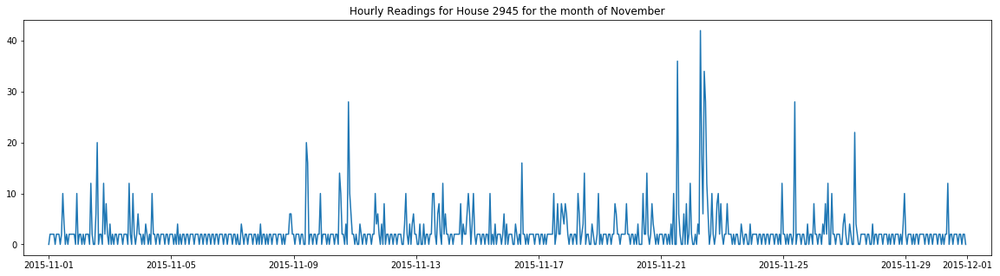

No data for house 2946 in month of November


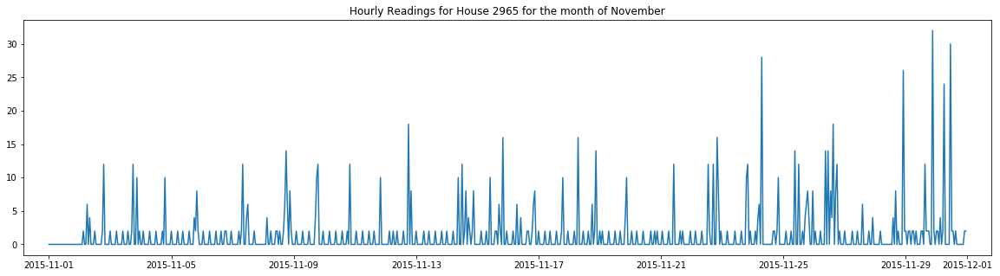

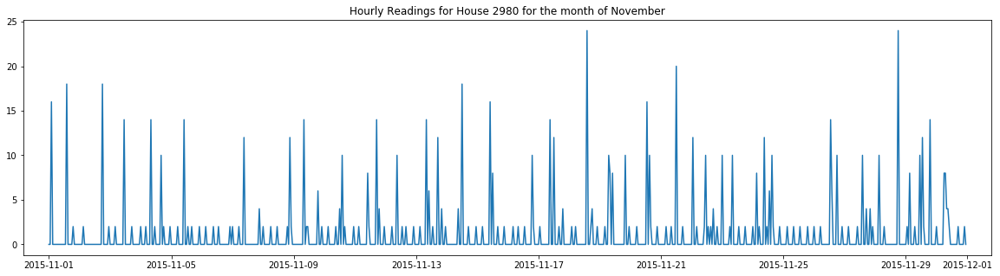

No data for house 3036 in month of November


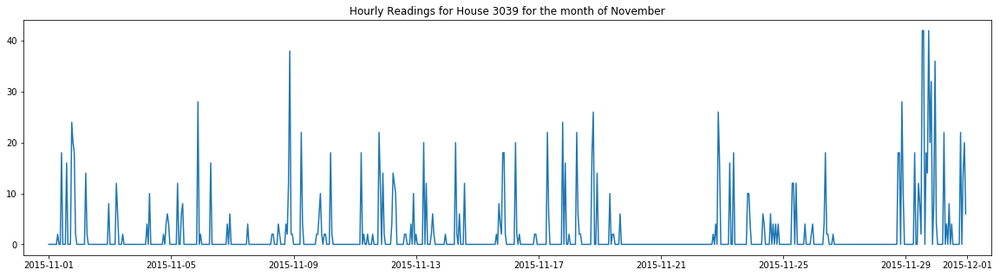

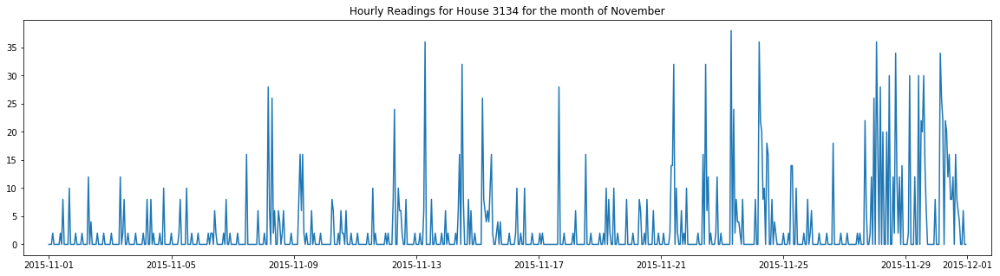

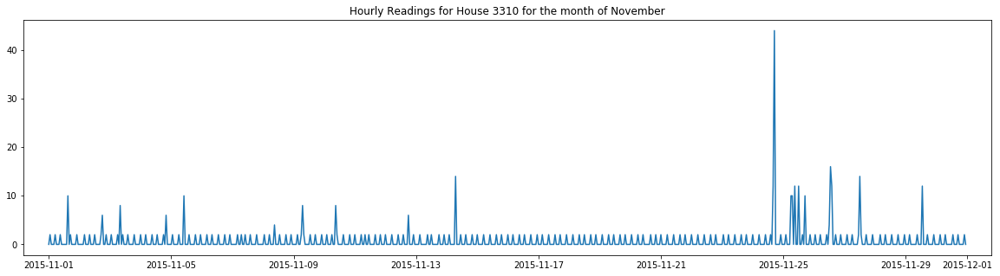

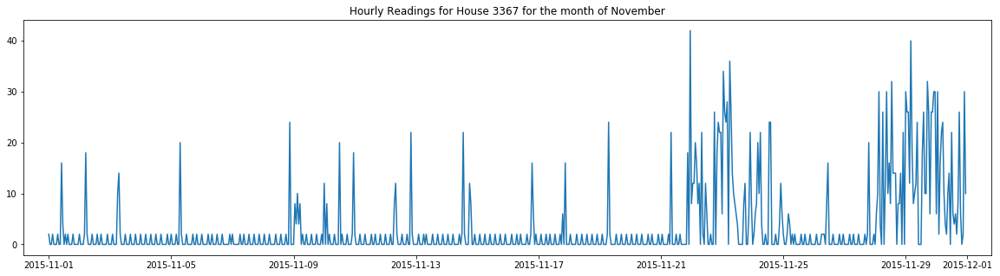

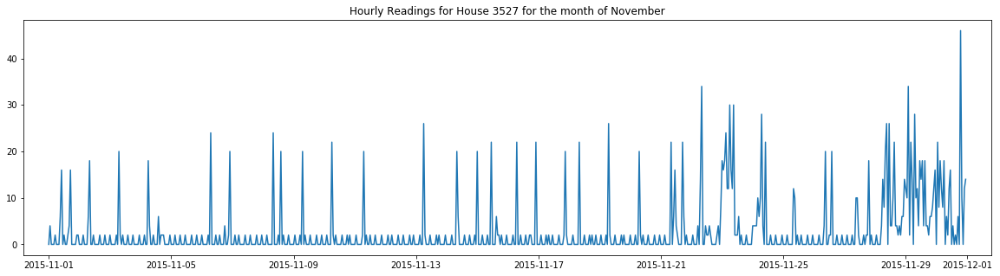

...

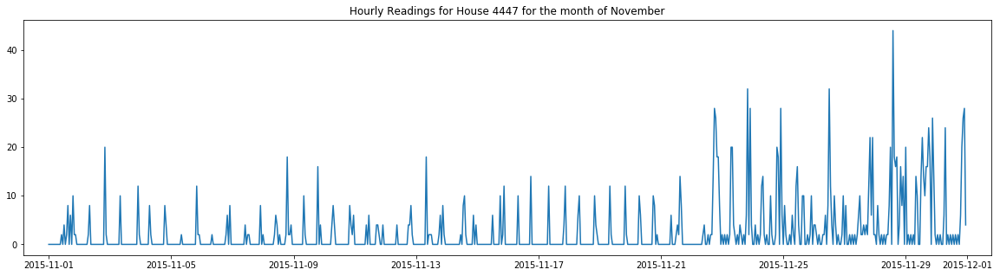

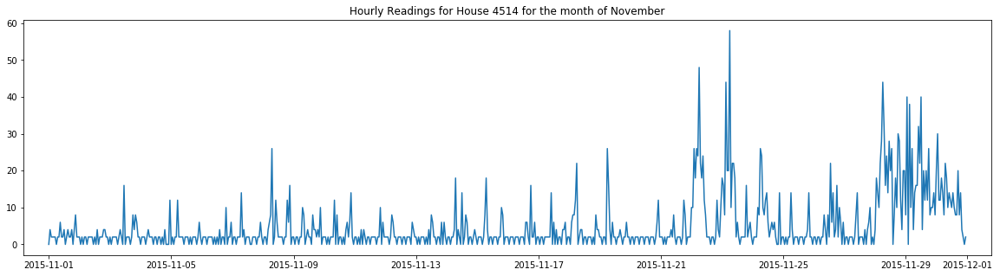

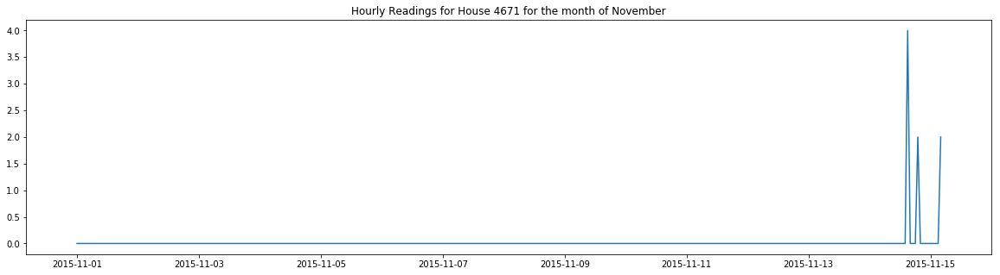

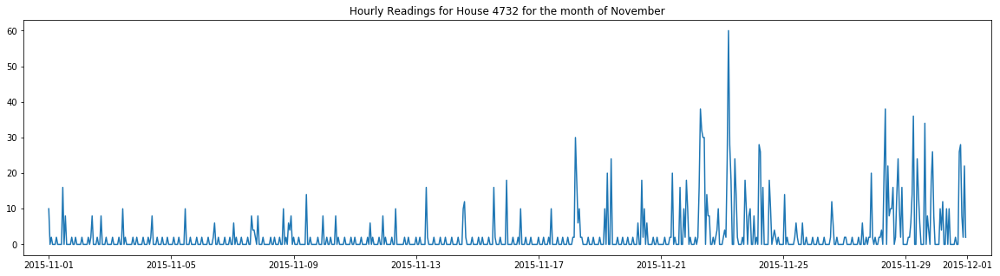

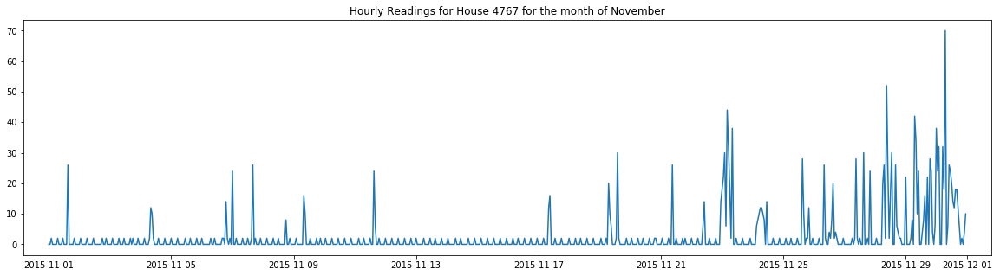

No data for house 4874 in month of November
Not enough data to create weekly data for house 4874.


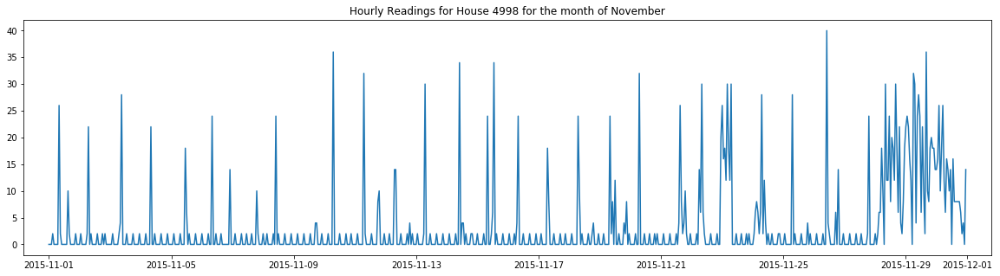

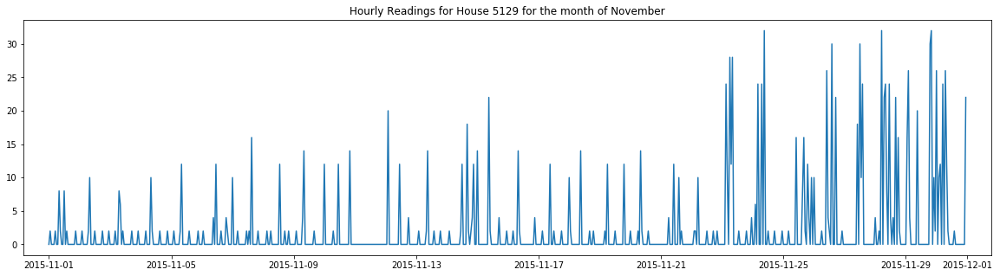

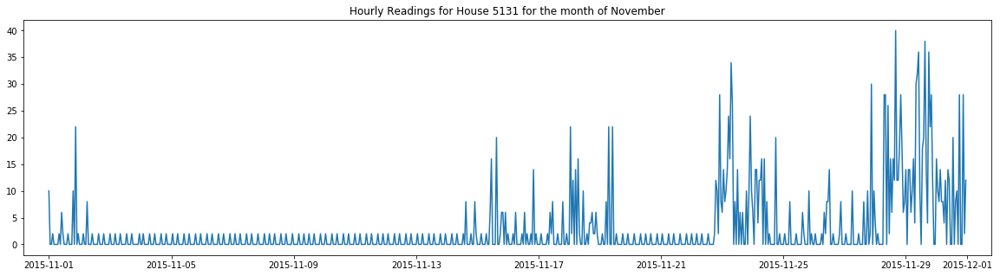

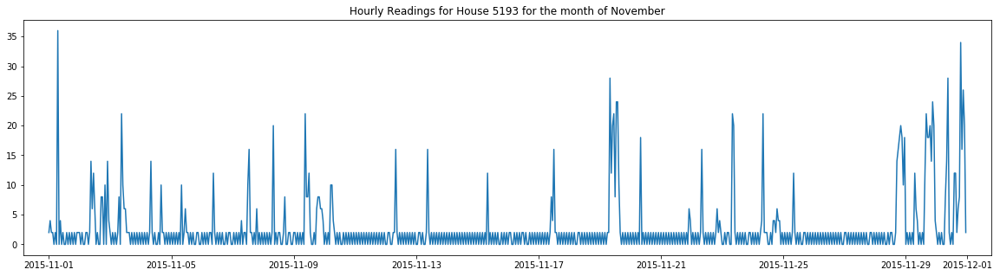

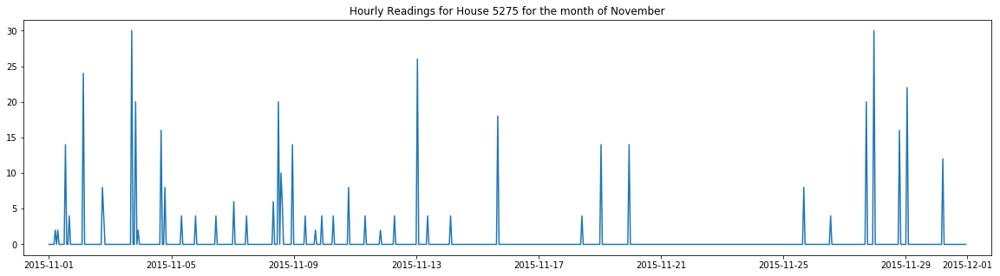

No data for house 5317 in month of November


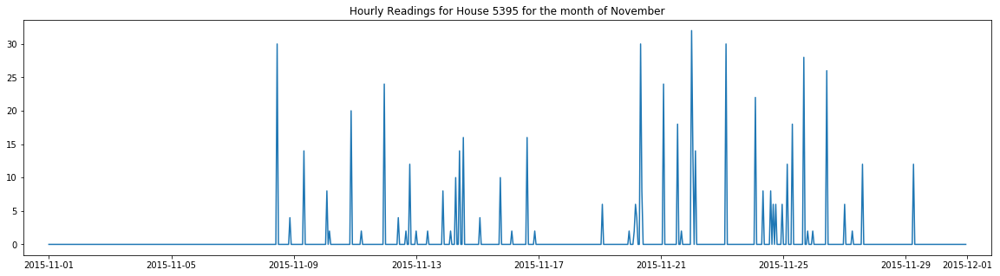

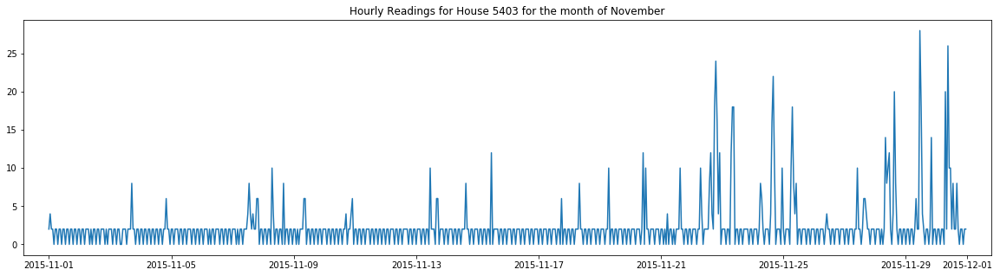

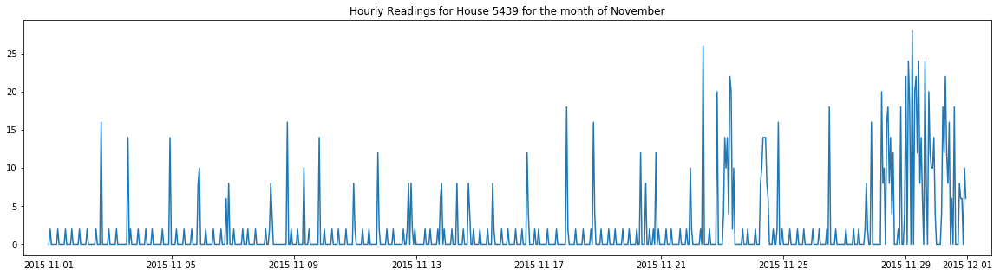

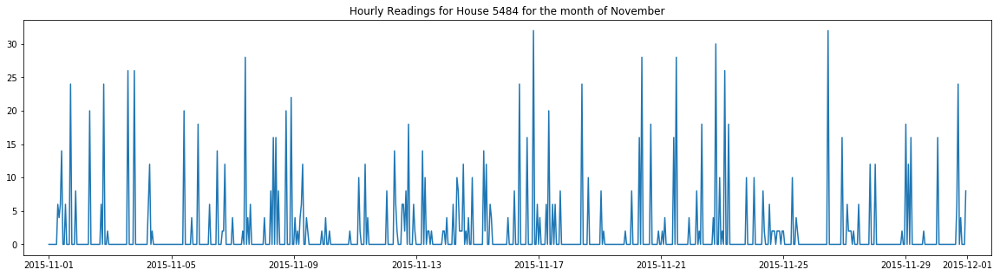

No data for house 5545 in month of November


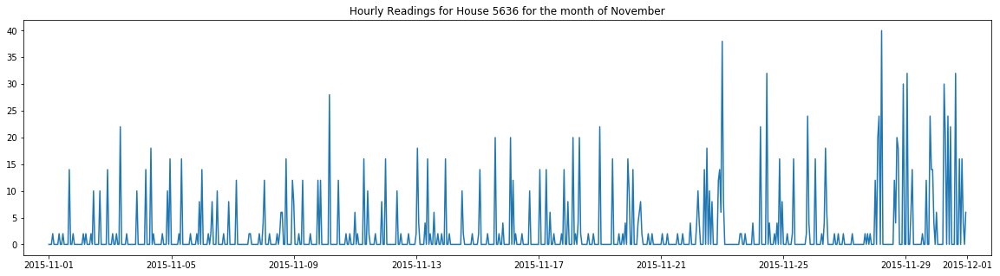

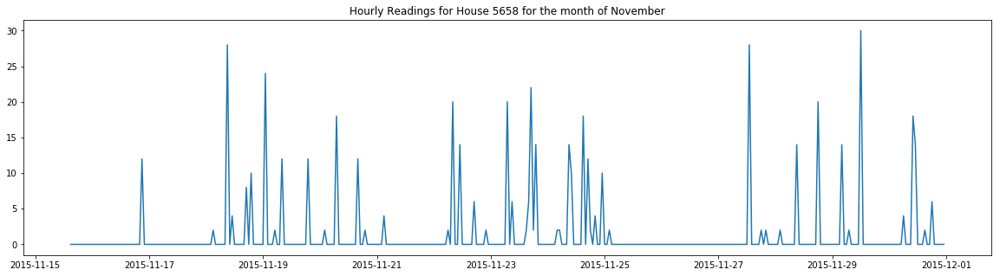

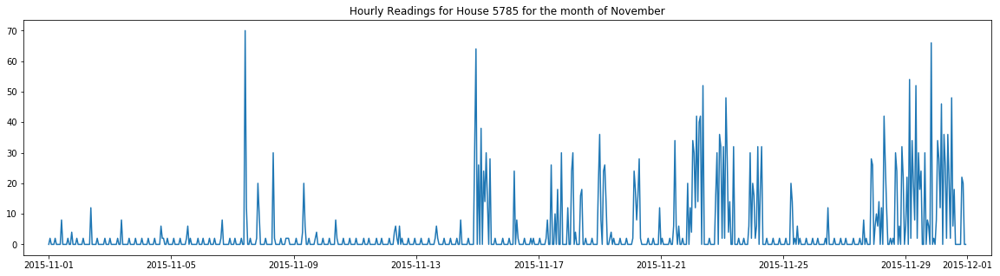

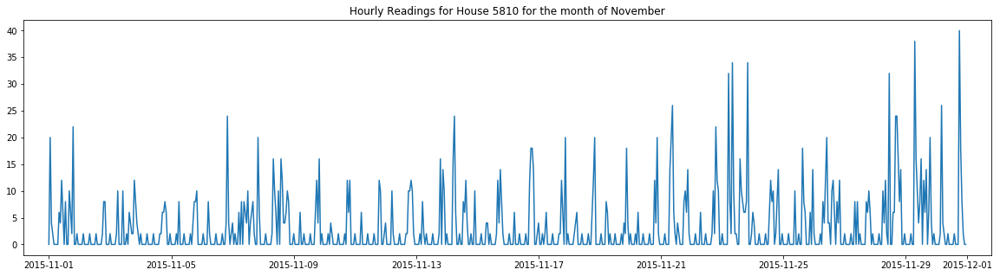

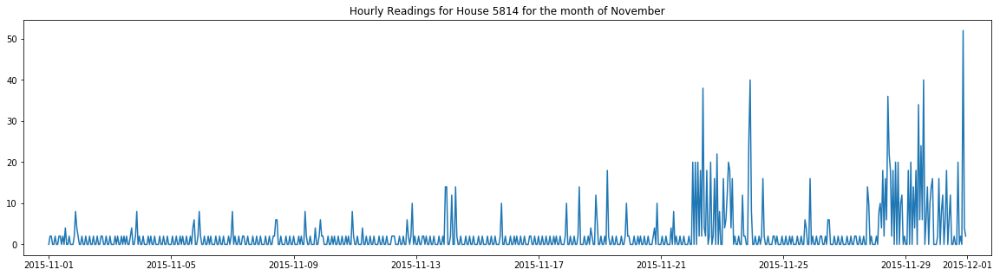

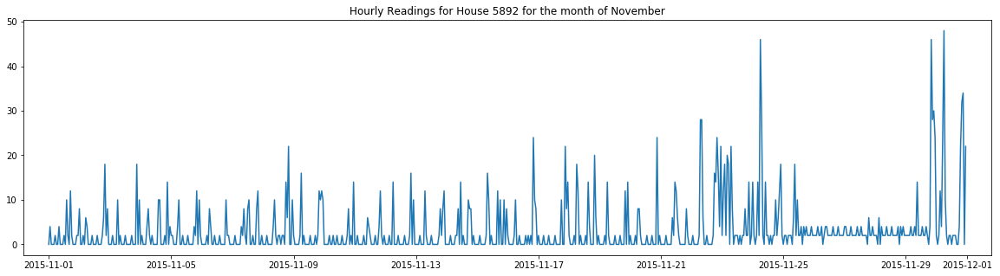

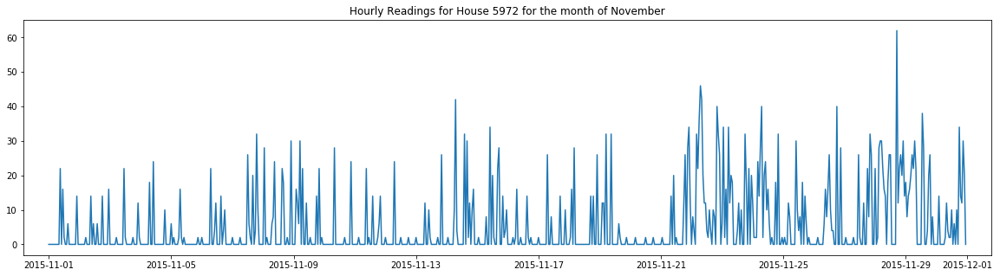

No data for house 6101 in month of November
Not enough data to create weekly data for house 6101.


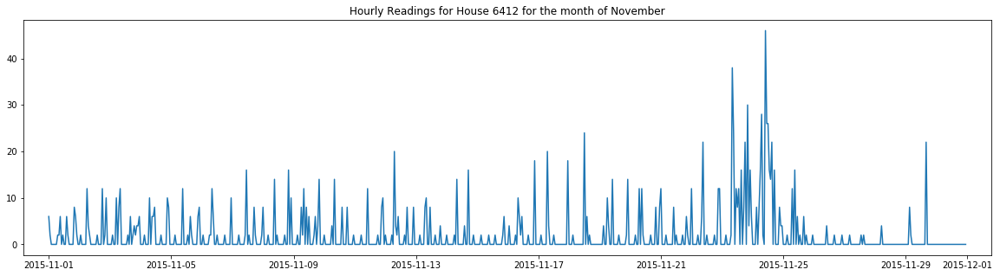

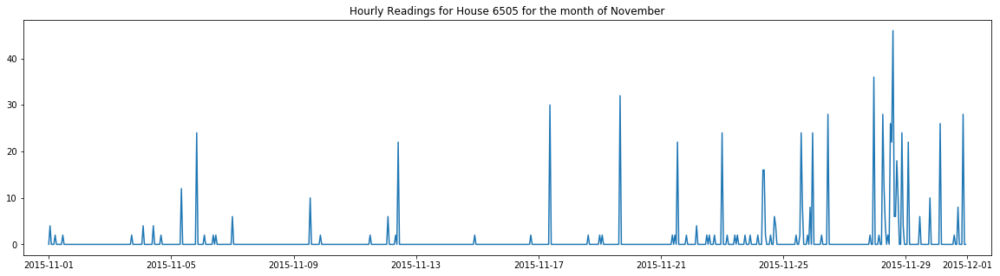

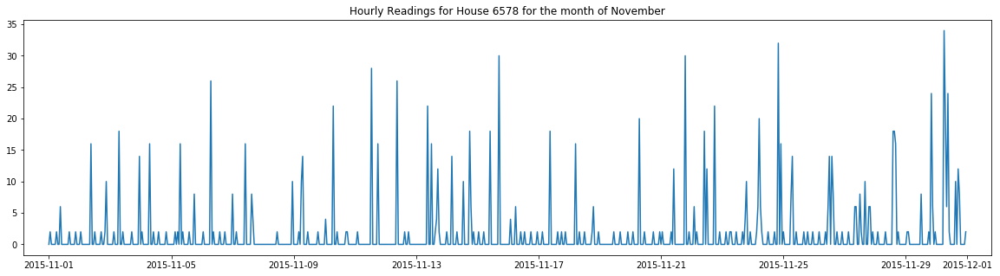

No data for house 6673 in month of November


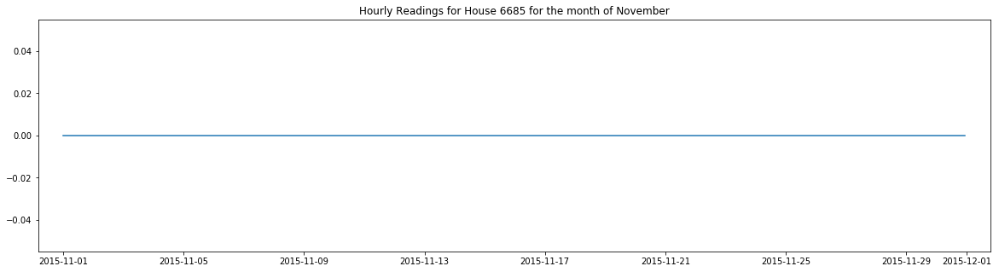

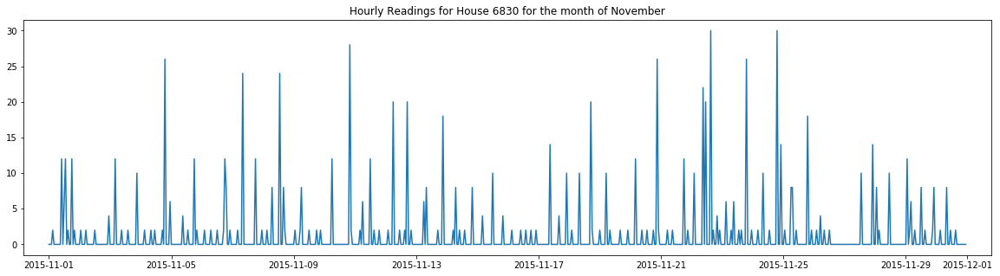

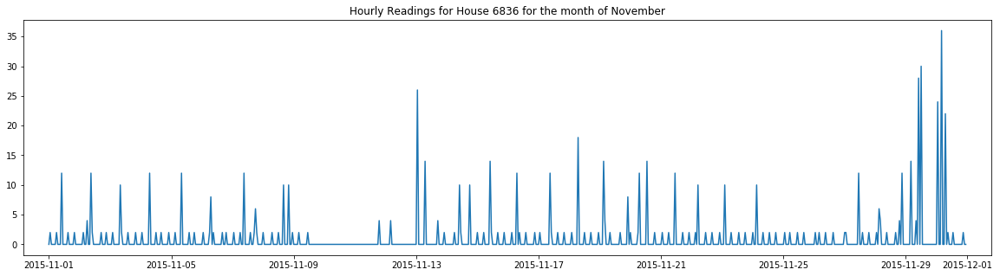

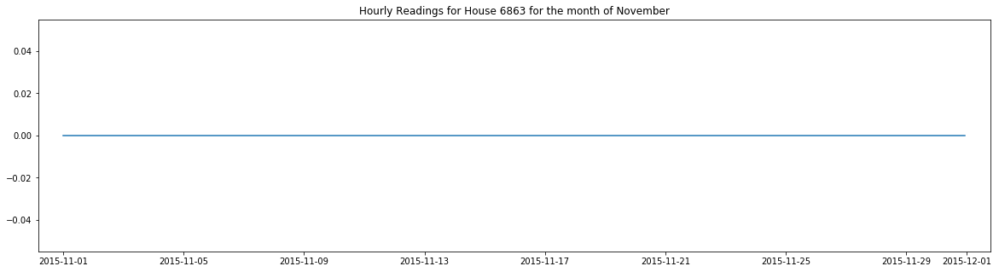

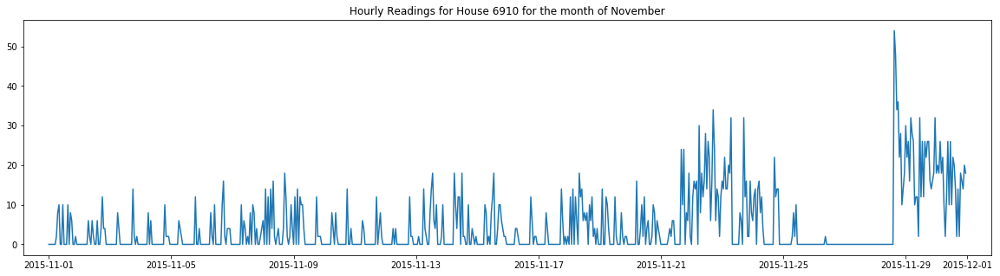

...

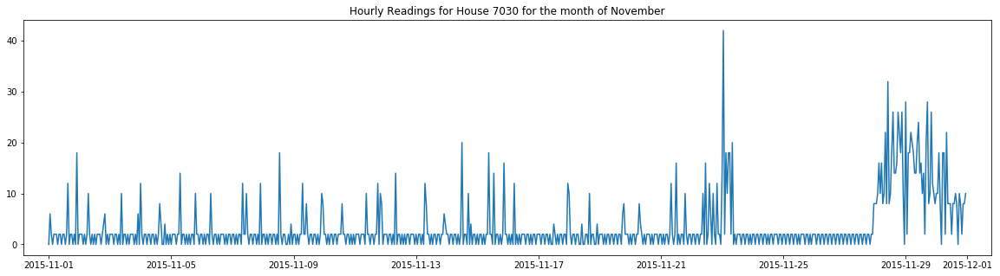

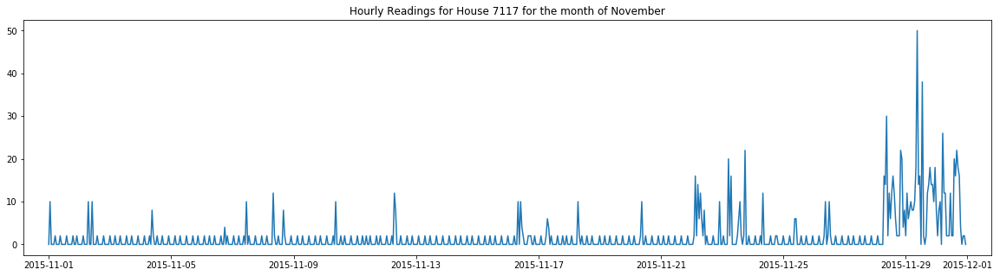

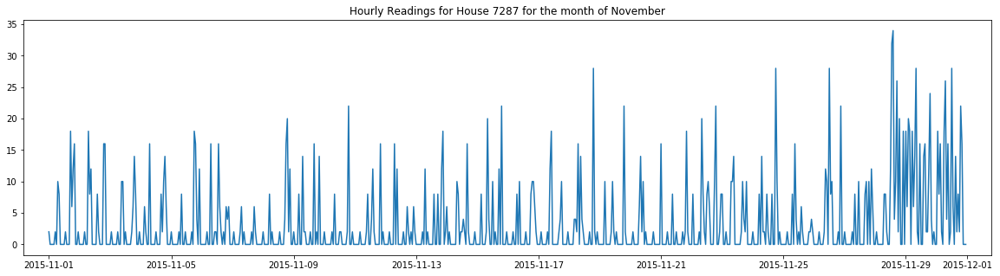

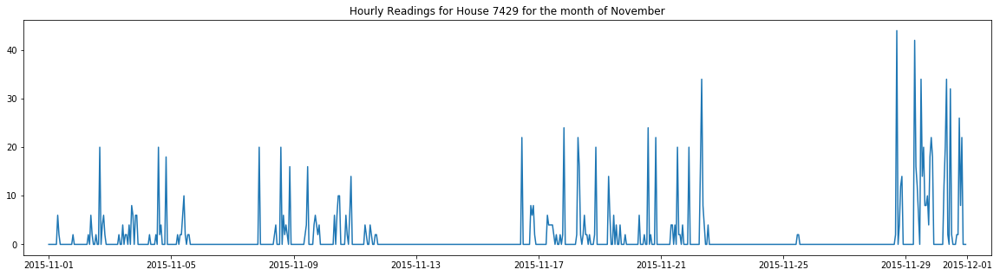

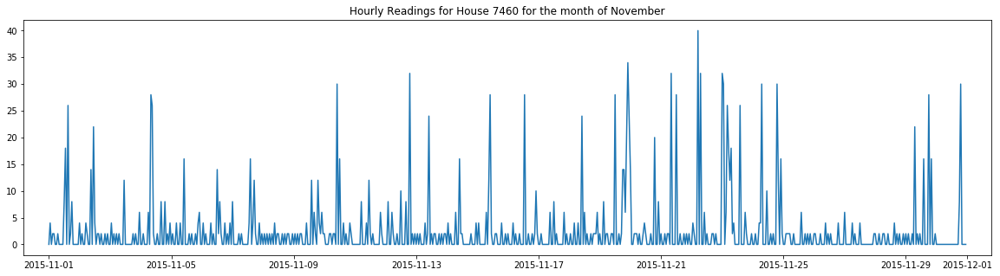

No data for house 7566 in month of November


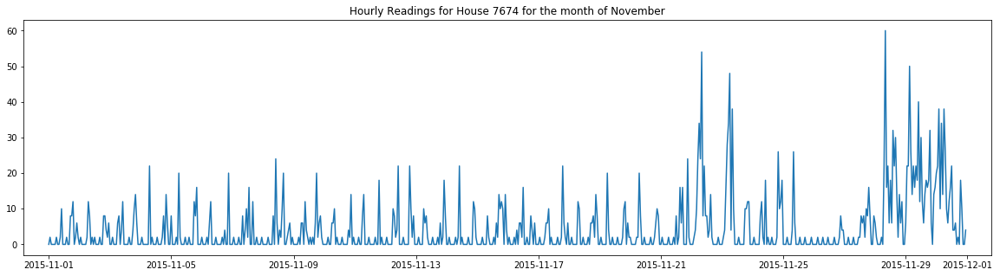

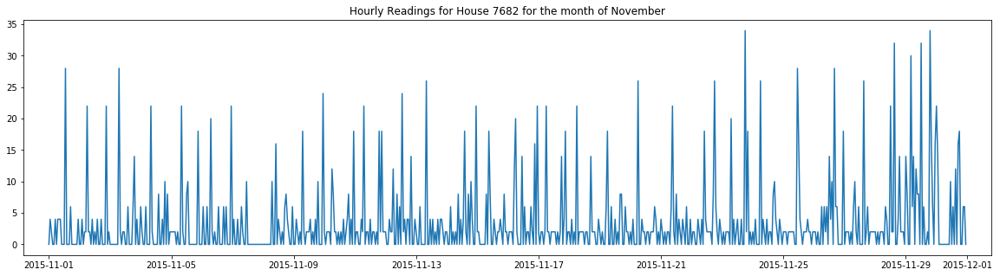

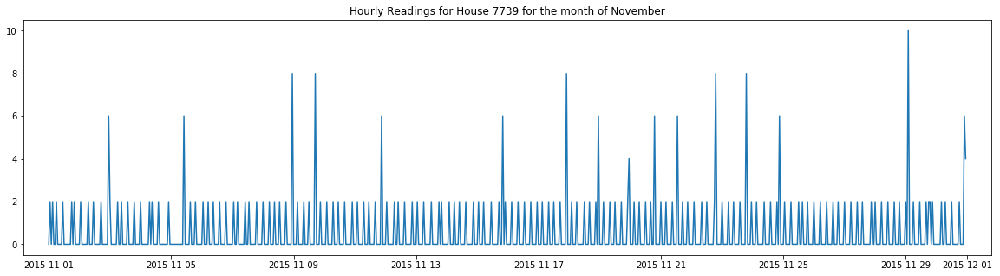

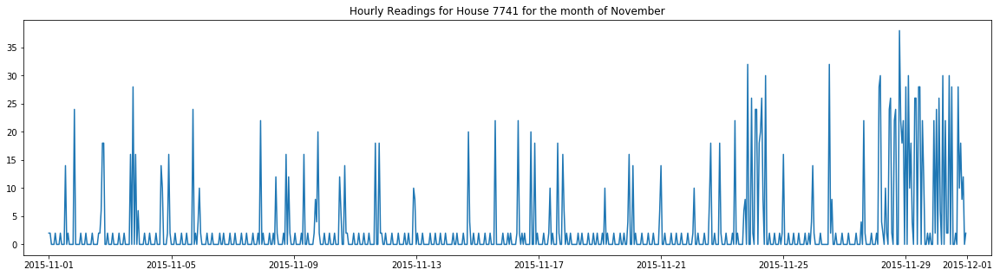

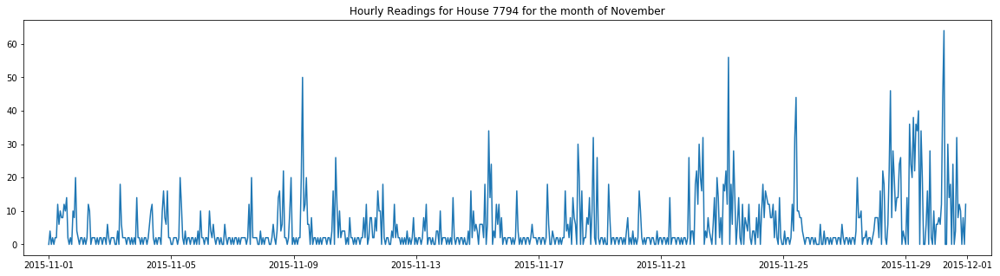

...

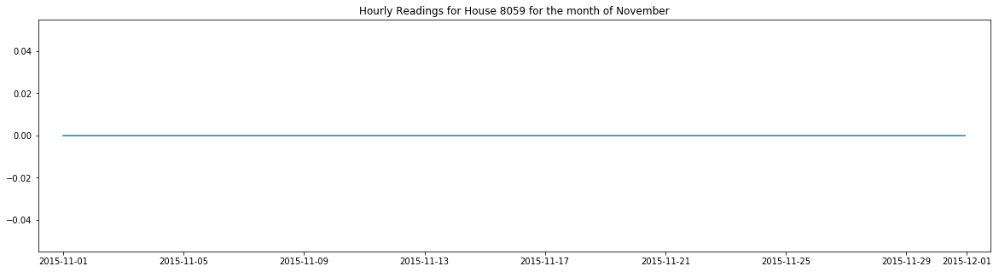

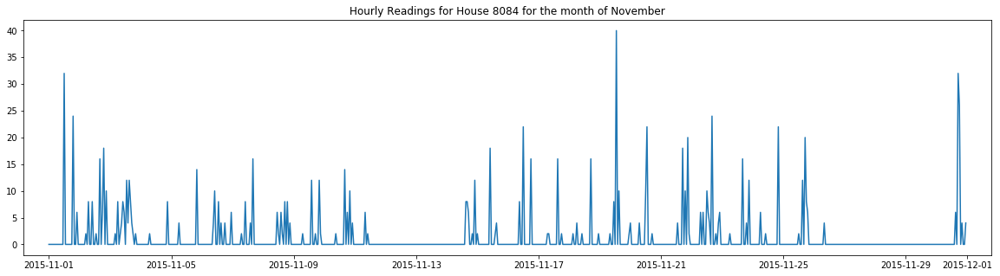

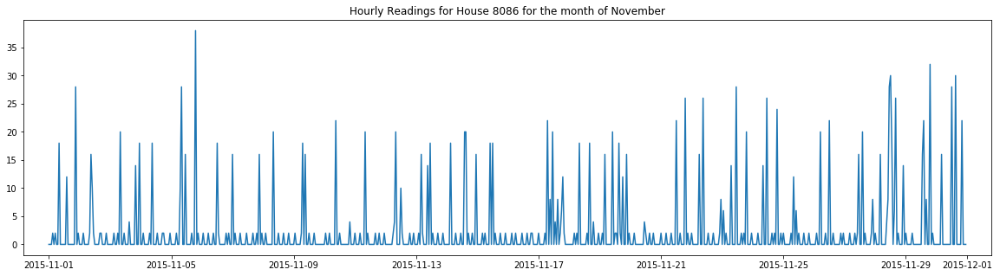

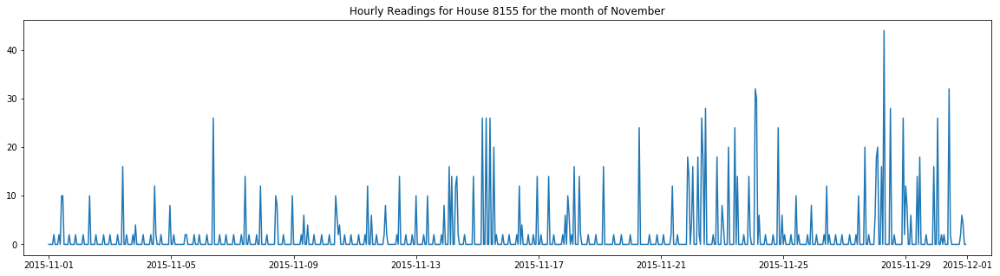

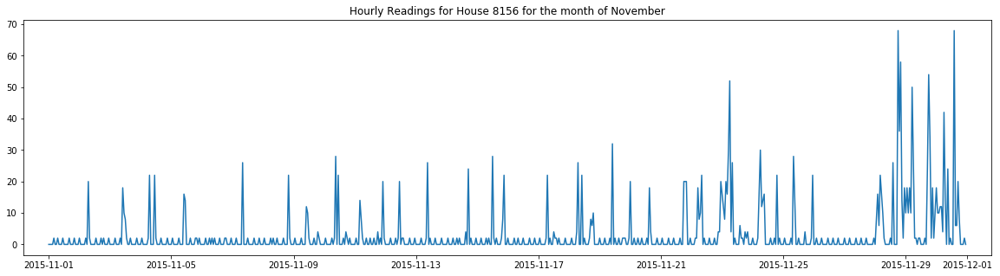

No data for house 8244 in month of November


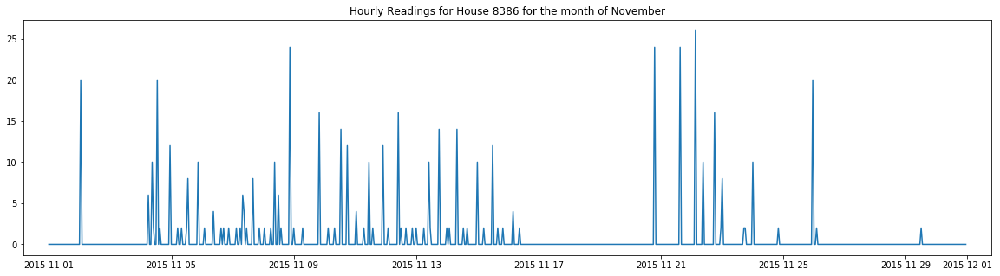

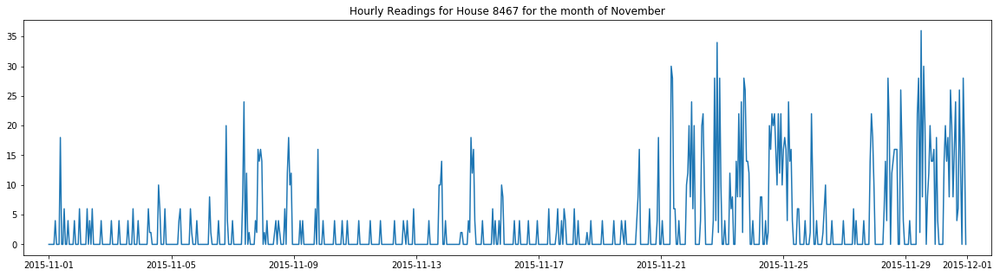

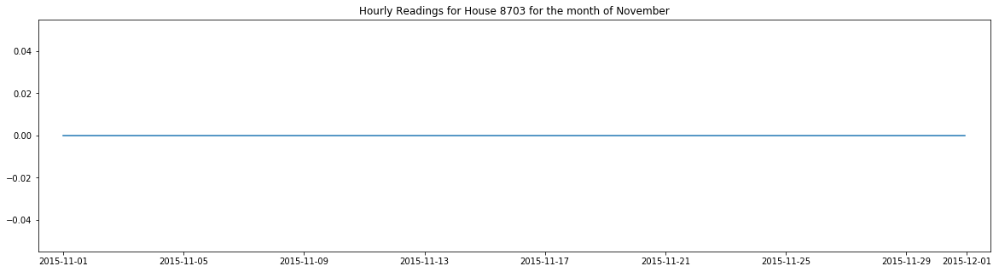

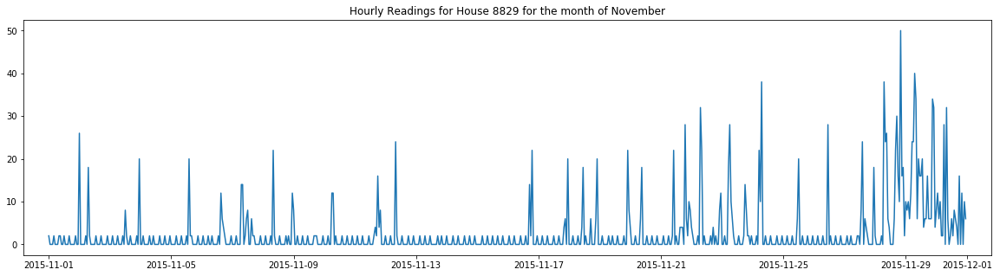

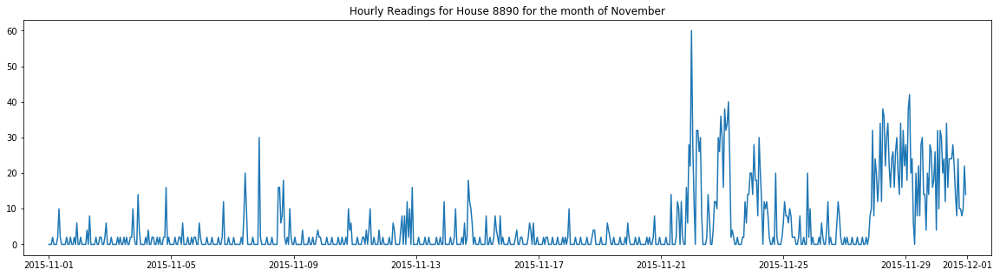

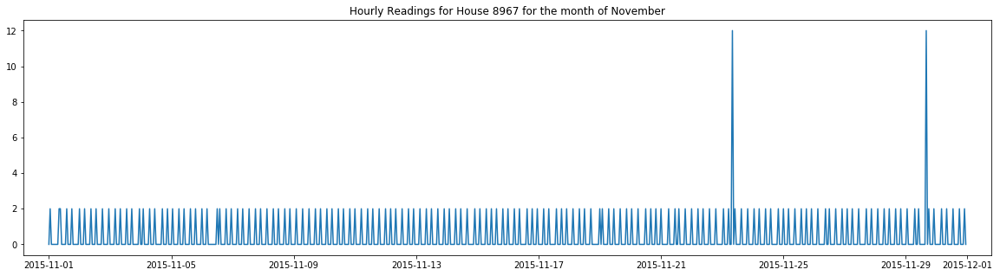

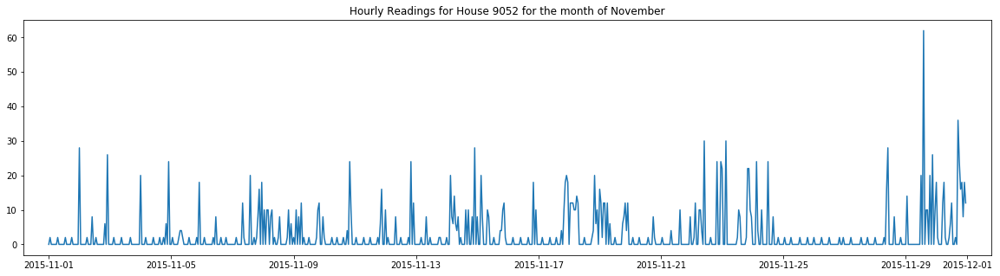

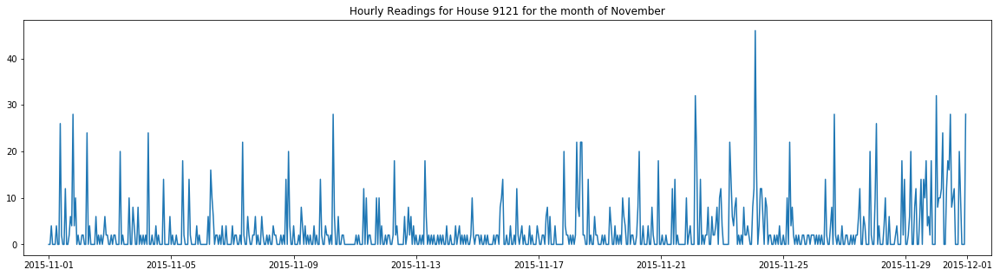

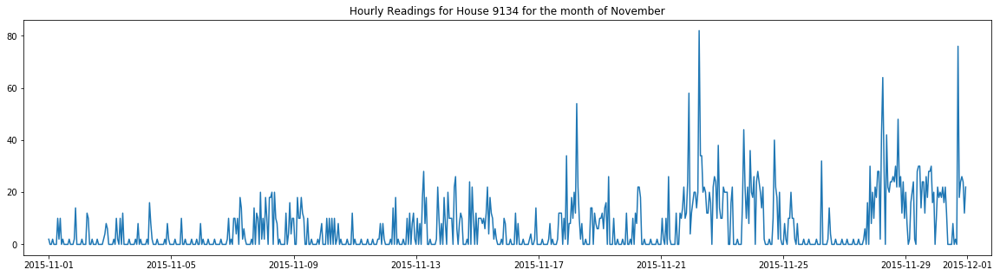

No data for house 9160 in month of November


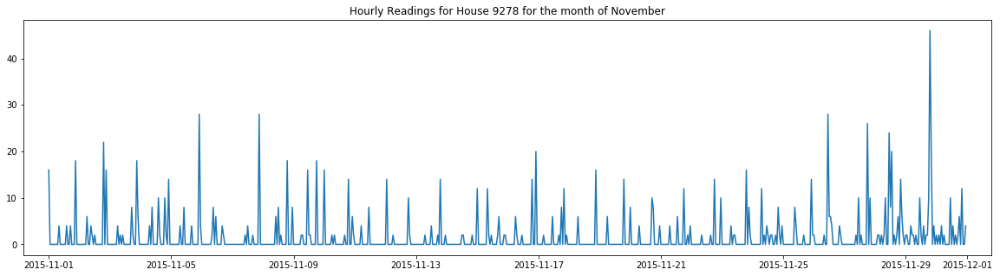

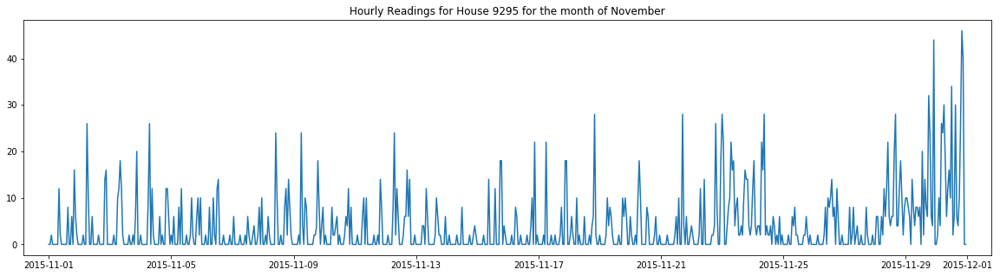

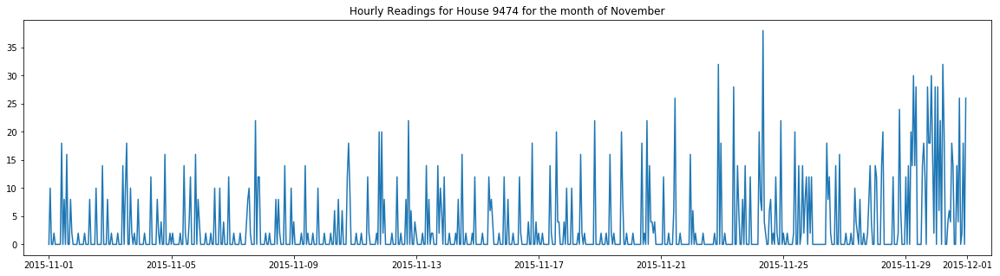

No data for house 9600 in month of November


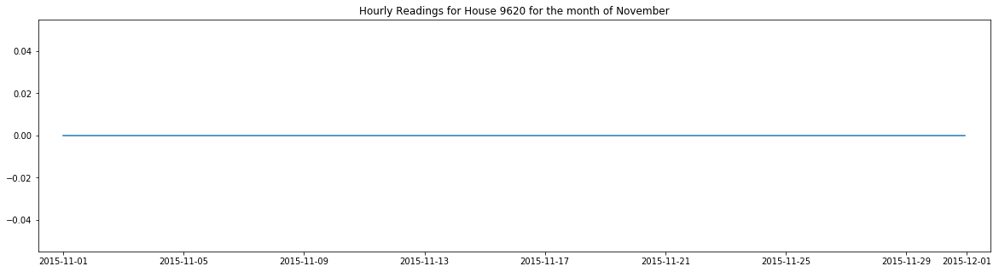

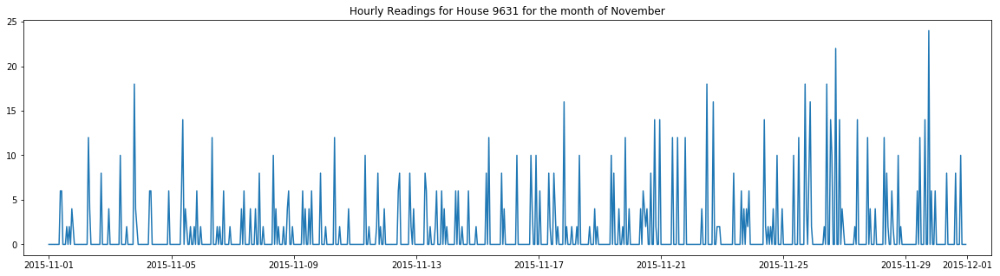

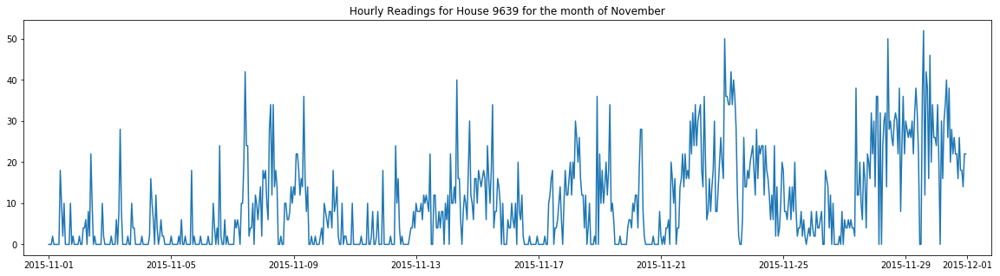

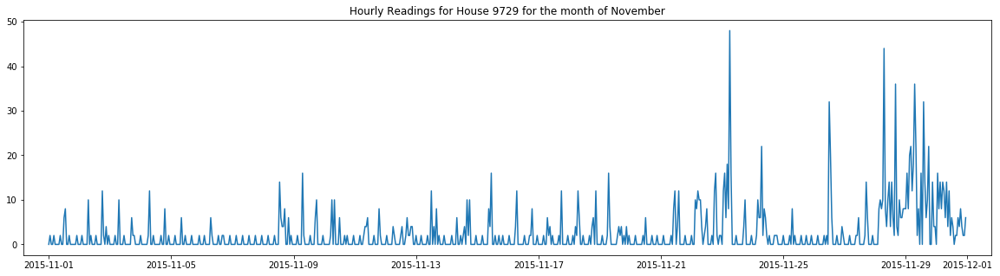

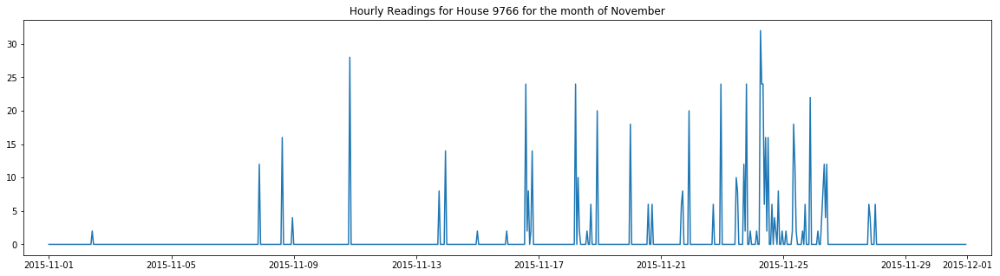

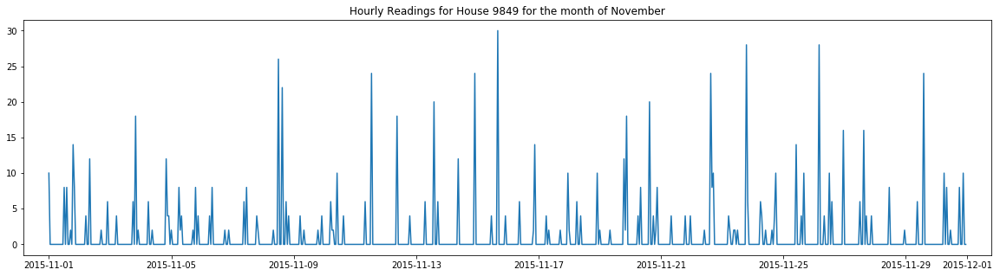

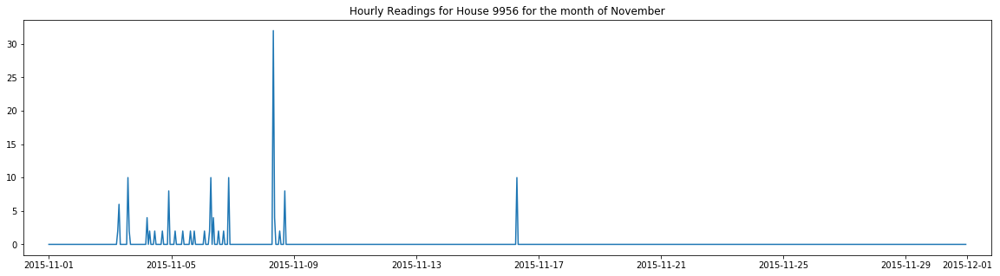

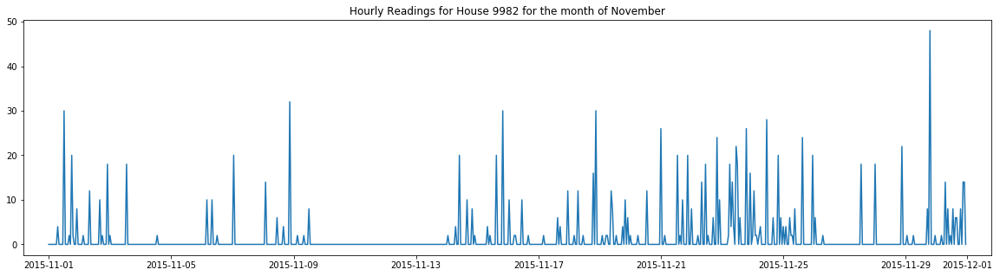

In [12]:
# Dictionary to store the differences per hour
df_grouped = df_without_errors.groupby('dataid')

dataframe_dict = {}
difference_dataframe = pd.DataFrame()
plotting_dataframe = pd.DataFrame()

for house in houses: 
  
    # Sort dataframe by dataid
    df_x = df_grouped.get_group(house)

    # Use timestamp as index
    local_minute = list(df_x.localminute)
    meter_value = list(df_x['meter_value'])
    dataid = list(df_x['dataid'])
    meter_diff = list(df_x['meter_diff'])
    index = local_minute
    # Create new dataframe 
    data = {'meter_value':meter_value,'dataid':dataid,'meter_diff':meter_diff}
    df_new = pd.DataFrame(data,index)

    # Resample the data such that it reports the increment per hour
    df_new_resampled = df_new.resample('H').mean()
    df_new_resampled.meter_diff = df_new.meter_diff.resample('H').sum()
    df_new_resampled.meter_value = df_new.meter_value.resample('H').last()

    # Fill in the missing values 
    missing_values = {'dataid': house,'meter_diff': 0}
    df_filled = df_new_resampled.fillna(value=missing_values)
    df_filled = df_filled.fillna(method = 'pad')

    # Generated the month,weekday,hour
    df_filled['month'] = df_filled.index.month
    df_filled['hour'] = df_filled.index.hour
    df_filled['weekday'] = df_filled.index.weekday
  
    # Plotting for the month 
    df_plot_month = df_filled.groupby('month')

    try:
        df_november = df_plot_month.get_group(11)
        title = "Hourly Readings for House " + str(house) + " for the month of November"
        plt.figure(figsize=(20,5))
        plt.plot(df_november.index, df_november['meter_diff'])
        plt.title(title)
        plt.xlim(df_november.index[0]-20,df_november.index[-1]+20)
        plt.show()
    except KeyError:
        print(f'No data for house {house} in month of November')
 
    df_grouped_wk_hour = df_filled.groupby(['weekday','hour'])

    dataid = []
    hourly_difference = []
    hour = []
    weekday = []
    # to create data with dataid, weekday, hour, hourly_difference 
    try:
        for i in range(0,7):
            for j in range(0,24):
                dataid.append(house)
                weekday.append(i)
                hour.append(j)
                hourly_difference.append(df_grouped_wk_hour.get_group((i,j)).meter_diff.mean())
     
        data = {'dataid':dataid,'weekday':weekday,'hour':hour,'hourly_diff':hourly_difference}
        final_df = pd.DataFrame(data)
        final_df = final_df.groupby(dataid)
        final_df = final_df.get_group(house)
        difference_dataframe[house] = hourly_difference
        
    except KeyError:
        print(f'Not enough data to create weekly data for house {house}.')

    



In [13]:
difference_dataframe.corr()

,35,44,77,94,114,187,222,252,370,483,...,9474,9600,9620,9631,9639,9729,9766,9849,9956,9982
35,1.000000,0.132666,0.651287,0.344779,0.400494,0.149094,0.145194,0.480921,0.183202,0.332335,...,0.403710,0.157104,0.094888,0.497558,0.137363,0.399736,0.461196,0.292786,0.206230,0.280716
44,0.132666,1.000000,0.326041,0.299465,0.253392,-0.063918,0.168560,0.210820,0.108601,0.158616,...,0.185047,-0.018145,-0.040690,0.346245,0.236200,0.270862,0.204055,0.213700,0.199809,0.173471
77,0.651287,0.326041,1.000000,0.418850,0.454023,0.096728,0.229203,0.442266,0.236715,0.285478,...,0.389168,0.096141,0.136396,0.539824,0.164617,0.350657,0.384446,0.463386,0.132129,0.363590
94,0.344779,0.299465,0.418850,1.000000,0.443573,0.085967,0.207230,0.449217,0.056197,0.337080,...,0.152393,0.203978,0.018861,0.349932,0.469839,0.498730,0.297281,0.182377,0.274693,0.216692
114,0.400494,0.253392,0.454023,0.443573,1.000000,-0.014881,0.273190,0.387582,0.109338,0.271799,...,0.240591,0.213793,-0.009587,0.342378,0.267599,0.511897,0.294203,0.274220,0.113274,0.310205
187,0.149094,-0.063918,0.096728,0.085967,-0.014881,1.000000,0.049792,0.051211,0.150453,0.069040,...,0.149613,-0.079932,-0.032660,0.050576,0.057807,0.001062,0.158504,0.071654,0.049939,0.232897
222,0.145194,0.168560,0.229203,0.207230,0.273190,0.049792,1.000000,0.188903,0.029575,0.137743,...,0.091429,0.070478,-0.091772,0.149644,0.299930,0.284857,0.036592,0.090430,0.048991,0.099366
252,0.480921,0.210820,0.442266,0.449217,0.387582,0.051211,0.188903,1.000000,-0.019485,0.394996,...,0.159476,0.218236,0.045492,0.327855,0.504768,0.702953,0.189067,0.233729,0.246708,0.189585
370,0.183202,0.108601,0.236715,0.056197,0.109338,0.150453,0.029575,-0.019485,1.000000,0.072769,...,0.249581,-0.044889,-0.012375,0.170286,-0.120692,-0.089412,0.107050,0.181227,0.034322,0.238936
483,0.332335,0.158616,0.285478,0.337080,0.271799,0.069040,0.137743,0.394996,0.072769,1.000000,...,-0.019159,0.143245,0.039578,0.227447,0.295506,0.516047,0.193208,0.106750,0.165319,0.084552


In [14]:
correlation = difference_dataframe.corr()
compare_house = {}
corr_value = {}
top_five = {} 
for z in houses: 
    top_five[z] = []
    compare_house[z] = []
    corr_value[z] = []
    for house in houses: 
        if house == z:
            pass
        else:
            try:
                compare_house[z].append(house)
                corr_value[z].append(correlation[z][house])
            except KeyError:
                pass

five_most_corr = {}
print("(House, Correlation)")
for house in houses: 
    try:
        five_most_corr[house] = []
        for i in range(0,5):
            x = max(corr_value[house])
            indexof = corr_value[house].index(x)
            five_most_corr[house].append((compare_house[house][indexof],x))
            corr_value[house].remove(x)
            compare_house[house].remove(compare_house[house][indexof])

        print(f'For House {house}:')
        print(five_most_corr[house])
    except KeyError:
        pass
    except ValueError:
        pass

(House, Correlation)
For House 35:
[(7030, 0.7415659051627376), (7919, 0.6961639416905341), (77, 0.6512869760492099), (1801, 0.6416089501258722), (1790, 0.604835946474959)]
For House 44:
[(5972, 0.48695854952033635), (4031, 0.4578441497133982), (7117, 0.43327632696365853), (1507, 0.4081867262044177), (1801, 0.4006495407128166)]
For House 77:
[(1718, 0.724145517468218), (7919, 0.6835028089445656), (7117, 0.6562242293613045), (35, 0.6512869760492099), (1801, 0.6500059058641483)]
For House 94:
[(739, 0.7027507607378625), (9052, 0.643636961529695), (7016, 0.5995447869371917), (8703, 0.5892356344968647), (2335, 0.5690114309571179)]
For House 114:
[(2129, 0.5200881350109003), (7919, 0.5167643685843882), (9631, 0.5118968118718437), (7460, 0.48223666627066225), (739, 0.47518062805723976)]
For House 187:
[(4029, 0.27722841750017846), (9849, 0.2328972267828811), (1697, 0.22551516952679346), (1790, 0.2004335716874607), (7017, 0.1911985058125479)]
For House 222:
[(1507, 0.4089684486122572), (7017,

In [15]:
def plot_two_houses(dataframe,house1,house2):
  # Plotting two weekday plots together 
    labels = ["Mon","Tue","Wed","Thu","Fri","Sat","Sun"]
    y = dataframe[house1]
    x = list(range(0,168))
    plt.figure(figsize = (20,5))
    plt.plot(x,y,label = 'House '+str(house1))
    plt.xticks(np.arange(min(x), max(x)+1, 24.0),labels)
    y = dataframe[house2]
    plt.plot(x,y,label = 'House '+str(house2))
    plt.legend()

**Good Example: Correlation Coefficient of 0.8038709844101316**

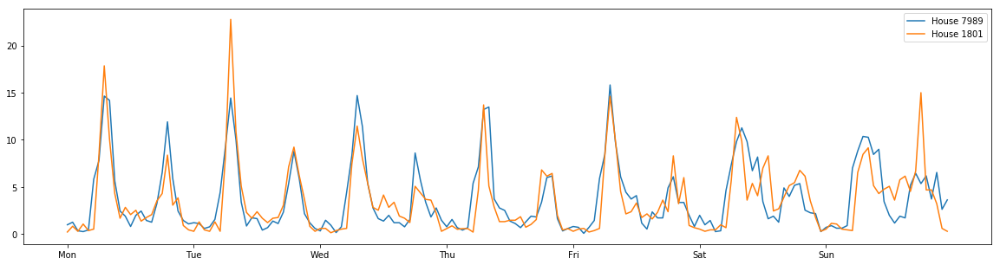

In [16]:
plot_two_houses(dataframe=difference_dataframe,house1=7989,house2 =1801)

**Bad Example: Correlation coefficient of 0.132666**

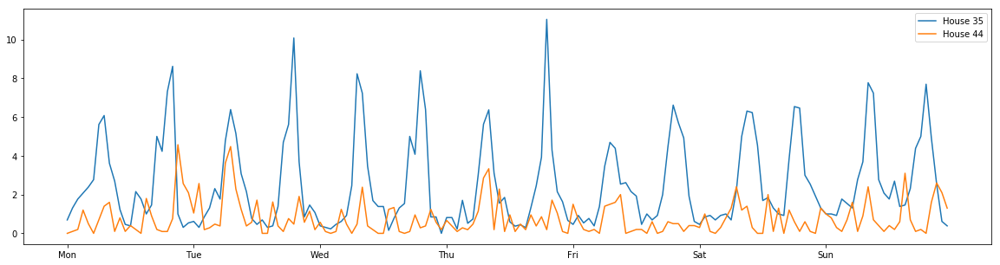

In [17]:
plot_two_houses(dataframe=difference_dataframe,house1=35,house2 =44)

**1.4. Student Proposal**

---



**Background:**

Transactions between power plants and natural gas suppliers generally include a supply component, which involves an agreement with a fuel producer or marketer to supply the commodity, and a delivery component, which involves an agreement with a pipeline operator to transport the fuel from the producer to the generator. For any transaction, one or both of these components can be firm or interruptible. Firm contracts are most prevalent in the West and South regions of the United States, including Texas. 

Firm contracts provide power plant operators with an agreed-upon capacity for the producer or pipeline to supply natural gas, establishing a high priority for fuel requested by the power plant. The supply or delivery of natural gas cannot be curtailed under a firm contract except under unforeseeable circumstances. Based on this, it is critical that power plants predict the correct amount of gas that is slated to be consumed. If the predictions are less than the actual consumed gas, there will be a shortfall of gas, which could potentially cause significant disruption for consumers. If the predictions are siginificantly higher that the actual consumed gas, there will be an excess of gas that will need to either be stored or disposed off - both of which are expensive and not desired.


**Proposal:**

We plan to incorporate Long-Short-Term-Memory (LSTM) to generate the future predictions for the gas consumptions. The benefit of using LSTM instead of the conventional Recurrent Neural Networks (RNN) is that unlike RNN, LSTM will not face a vanishing gradient problem and efficiently deal with long-range dependencies and optimise the accuracy with additional hidden layers. 

We plan to develop the LSTM model based on the first 2 months of data and upon development of the LSTM model, we plan to test out the accuracy of the model by comparing it with data from December 15 to March 16. By comparing with the real world generated data in the following 4 months from the training dataset, we can get an wholesome understanding of the overall accuracy of our forecasting model.


### 2. Forecasting



---
2.1 Explain why you may want to forecast the gas consumption in the future? Who would fiind this information valuable? What can you do if you have a good forecasting model?


---




**Explain why you may want to forecast the gas consumption in the future?**

Forecasting the gas consumption in the future will give us deeper insight into the demand of natural gas in a certain community, it will benefit the gas company in one of the following ways:

I.	It could help the gas company to better understand the needs of their customers, enabling it to provide a better service to their customers. Also, by doing so, it is able to understand the trends and usage patterns of the customers, thus allowing them to control the supply of gas to these houses, reducing the amount of wastage in the process. 

II.	The forecast allows the gas company to make early arrangements for gas procurement, transfer and storage beforehand.

III. The gas company can identify malfunctioning gas meters and rectify them earlier.


All these would help the gas company save costs on numerous ends, such as storage, procurement and wastage. 


**Who would find this information valuable?**

Firstly, the gas company is the party that is most interested in the forecast, as explained in the previous section, knowing the forecast not only improves their services, also prevent unnecessary cost in the future;

Secondly, the government should also find the information valuable. Because of globalization, countries tend to purchase natural gas and other fossil fuels from other countries who have enormous amount of storage at lower price. Getting to know the forecast of gas consumption of local communities give government an advantage on stipulating for plan for gas procurement; 

Thirdly, the customers themselves may also find the information valuable. This forecast information would help the local household to make better decisions on the gas consumption of the year ahead. 

**What can you do if you have a good forecasting model?**

A good forecasting model would allow users to make predictive informed estimates in determining the outlook of future trends. 

In this case, a good forecasting model would allow the gas companies to predict the amount of gas required by their customers and thus save costs through optimizing the supply of gas. 

Good forecasting models are also utilized other areas such as stock price forecasting. Stock analysts utilize numerous forecasting methods to determine the movement of the stock's price in the future. 


In [18]:
# Process the data to combine the datasets
# Dictionary to store the differences per hour
df_grouped = df_without_errors.groupby('dataid')

# Use the following dictionary to access the processed dataframes.
# dict_dataframes[35] to access the dataframe of house 35

dict_dataframes = {}
df_complete = pd.DataFrame()

for house in houses: 
  
    # Sort dataframe by dataid
    df_x = df_grouped.get_group(house)
    # Use timestamp as index
    local_minute = list(df_x.localminute)
    meter_value = list(df_x['meter_value'])
    dataid = list(df_x['dataid'])
    meter_diff = list(df_x['meter_diff'])
    index = local_minute
    # Create new dataframe 
    data = {'meter_value':meter_value,'dataid':dataid,'meter_diff':meter_diff}
    df_new = pd.DataFrame(data,index)

    # Resample the data such that it reports the increment per hour
    df_new_resampled = df_new.resample('H').mean()
    df_new_resampled.meter_diff = df_new.meter_diff.resample('H').sum()
    df_new_resampled.meter_value = df_new.meter_value.resample('H').last()

    # Fill in the missing values 
    missing_values = {'dataid': house,'meter_diff': 0}
    df_filled = df_new_resampled.fillna(value=missing_values)
    df_filled = df_filled.fillna(method = 'pad')

    # Generated the month,weekday,hour
    df_filled['month'] = df_filled.index.month
    df_filled['hour'] = df_filled.index.hour
    df_filled['weekday'] = df_filled.index.weekday
    
    df_complete = pd.concat([df_complete,df_filled])
    dict_dataframes[house] = df_filled.copy()
    
print(df_complete.head(5))    
  
print('Creation of dataframe done!')  

                     meter_value  dataid  meter_diff  month  hour  weekday
2015-10-01 00:00:00      93470.0    35.0           0     10     0        3
2015-10-01 01:00:00      93470.0    35.0           0     10     1        3
2015-10-01 02:00:00      93470.0    35.0           0     10     2        3
2015-10-01 03:00:00      93470.0    35.0           0     10     3        3
2015-10-01 04:00:00      93470.0    35.0           0     10     4        3
Creation of dataframe done!


In [19]:
# Group by hourly 
df_grouped_complete = df_complete.groupby(df_complete.index)


timestamp_index = dict_dataframes[35].index.values

meter_usage = []
number_of_houses = []
averaged = []
for i in timestamp_index:
    df_group = df_grouped_complete.get_group(i).copy()
    meter_usage.append(sum(df_group.meter_diff.values))
    number_of_houses.append(len(df_group))
    averaged.append((sum(df_group.meter_diff.values)/len(df_group)))

# Altogether now 
df_altogether = pd.DataFrame(index = timestamp_index, data = {'meter_usage':meter_usage, 'num_houses':number_of_houses, 'averaged':averaged})

cumulative_sum_list = []
cumulative_sum = 0
for x in df_altogether.averaged.values:
    cumulative_sum += x
    cumulative_sum_list.append(cumulative_sum)

## shows the hourly usage as well as cumulative reading
df_altogether['meter_reading'] = cumulative_sum_list

print(df_altogether.head(5))

                     meter_usage  num_houses  averaged  meter_reading
2015-10-01 00:00:00           26          85  0.305882       0.305882
2015-10-01 01:00:00           54         105  0.514286       0.820168
2015-10-01 02:00:00           30         108  0.277778       1.097946
2015-10-01 03:00:00           58         112  0.517857       1.615803
2015-10-01 04:00:00           26         114  0.228070       1.843873


----

#### 2.2 Building a Linear regression model to forecast hourly readings in the future

----
We built two types of Linear Regression models for prediction. 
The linear regression model is based on an individual house, so the gas company can determine the amount of gas required for supply based on the number of houses that are signed up with the gas company. 


1.   Forecasting monthly

  *   Utilize 5 months of data to predict the gas consumption in the 6th month 

2.   Forecasting weekly 
  *   Utilize the first 21 days (3 weeks) in a month to predict the gas consumption in the 4th week (or till the end of the month). 








---

Linear Regression Model (Monthly)


---



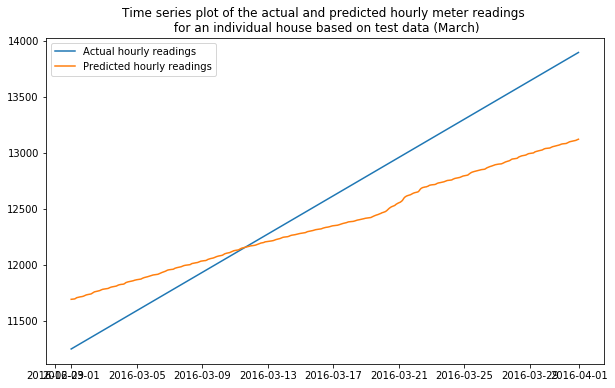

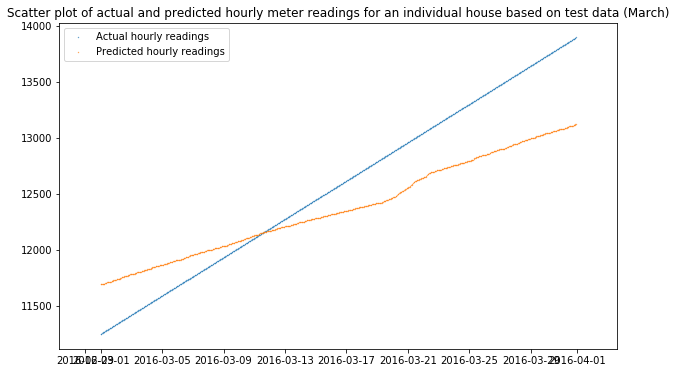

In [20]:
######################################
## LINEAR REGRESSION MODEL (Monthly)## 
######################################

# Copying the dataframe so that we do not edit the original dataframe
df_linreg = df_altogether.copy()
df_linreg['month'] = df_linreg.index.month

# Group by month to filter them out
df_grouped_linreg = df_linreg.groupby('month')

# To get training set (October - Febuary)
df_train = pd.DataFrame()
for x in [10,11,12,1,2]:
    df_get_group = df_grouped_linreg.get_group(x)
    df_train = pd.concat([df_train,df_get_group])

# To get test set (March)
df_test = df_grouped_linreg.get_group(3)

# Converting the datetime index to seconds, as the linear regression model
# only works with numerical data. 
df_train.index = (df_train.index - pd.to_datetime('1970-01-01 00:00:00')).total_seconds()
df_test.index = (df_test.index - pd.to_datetime('1970-01-01 00:00:00')).total_seconds()

reg_monthly = LinearRegression()

# Getting the parameters out 
X_train, y_train = df_train.index.values.reshape(-1,1),df_train.meter_reading.values.reshape(-1,1)
X_test, y_test = df_test.index.values.reshape(-1,1),df_test.meter_reading.values.reshape(-1,1)

# Fitting the Linear Regression model 
reg_monthly.fit(X_train,y_train)

y_pred = reg_monthly.predict(X_test)

# Converting from seconds to datetime for easier visualization 
index = []
for z in df_train.index.values:
    index.append(pd.to_datetime(z,unit='s'))
df_train.index = index

index = []
for z in df_test.index.values:
    index.append(pd.to_datetime(z,unit='s'))
df_test.index = index

# For plotting purposes: 
X_train, y_train = df_train.index.values.reshape(-1,1),df_train.meter_reading.values.reshape(-1,1)
X_test, y_test = df_test.index.values.reshape(-1,1),df_test.meter_reading.values.reshape(-1,1)

plt.figure(1,figsize = (10,6))
plt.title('Time series plot of the actual and predicted hourly meter readings \n for an individual house based on test data (March)')
plt.plot(X_test,y_pred,label = 'Actual hourly readings')
plt.plot(X_test,y_test,label = 'Predicted hourly readings')
plt.legend()

plt.figure(2,figsize = (10,6))
plt.title('Scatter plot of actual and predicted hourly meter readings for an individual house based on test data (March)')
plt.scatter(X_test,y_pred,label = 'Actual hourly readings',s=0.1)
plt.scatter(X_test,y_test,label = 'Predicted hourly readings',s=0.1)
plt.legend()



In [21]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error


print('Metrics for Linear Regression (Monthly)')
r2 = r2_score(y_test,y_pred)
rmse = np.sqrt(mean_squared_error(y_test,y_pred))
print(f'r2_score = {r2}')
print(f'RMSE: {rmse}')

Metrics for Linear Regression (Monthly)
r2_score = 0.08841077436358291
RMSE: 399.4113563208688


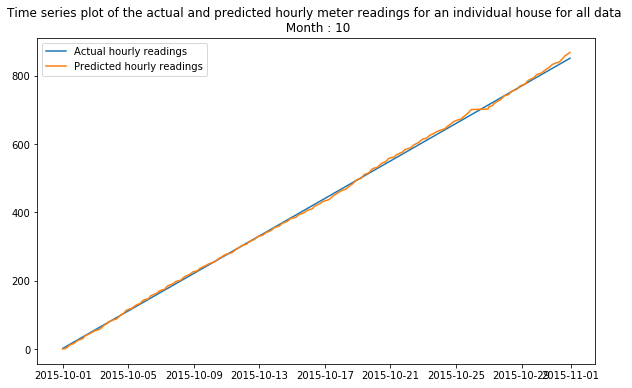

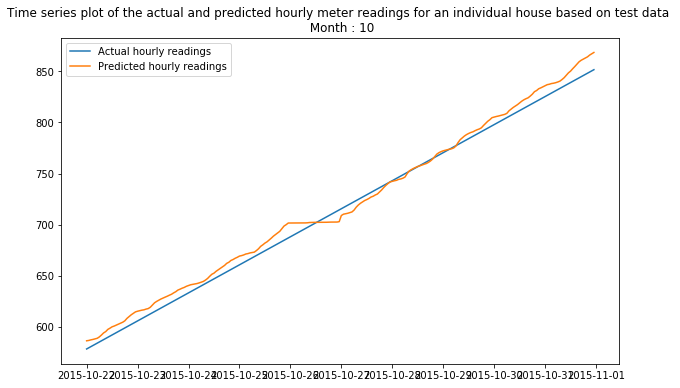

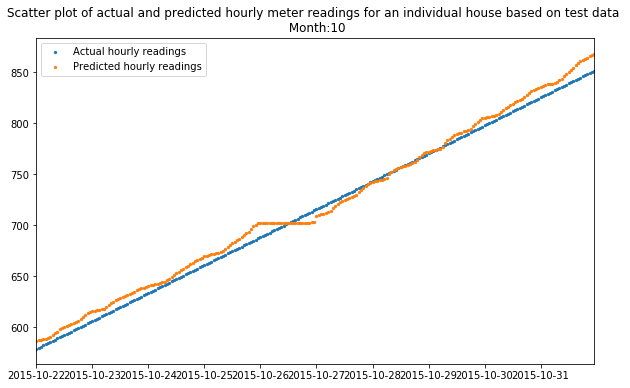

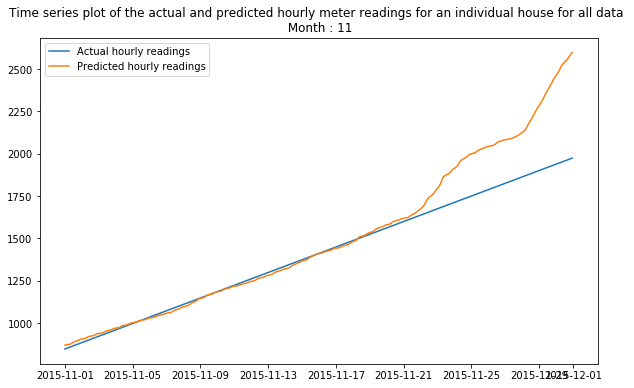

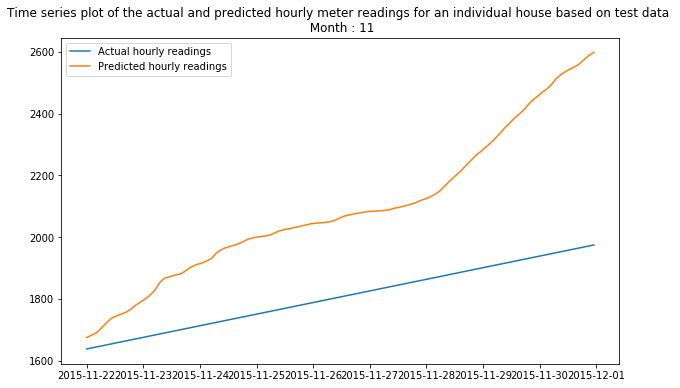

...

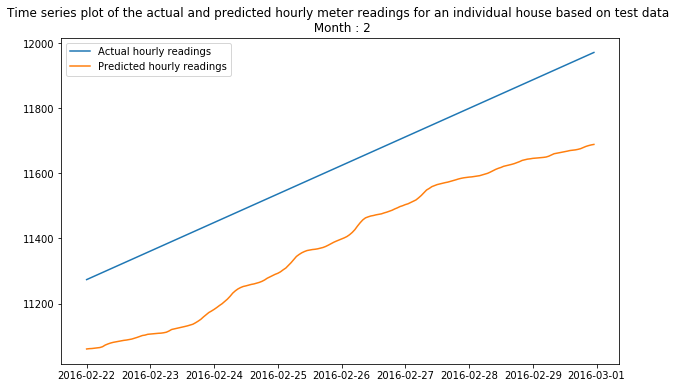

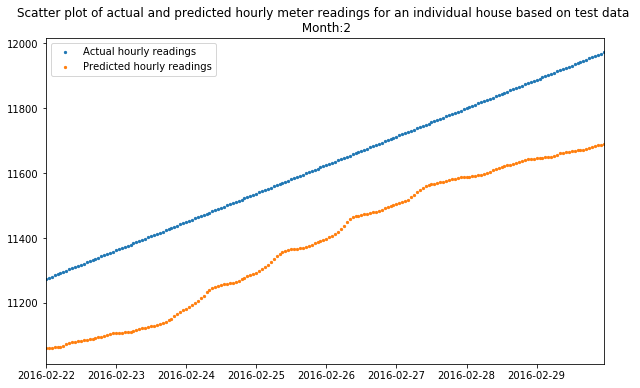

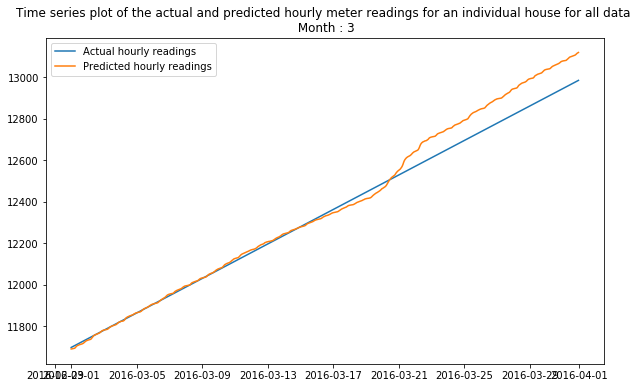

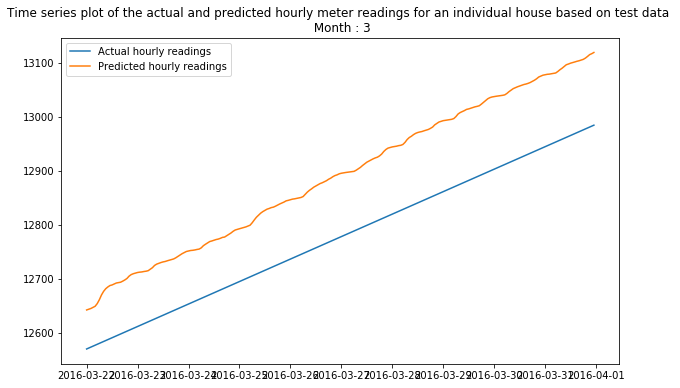

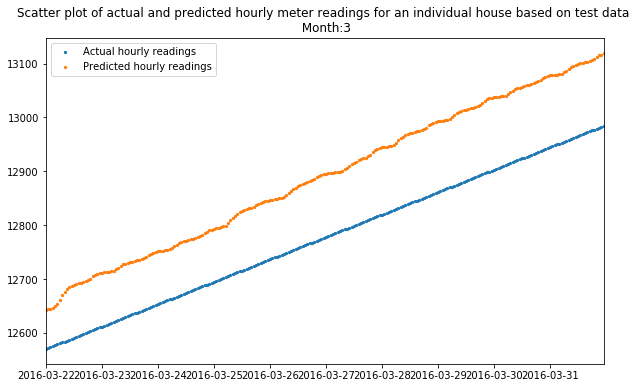

In [22]:
#############################################################
## LINEAR REGRESSION MODEL (Weekly )                       ##
## Train on the first 21 days to predict the remaining days## 
#############################################################

fig = 1
r2 = []
rmse = []
# Copying the dataframe so that we do not edit the original dataframe
df_linreg = df_altogether.copy()
df_linreg['month'] = df_linreg.index.month
df_linreg['day'] = df_linreg.index.day

df_linreg_metrics = pd.DataFrame()

# Group by month to filter 
df_grouped_linreg = df_linreg.groupby('month')

months = [10,11,12,1,2,3]
df_train = pd.DataFrame()
for month in months: 
    df_monthly = df_grouped_linreg.get_group(month)
    df_daily = df_grouped_linreg.get_group(month).groupby('day')
    days = np.array(df_daily['day'].unique().values)
    train_days = days[0:21]
    test_days = days[21:]

    df_train = pd.DataFrame()
    df_test = pd.DataFrame()
    # Get training data:
    for day in train_days:
        df_train = pd.concat([df_train,df_daily.get_group(day[0])])

    # Get testing data:
    for day in test_days:
        df_test = pd.concat([df_test,df_daily.get_group(day[0])])

    # Converting the datetime index to seconds, as the linear regression model
    # only works with numerical data. 
    df_train.index = (df_train.index - pd.to_datetime('1970-01-01 00:00:00')).total_seconds()
    df_test.index = (df_test.index - pd.to_datetime('1970-01-01 00:00:00')).total_seconds()
    df_monthly.index = (df_monthly.index - pd.to_datetime('1970-01-01 00:00:00')).total_seconds()

    reg_weekly = LinearRegression()

    # Getting the parameters out 
    X_train, y_train = df_train.index.values.reshape(-1,1),df_train.meter_reading.values.reshape(-1,1)
    X_test, y_test = df_test.index.values.reshape(-1,1),df_test.meter_reading.values.reshape(-1,1)
    X,y = df_monthly.index.values.reshape(-1,1),df_monthly.meter_reading.values.reshape(-1,1)

    # Fitting the Linear Regression model 
    reg_weekly.fit(X_train,y_train)

    y_pred = reg_weekly.predict(X_test)
    y_pred_all = reg_weekly.predict(X)
    # Converting from seconds to datetime for easier visualization 
    index = []
    r2.append(r2_score(y_test,y_pred))
    rmse.append(np.sqrt(mean_squared_error(y_test,y_pred)))
    for z in df_train.index.values:
        index.append(pd.to_datetime(z,unit='s'))
    df_train.index = index

    index = []
    for z in df_test.index.values:
        index.append(pd.to_datetime(z,unit='s'))
    df_test.index = index

    index = []
    for z in df_monthly.index.values:
        index.append(pd.to_datetime(z,unit='s'))
    df_monthly.index = index


    # For plotting purposes: 
    X_train, y_train = df_train.index.values.reshape(-1,1),df_train.meter_reading.values.reshape(-1,1)
    X_test, y_test = df_test.index.values.reshape(-1,1),df_test.meter_reading.values.reshape(-1,1)
    X,y = df_monthly.index.values.reshape(-1,1),df_monthly.meter_reading.values.reshape(-1,1)

    plt.figure(fig,figsize = (10,6))
    plt.title(f'Time series plot of the actual and predicted hourly meter readings for an individual house for all data \n Month : {month}')
    plt.plot(X,y_pred_all,label = 'Actual hourly readings')
    plt.plot(X,y,label = 'Predicted hourly readings')
    plt.legend()
    fig +=1
    
    plt.figure(fig,figsize = (10,6))
    plt.title(f'Time series plot of the actual and predicted hourly meter readings for an individual house based on test data \n Month : {month}')
    plt.plot(X_test,y_pred,label = 'Actual hourly readings')
    plt.plot(X_test,y_test,label = 'Predicted hourly readings')
    plt.legend()
    fig += 1
    
    plt.figure(fig,figsize = (10,6))
    plt.title(f'Scatter plot of actual and predicted hourly meter readings for an individual house based on test data \n Month:{month}')
    plt.scatter(X_test,y_pred,label = 'Actual hourly readings',s=5)
    plt.scatter(X_test,y_test,label = 'Predicted hourly readings',s=5)
    plt.xlim(X_test[0],X_test[-1])
    plt.legend()
    fig += 1

df_linreg_metrics['r2'] = r2
df_linreg_metrics['rmse'] = rmse
df_linreg_metrics['month'] = months

In [23]:
print(df_linreg_metrics)

         r2        rmse  month
0  0.990929    7.559444     10
1 -0.854098  320.161986     11
2  0.827648  112.439481     12
3  0.982601   47.561861      1
4 -0.279796  235.877927      2
5  0.273913  115.324300      3


**Thoughts about Linear Regression:**

A linear forecasting model works well if the gas consumption does not experience big spikes due to certain events. In general, from the RMS and R2 values, the linear regression model works better when the data is split into the weekly form. However, linear regression did not manage to predict the gas consumption for the test set accurately, with the exception of October. 

**Support Vector Regression Model:**

/home/sourav/anaconda3/lib/python3.6/site-packages/sklearn/utils/validation.py:752: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/sourav/anaconda3/lib/python3.6/site-packages/sklearn/svm/base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)


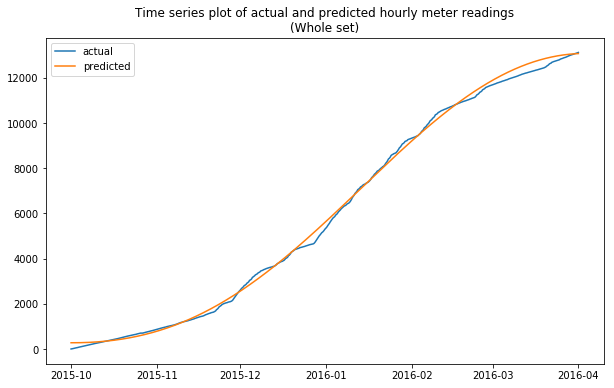

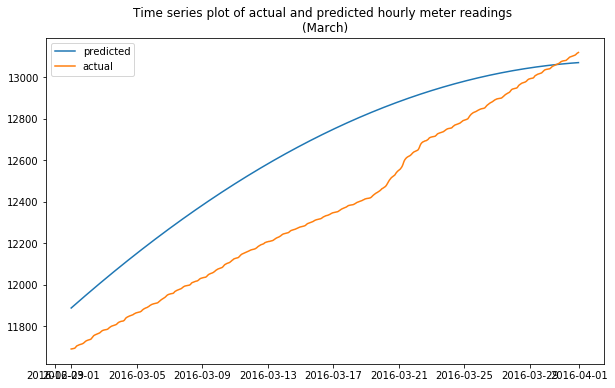

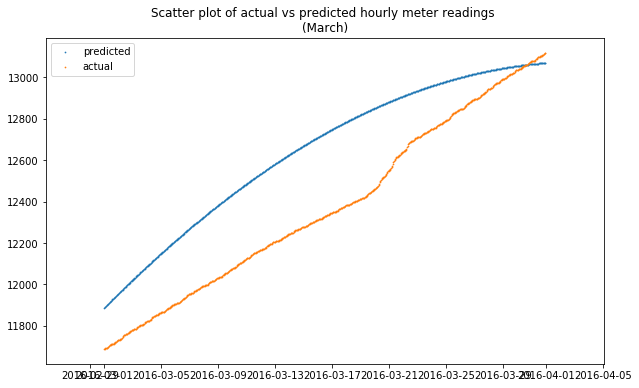

In [24]:
##############################################
## SUPPORT VECTOR REGRESSION MODEL (Monthly)## 
##############################################

df_SVR = df_altogether.copy()
df_SVR['month'] = df_SVR.index.month

# Group by month to filter them out
df_grouped_SVR = df_SVR.groupby('month')

# To get training set (October - Febuary)
df_train = pd.DataFrame()
for x in [10,11,12,1,2]:
    df_get_group = df_grouped_SVR.get_group(x)
    df_train = pd.concat([df_train,df_get_group])

# To get test set (March)
df_test = df_grouped_SVR.get_group(3)

# Converting the datetime index to seconds, as the SVR model
# only works with numerical data. 
df_train.index = (df_train.index - pd.to_datetime('1970-01-01 00:00:00')).total_seconds()
df_test.index = (df_test.index - pd.to_datetime('1970-01-01 00:00:00')).total_seconds()
df_SVR.index = (df_SVR.index - pd.to_datetime('1970-01-01 00:00:00')).total_seconds()

# Normalization 
X_train,y_train = df_train.index.values,df_train.meter_reading.values
X_test,y_test   = df_test.index.values,df_test.meter_reading.values
X,y             = df_SVR.index.values, df_SVR.meter_reading.values

norm_trainx, norm_trainy = [],[]
norm_testx,norm_testy = [],[]
norm_X = []
max_X,max_y = max(X_train),max(y_train)
min_X,min_y = min(X_train),min(y_train)

for z in y_train:
    norm_trainy.append((z-min_y)/(max_y-min_y))

for z in X_train:
    norm_trainx.append((z-min_X)/(max_X-min_X))

for z in X_test:
    norm_testx.append((z-min_X)/(max_X-min_X))

for z in X:
    norm_X.append((z-min_X)/(max_X-min_X))  

norm_trainx = np.array(norm_trainx).reshape(-1,1)
norm_trainy = np.array(norm_trainy).reshape(-1,1)
norm_testx = np.array(norm_testx).reshape(-1,1)
norm_X = np.array(norm_X).reshape(-1,1)
clf = SVR(kernel = 'rbf',C = 0.1,epsilon = 0.0001)

clf.fit(norm_trainx,norm_trainy)
y_pred = clf.predict(norm_testx)
y_pred2 = clf.predict(norm_X)
# Unnormalize the data to its original state

unnorm_y, unnorm_y2 = [] ,[]

for z in y_pred:
    unnorm_y.append((z*(max_y-min_y)+min_y))

for z in y_pred2:
    unnorm_y2.append((z*(max_y-min_y)+min_y))

index = []
for z in df_test.index.values:
    index.append(pd.to_datetime(z,unit='s'))
df_test.index = index
X_test = df_test.index  

index = []
for z in df_SVR.index.values:
    index.append(pd.to_datetime(z,unit='s'))

df_SVR.index = index
X = df_SVR.index  
y_pred = unnorm_y
y_pred2 = unnorm_y2

plt.figure(1,figsize = (10,6))
plt.title("Time series plot of actual and predicted hourly meter readings\n(Whole set)")
plt.plot(X,y,label = 'actual')
plt.plot(X,y_pred2,label='predicted')
plt.legend()

plt.figure(2,figsize = (10,6))
plt.title("Time series plot of actual and predicted hourly meter readings \n(March)")
plt.plot(X_test,y_pred,label = 'predicted')
plt.plot(X_test,y_test,label = 'actual')
plt.legend()

plt.figure(3,figsize = (10,6))
plt.title("Scatter plot of actual vs predicted hourly meter readings \n(March)")
plt.scatter(X_test,y_pred,label = 'predicted',s=0.5)
plt.scatter(X_test,y_test,label = 'actual',s=0.5)
plt.legend()

In [25]:
print('For SVR (Monthly)')
r2 = r2_score(y_test,y_pred)
rmse = np.sqrt(mean_squared_error(y_test,y_pred))
print(f'r2_score = {r2}')
print(f'RMSE = {rmse}')

For SVR (Monthly)
r2_score = 0.5007457246285183
RMSE = 295.584538697042


/home/sourav/anaconda3/lib/python3.6/site-packages/sklearn/utils/validation.py:752: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/sourav/anaconda3/lib/python3.6/site-packages/sklearn/svm/base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
/home/sourav/anaconda3/lib/python3.6/site-packages/sklearn/utils/validation.py:752: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/sourav/anaconda3/lib/python3.6/site-packages/sklearn/svm/base.py:196: FutureWarning: The default value of gamma will change from 'aut

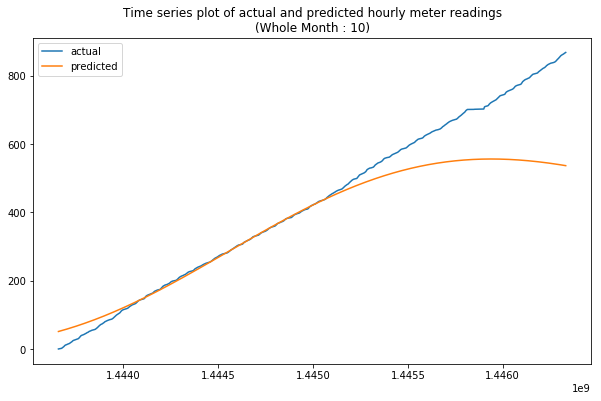

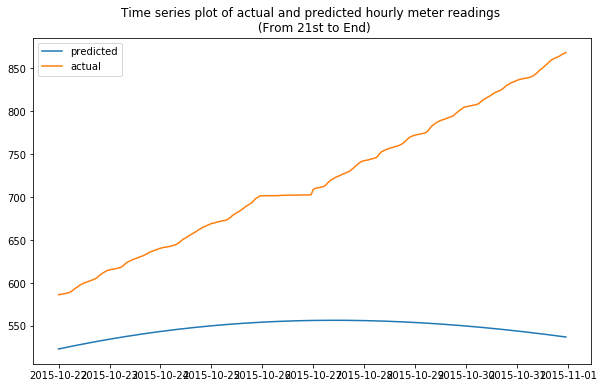

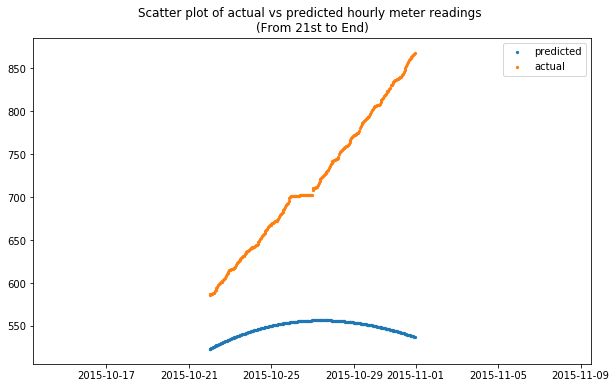

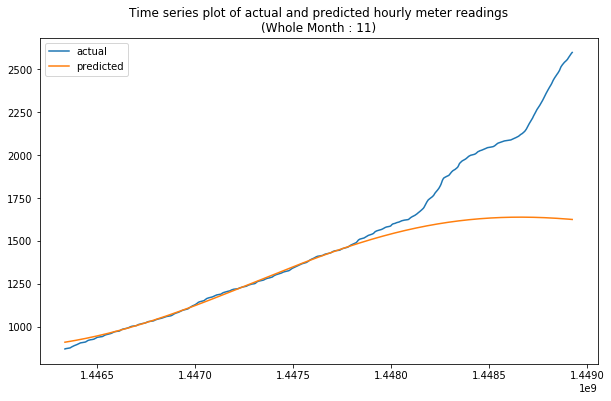

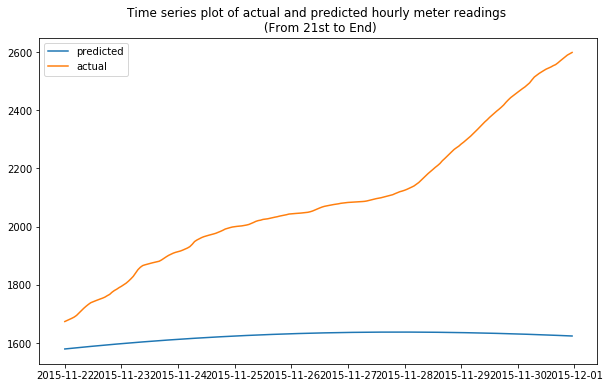

...

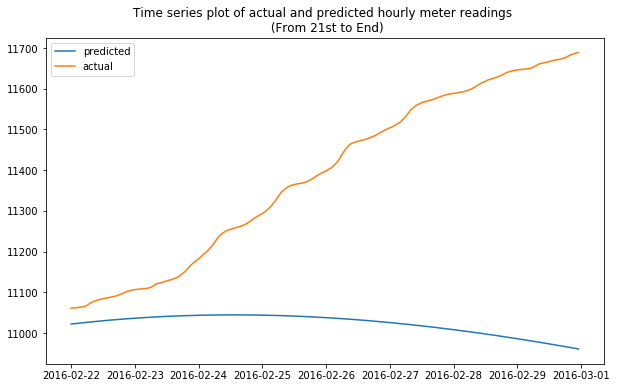

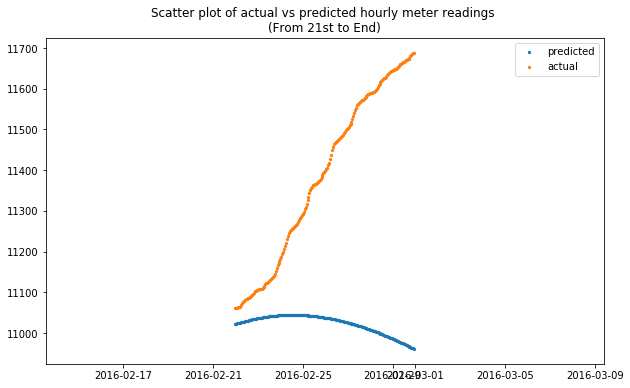

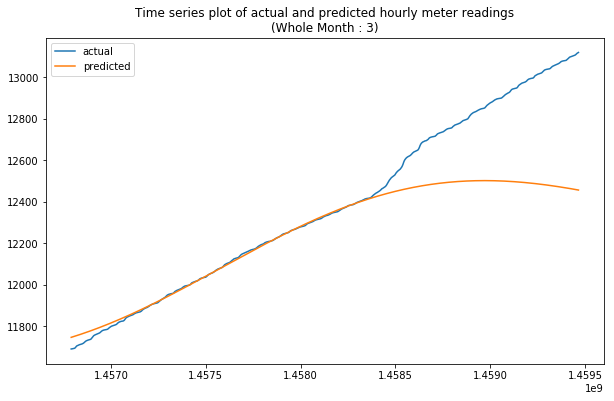

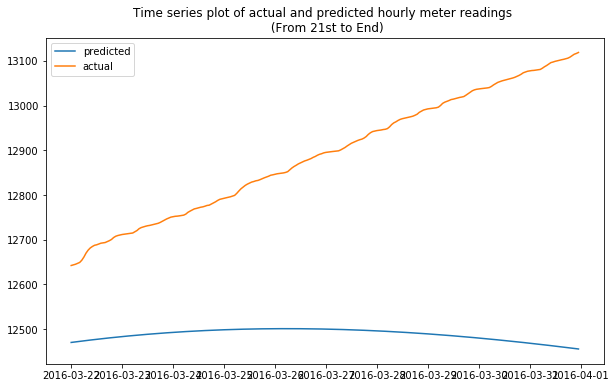

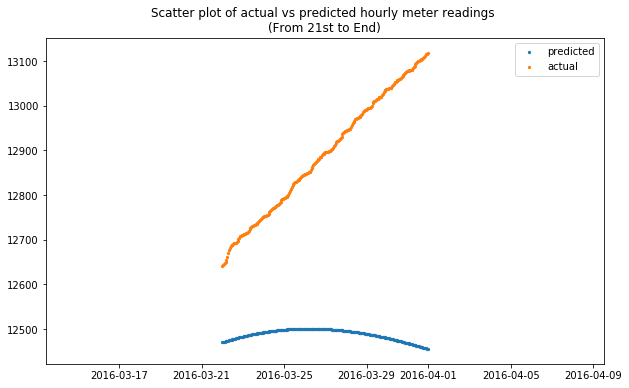

In [26]:
##############################################
## SUPPORT VECTOR REGRESSION MODEL (Weekly )## 
##############################################
fig = 1
df_SVR = df_altogether.copy()
df_SVR['month'] = df_SVR.index.month
df_SVR['day'] = df_SVR.index.day
df_SVR_metrics = pd.DataFrame()
r2 = []
rmse = []
month_metrics = []
# Group by month to filter them out
df_grouped_SVR = df_SVR.groupby('month')

months = [10,11,12,1,2,3]
for month in months: 
    df_monthly = df_grouped_SVR.get_group(month)
    df_daily = df_grouped_SVR.get_group(month).groupby('day')
    days = np.array(df_daily['day'].unique().values)
    train_days = days[0:21]
    test_days = days[21:]

    df_train = pd.DataFrame()
    df_test = pd.DataFrame()
    # Get training data:
    for day in train_days:
        df_train = pd.concat([df_train,df_daily.get_group(day[0])])
  
  # Get testing data:
    for day in test_days:
        df_test = pd.concat([df_test,df_daily.get_group(day[0])])
    
    # Converting the datetime index to seconds, as the SVR model
    # only works with numerical data. 
    df_train.index = (df_train.index - pd.to_datetime('1970-01-01 00:00:00')).total_seconds()
    df_test.index = (df_test.index - pd.to_datetime('1970-01-01 00:00:00')).total_seconds()
    df_monthly.index = (df_monthly.index - pd.to_datetime('1970-01-01 00:00:00')).total_seconds()

  # Normalization 
    X_train,y_train = df_train.index.values,df_train.meter_reading.values
    X_test,y_test   = df_test.index.values,df_test.meter_reading.values
    X,y             = df_monthly.index.values, df_monthly.meter_reading.values

    norm_trainx, norm_trainy = [],[]
    norm_testx,norm_testy = [],[]
    norm_X = []
    max_X,max_y = max(X_train),max(y_train)
    min_X,min_y = min(X_train),min(y_train)

    for z in y_train:
        norm_trainy.append((z-min_y)/(max_y-min_y))

    for z in X_train:
        norm_trainx.append((z-min_X)/(max_X-min_X))

    for z in X_test:
        norm_testx.append((z-min_X)/(max_X-min_X))

    for z in X:
        norm_X.append((z-min_X)/(max_X-min_X))  

    norm_trainx = np.array(norm_trainx).reshape(-1,1)
    norm_trainy = np.array(norm_trainy).reshape(-1,1)
    norm_testx = np.array(norm_testx).reshape(-1,1)
    norm_X = np.array(norm_X).reshape(-1,1)
    clf = SVR(kernel = 'rbf',C = 0.01,epsilon = 0.0001)

    clf.fit(norm_trainx,norm_trainy)
    y_pred = clf.predict(norm_testx)
    y_pred2 = clf.predict(norm_X)

    # Return the data to its original state

    unnorm_y, unnorm_y2 = [] ,[]

    for z in y_pred:
        unnorm_y.append((z*(max_y-min_y)+min_y))

    for z in y_pred2:
        unnorm_y2.append((z*(max_y-min_y)+min_y))

    index = []
    for z in df_test.index.values:
        index.append(pd.to_datetime(z,unit='s'))
    df_test.index = index
    X_test = df_test.index  

    index = []
    for z in df_SVR.index.values:
        index.append(pd.to_datetime(z,unit='s'))

    df_SVR.index = index
    X = df_SVR.index  
    y_pred = unnorm_y
    y_pred2 = unnorm_y2
    r2.append(r2_score(y_test,y_pred))
    rmse.append(np.sqrt(mean_squared_error(y_test,y_pred)))
  
    X,y = df_monthly.index.values.reshape(-1,1),df_monthly.meter_reading.values.reshape(-1,1)

    plt.figure(fig,figsize = (10,6))
    plt.title(f"Time series plot of actual and predicted hourly meter readings\n(Whole Month : {month})")
    plt.plot(X,y,label = 'actual')
    plt.plot(X,y_pred2,label='predicted')
    plt.legend()

    fig +=1
    plt.figure(fig,figsize = (10,6))
    plt.title(f"Time series plot of actual and predicted hourly meter readings \n (From 21st to End)")
    plt.plot(X_test,y_pred,label = 'predicted')
    plt.plot(X_test,y_test,label = 'actual')
    plt.legend()

    fig += 1
    plt.figure(fig,figsize = (10,6))
    plt.title(f"Scatter plot of actual vs predicted hourly meter readings \n(From 21st to End)")
    plt.scatter(X_test,y_pred,label = 'predicted',s=5)
    plt.scatter(X_test,y_test,label = 'actual',s=5)
    plt.legend()

    fig +=1 

df_SVR_metrics['r2'] = r2
df_SVR_metrics['rmse'] = rmse
df_SVR_metrics['month'] = months



In [27]:
print(df_SVR_metrics)

         r2        rmse  month
0 -4.651631  188.691102     10
1 -3.892742  520.091245     11
2 -3.465263  572.313110     12
3 -4.324834  832.061578      1
4 -3.264907  430.597649      2
5 -8.991010  427.790648      3


**Thoughts on SVR:** 

Based on the RMS and R2 values, the SVR works better with the monthly data rather than the weekly split of data. SVRs are not good with dealing with spikes in the data and hence, a better forecasting model should be used.  

## 3. Student Proposal

---
The most common architecture used for time series predictions are Long-Short-Term-Memory(LSTM) and AutoRegressive Integrated Moving Average (ARIMA). For the student proposal, we have decided to choose the LSTM architecture for the time series prediction. 

While comparing to ARIMA, LSTM is specifically designed to handle huge amounts of training data, which fits our context of training the model using 2 months worth of daily gas consumption. Hyper tuning ARIMA requires a series of parameters (p,d,q), the number of autoregressive terms, the number of nonseasonal differences needed for stationarity and the number of lagged forecast errors in the prediction equation. These parameters must be calculated based on the data which will require multiple iterations and is highly cumbersome. LSTM on the other hand, does not require setting such parameters. Hyper-tuning the LSTM parameters are limited based on the number of epochs, batch size, learning rate and optimiser used which are simple and convenient to tune. 

Furthermore, according to research, ARIMA works well for stationary time series where the mean, variance and autocorrelation are constant over time. This will not work well for the prediction of gas consumption where the time series can be classified as non-stationary, where the series are influenced by the season of the year. LSTM on the other hand, are capable of learning nonlinearities. This effectively means that LSTM are able to handle non-stationary time series. As such, LSTM will work better for our dataset where the time series is not stationary. 

Lastly, LSTM are an implementation of RNN that is able to deal with long-term temporal dependencies. LSTM units include a 'memory cell' that can maintain information in memory for long periods of time. 
LSTM contains a forget gate where new inputs are passed through. The gate can determine if the new inputs are relevant or not and can choose to dispose of it accordingly. Because the forget gate is essentially the weights and activation function for the cell state, and because the LSTM can learn to set that forget gate for important things in the cell state, information can pass through unchanged. 
As a result, this provides the LSTM architecture to capture long-term dependencies, preventing the vanishing gradient problem which most neural network that use Stochastic gradient descent optimiser face.

As such, LSTM was chosen as the architecture for the time series prediction as it is superior to both the ARIMA and conventional RNN architecture.

---

Preprocessing of data for LSTM:

In [28]:
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM
from keras.layers.convolutional import Conv1D
from keras.layers.convolutional import MaxPooling1D
from keras.layers import Dropout
from keras.layers import Dense
from sklearn.metrics import mean_squared_error
from keras.layers.advanced_activations import LeakyReLU


#Code to produce dataframe with hourly consumption data that is:
    #Free of anomalous values
    #Sampled hourly (pad any missing values with zeros)
    #Indexed in chronological order 

df_grouped = df_without_errors.groupby('dataid')
dict_dataframes = {}

concat_dataframe_ori = pd.DataFrame()

for house in houses: 
  
    # Sort dataframe by dataid
    df_x = df_grouped.get_group(house)
    # Use timestamp as index
    local_minute = list(df_x.localminute)
    meter_value = list(df_x['meter_value'])
    dataid = list(df_x['dataid'])
    meter_diff = list(df_x['meter_diff'])
    index = local_minute
    # Create new dataframe 
    data = {'meter_value':meter_value,'dataid':dataid,'meter_diff':meter_diff}
    df_new = pd.DataFrame(data,index)
  
    #Resample the data such that it reports the increment per hour
    df_new_resampled = df_new.resample('H').mean()
    df_new_resampled.meter_diff = df_new.meter_diff.resample('H').sum()
    df_new_resampled.meter_value = df_new.meter_value.resample('H').last()
    
    # Fill in the missing values 
    missing_values = {'dataid': house,'meter_diff': 0}
    df_filled = df_new_resampled.fillna(value=missing_values)
    df_filled = df_filled.fillna(method = 'pad')

    # Generated the month,weekday,hour
    df_filled['month'] = df_filled.index.month
    df_filled['hour'] = df_filled.index.hour
    df_filled['weekday'] = df_filled.index.weekday

    frames = [concat_dataframe_ori, df_filled]
    concat_dataframe_ori = pd.concat(frames)
    dict_dataframes[house] = df_filled.copy()   

Using TensorFlow backend.


Helper functions for LSTM:

In [29]:
def house_selection(house, dataframe_original):
    #Make copy of house that is to be visualized
    dataframe = dataframe_original.copy()
    dataframe = dataframe.groupby('dataid')
    df_house = dataframe.get_group(house).copy()
    return df_house


def modifying_cols(data):
    
    n_vars = 1 if type(data) is list else data.shape[1]
    dff = pd.DataFrame(data)
    cols = list()
    col_names = list()
    
    for i in range(1, 0, -1):
        cols.append(dff.shift(-i))
        col_names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    
    for i in range(0, 1):
        cols.append(dff.shift(-i))
        if i == 0:
            col_names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
        else:
            col_names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    
    output_dataFrame = pd.concat(cols, axis=1)
    output_dataFrame.columns = col_names
    output_dataFrame.dropna(inplace=True)
    return output_dataFrame
        

def scaling(dataframe):
    
    values = dataframe.values
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled = scaler.fit_transform(values)
    values_agg = values[:,2]
    array_max = values_agg.max()
    array_min = values_agg.min()
    reframed = modifying_cols(scaled)
    
    #Just keep data for time (t-1) and time (t) and drop all other cols
    reframed.drop(reframed.columns[[0,1,3,4,5,6,7,9,10,11]], axis=1, inplace=True)

    return reframed, array_max, array_min


def reshape_dataframe(dataframe, time_step, train_time):
    
    #Reshape data into shape that can be accepted into the LSTM
    values = dataframe.values
    n_train_time = train_time*time_step
    train = values[:n_train_time, :]
    test = values[n_train_time:, :]
    train_X, train_Y = train[:,:-1], train[:,-1]
    test_X, test_Y = test[:,:-1], test[:,-1]
    
    #Updated Training format is now [samples = 60 days, timesteps = 24 hourly readings, features = 1]
    #Updated Test format is now [samples = (total days-60) days, timesteps = 24 hourly readings, features = 1]
    train_X_samples = int(train_X.shape[0]/time_step)
    test_X_samples = int(test_X.shape[0]/time_step)
    train_X, train_Y = train_X[:train_X_samples*time_step], train_Y[:train_X_samples*time_step]
    test_X, test_Y = test_X[:test_X_samples*time_step], test_Y[:test_X_samples*time_step]
    train_X = train_X.reshape((train_X_samples,time_step,train_X.shape[1]))
    test_X = test_X.reshape((test_X_samples, time_step, test_X.shape[1]))
    train_Y = train_Y.reshape((train_X_samples,time_step))
    test_Y = test_Y.reshape((test_X_samples, time_step))
    
    return train_Y, train_X, test_Y, test_X

In [30]:
def run_LSTM(train_Y, train_X, test_Y, test_X, time_step, array_max, array_min, house_pred):

    #create LSTM Model
    #Input is [24,1] vector
    #Hidden layer of 100 neurons -> With dropout of 0.25 to reduce overfitting
    #Output is 24 neurons
    model = Sequential()
    model.add(LSTM(100, input_shape = (train_X.shape[1], train_X.shape[2])))
    model.add(Dropout(0.25))
    model.add(Dense(24))
    model.compile(loss='mean_squared_error', optimizer='adam')
    
    #Generate model with test and train data
    #Train with 20 epochs
    #Training batch size of 20
    history = model.fit(train_X, train_Y, epochs=20, batch_size = 20,  validation_data = (test_X, test_Y), verbose = 0, shuffle=False)

    #Perform prediction
    yhat = model.predict(test_X)

    #Denormalize actual hourly data
    test_daily = []
    test_Y = test_Y*(array_max-array_min)+ array_min

    #Sum denormalized actual hourly data to form actual daily consumption data
    for element in test_Y:
        test_daily.append(np.sum(element))
    
    #Denormalize predicted hourly data
    predict_daily = []
    yhat= yhat*(array_max-array_min)+ array_min
    
    #Sum denormalized predicted hourly data to form predicted daily consumption data
    for element in yhat:
        predict_daily.append(np.sum(element))

    #rmse = np.sqrt(mean_squared_error(test_daily, predict_daily))

    if house_pred == 'all':
        #Plot graphs for training and val loss 
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.title('model_loss for all house' )
        plt.ylabel('loss')
        plt.xlabel('epoch')
        plt.legend(['train', 'test'], loc= 'upper right')
        plt.show()

        #Plot graph comparing predicted and actual consumption data
        plt.plot(test_daily)
        plt.plot(predict_daily)
        plt.title('Predicted vs Actual for all houses')
        plt.ylabel('Consumption')
        plt.xlabel('Days (After 60 days training)')
        plt.legend(['Actual', 'Predicted'], loc= 'upper right')
    else:
        #Plot graphs for training and val loss 
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.title('model_loss for house %d' %house_pred)
        plt.ylabel('loss')
        plt.xlabel('epoch')
        plt.legend(['train', 'test'], loc= 'upper right')
        plt.show()

        #Plot graph comparing predicted and actual consumption data
        plt.plot(test_daily)
        plt.plot(predict_daily)
        plt.title('Predicted vs Actual for house %d' %house_pred)
        plt.ylabel('Consumption')
        plt.xlabel('Days (After 60 days training)')
        plt.legend(['Actual', 'Predicted'], loc= 'upper right')

    plt.show()
    
    return predict_daily, test_daily

**LSTM Generation Criteria**

Code that calls above functions to produce LSTMs for all 157 houses given that there is sufficient data for training and validating an LSTM model. For this case, the minimum condition set was that there must be at least ***90 days*** of hourly data present. 

***60*** days of hourly data is to be used for training, while a minimum of ***30*** days of hourly data is to be used for validation. In the case of house 35, there is 183 days of data present. Here, 60 days were used for training, while the remaining 123 days were reserved for validation. In the case of house 1403, there was only 17 days worth of data, so the LSTM was not generated.


LSTM For house no. 35


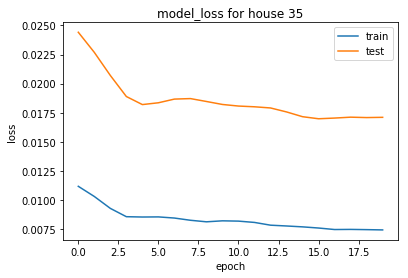

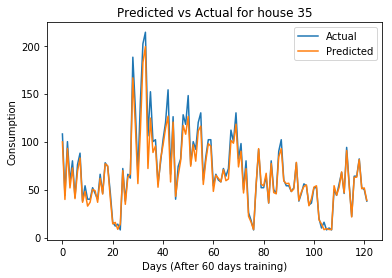

The mean difference between actual and predicted readings is 4.310667
The std between actual and predicted readings is 7.079040



LSTM For house no. 44


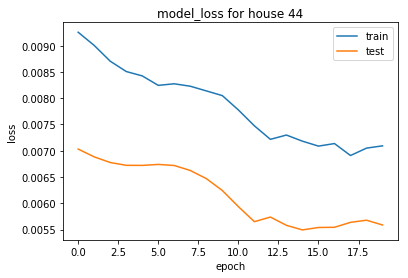

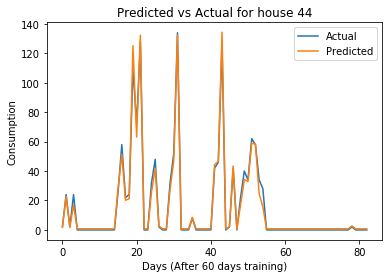

The mean difference between actual and predicted readings is 0.143409
The std between actual and predicted readings is 3.439032



LSTM For house no. 77


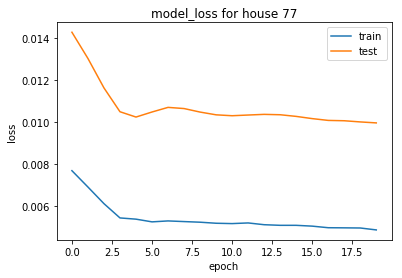

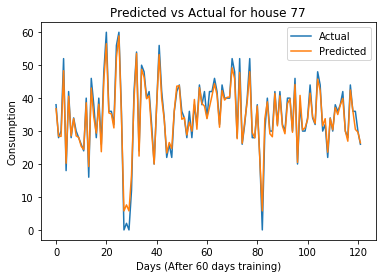

The mean difference between actual and predicted readings is 0.478893
The std between actual and predicted readings is 2.041770



LSTM For house no. 94


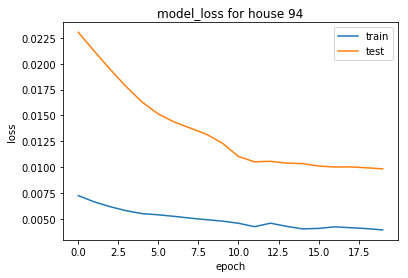

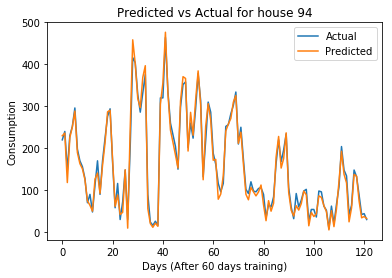

The mean difference between actual and predicted readings is 3.471887
The std between actual and predicted readings is 14.726656



LSTM For house no. 114


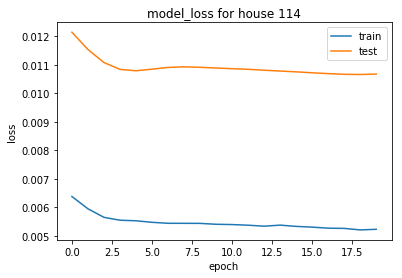

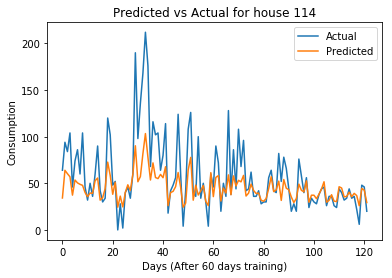

The mean difference between actual and predicted readings is 13.002263
The std between actual and predicted readings is 26.168403



LSTM For house no. 187


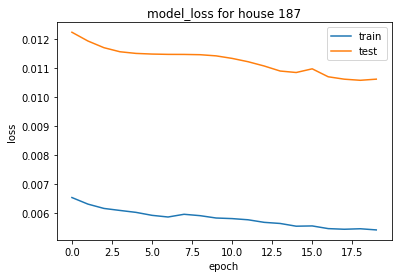

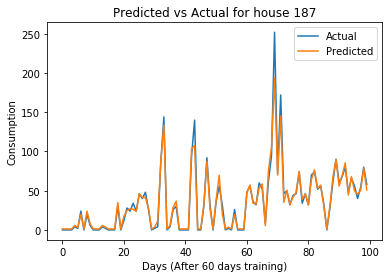

The mean difference between actual and predicted readings is 0.574847
The std between actual and predicted readings is 8.329864



LSTM For house no. 222


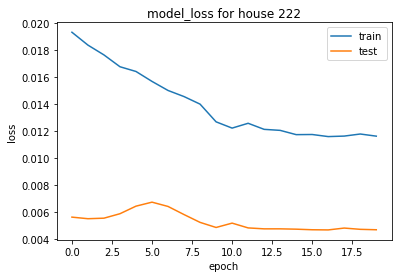

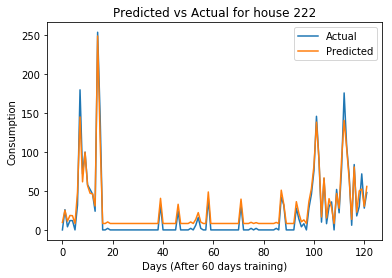

The mean difference between actual and predicted readings is -5.454482
The std between actual and predicted readings is 7.908731



LSTM For house no. 252


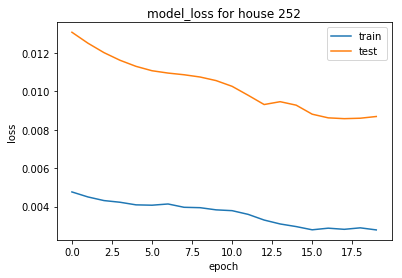

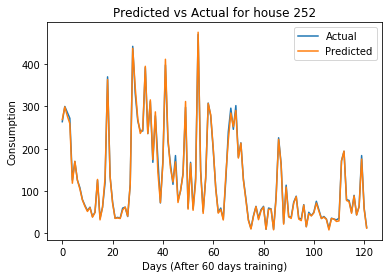

The mean difference between actual and predicted readings is 1.555701
The std between actual and predicted readings is 5.660079



LSTM For house no. 370


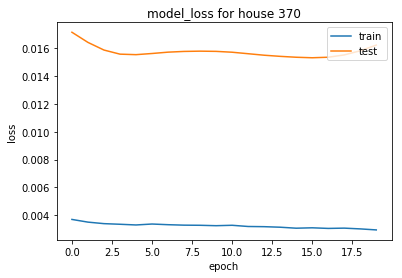

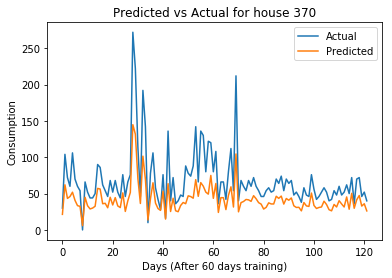

The mean difference between actual and predicted readings is 26.407841
The std between actual and predicted readings is 20.768649



LSTM For house no. 483


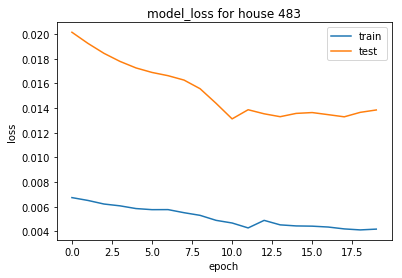

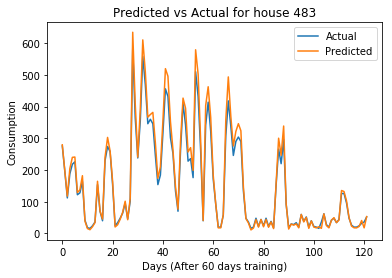

The mean difference between actual and predicted readings is -13.577972
The std between actual and predicted readings is 20.762436



LSTM For house no. 484


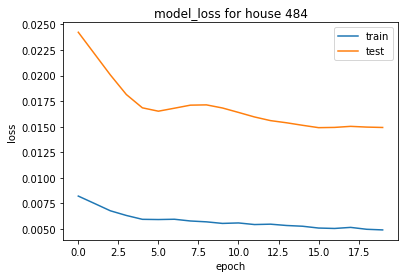

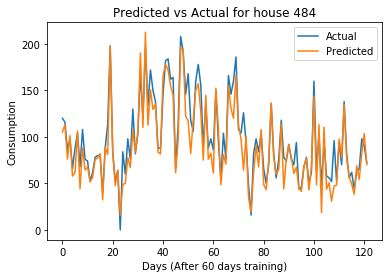

The mean difference between actual and predicted readings is 8.468519
The std between actual and predicted readings is 14.109197



LSTM For house no. 661


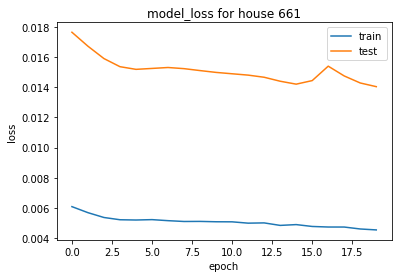

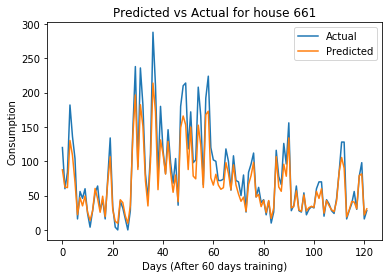

The mean difference between actual and predicted readings is 12.380779
The std between actual and predicted readings is 17.320709



LSTM For house no. 739


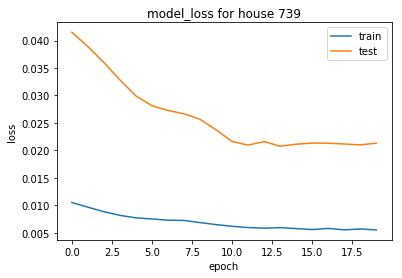

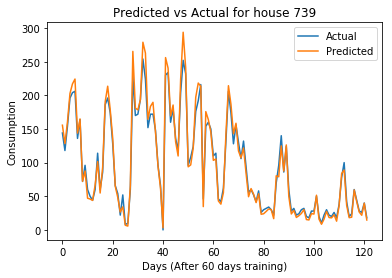

The mean difference between actual and predicted readings is -1.590449
The std between actual and predicted readings is 10.660300



LSTM For house no. 744


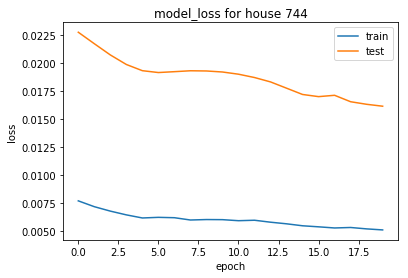

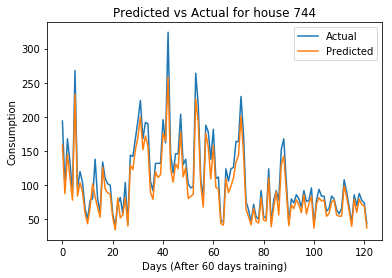

The mean difference between actual and predicted readings is 13.696055
The std between actual and predicted readings is 10.876589



LSTM For house no. 871


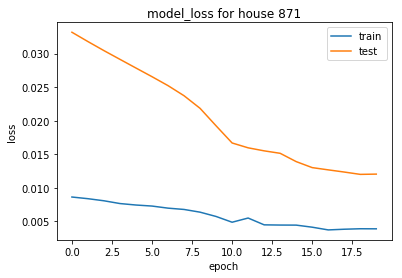

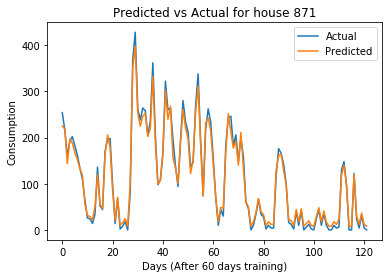

The mean difference between actual and predicted readings is 1.722830
The std between actual and predicted readings is 12.116938



LSTM For house no. 1042


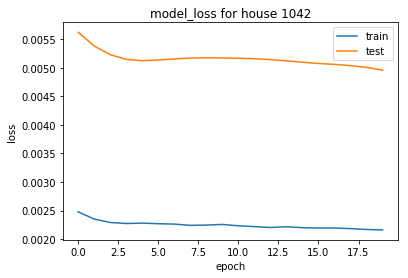

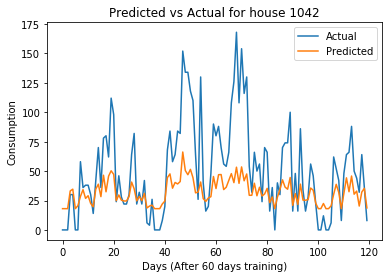

The mean difference between actual and predicted readings is 18.691538
The std between actual and predicted readings is 29.777236



LSTM For house no. 1086


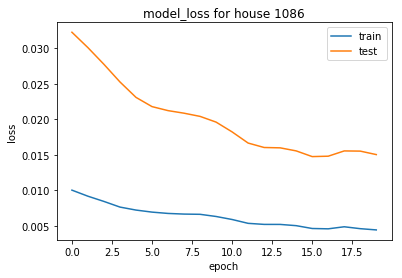

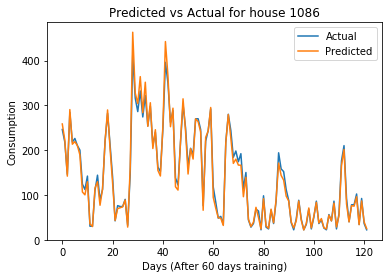

The mean difference between actual and predicted readings is 1.628014
The std between actual and predicted readings is 11.459906



LSTM For house no. 1103


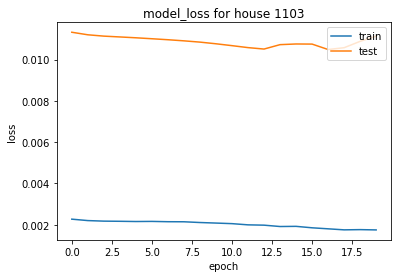

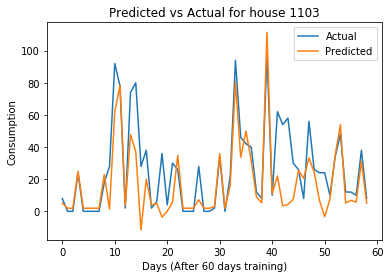

The mean difference between actual and predicted readings is 8.496004
The std between actual and predicted readings is 15.794021



LSTM For house no. 1185


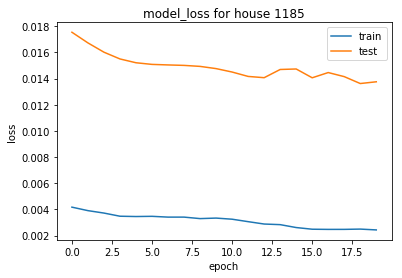

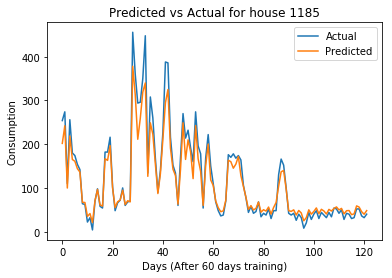

The mean difference between actual and predicted readings is 8.330800
The std between actual and predicted readings is 23.210013



LSTM For house no. 1283


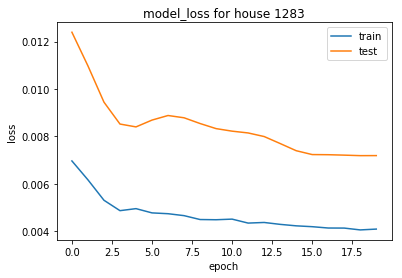

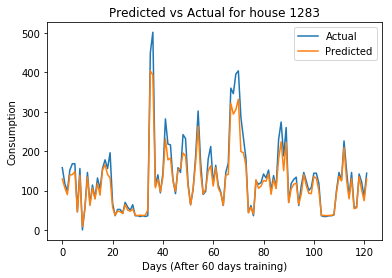

The mean difference between actual and predicted readings is 14.746113
The std between actual and predicted readings is 20.730590



LSTM For house no. 1403
1403 does not have enough data for accurate model fitting and prediction
LSTM For house no. 1415


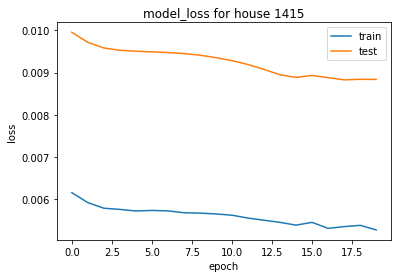

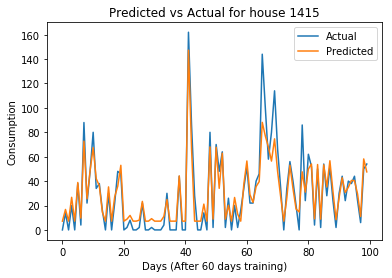

The mean difference between actual and predicted readings is 0.165367
The std between actual and predicted readings is 11.369148



LSTM For house no. 1507


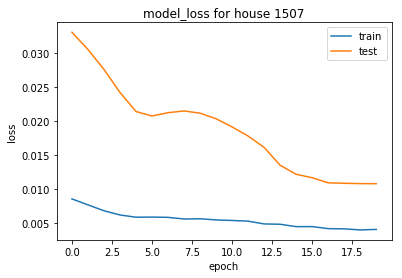

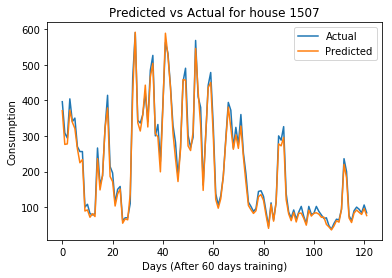

The mean difference between actual and predicted readings is 11.731230
The std between actual and predicted readings is 13.420412



LSTM For house no. 1556


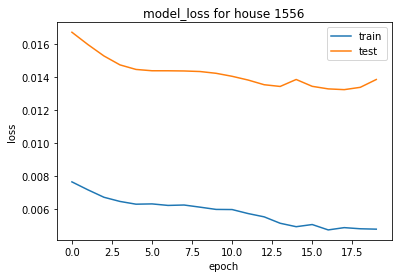

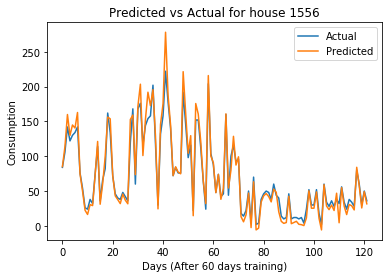

The mean difference between actual and predicted readings is -0.917146
The std between actual and predicted readings is 11.477171



LSTM For house no. 1589


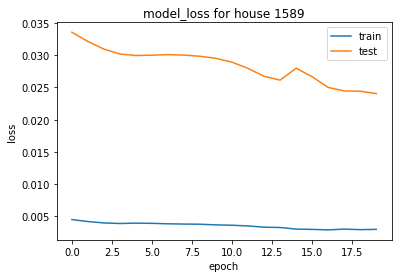

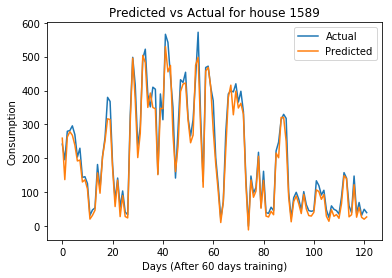

The mean difference between actual and predicted readings is 18.623780
The std between actual and predicted readings is 22.253948



LSTM For house no. 1619


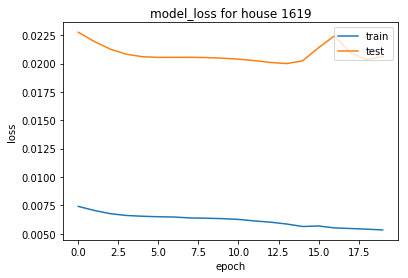

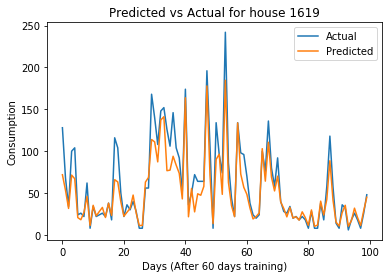

The mean difference between actual and predicted readings is 10.148498
The std between actual and predicted readings is 16.823344



LSTM For house no. 1697


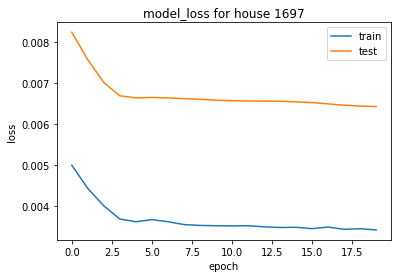

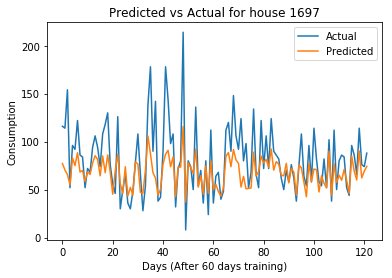

The mean difference between actual and predicted readings is 14.083737
The std between actual and predicted readings is 24.474664



LSTM For house no. 1714


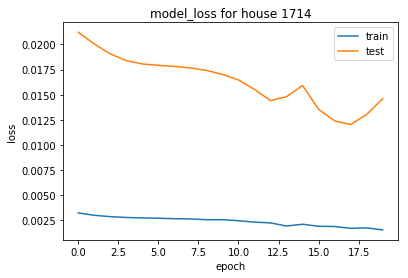

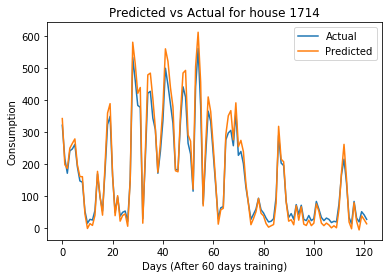

The mean difference between actual and predicted readings is -9.188768
The std between actual and predicted readings is 26.804564



LSTM For house no. 1718


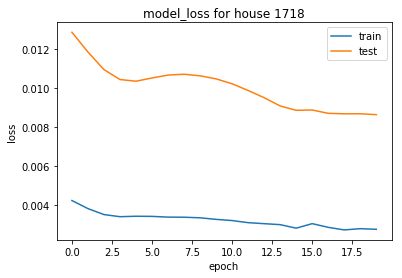

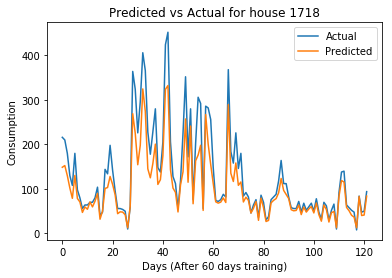

The mean difference between actual and predicted readings is 28.160785
The std between actual and predicted readings is 31.870821



LSTM For house no. 1790


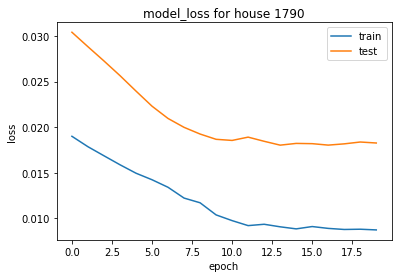

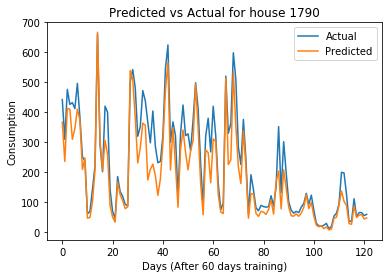

The mean difference between actual and predicted readings is 43.464230
The std between actual and predicted readings is 43.774542



LSTM For house no. 1791


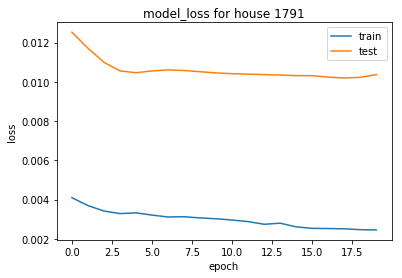

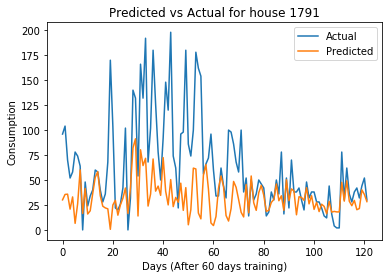

The mean difference between actual and predicted readings is 29.653991
The std between actual and predicted readings is 40.451481



LSTM For house no. 1792


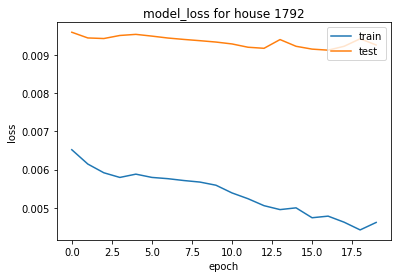

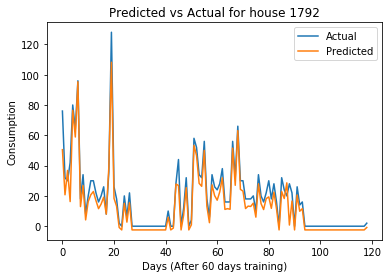

The mean difference between actual and predicted readings is 4.598379
The std between actual and predicted readings is 4.702960



LSTM For house no. 1800


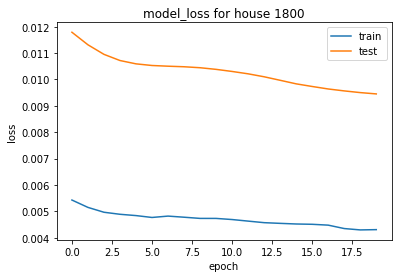

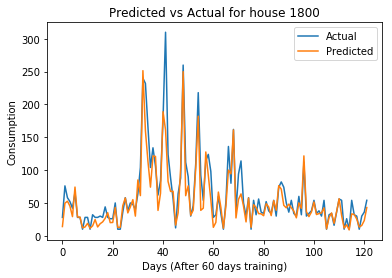

The mean difference between actual and predicted readings is 9.116985
The std between actual and predicted readings is 20.616262



LSTM For house no. 1801


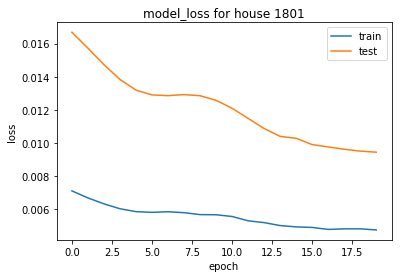

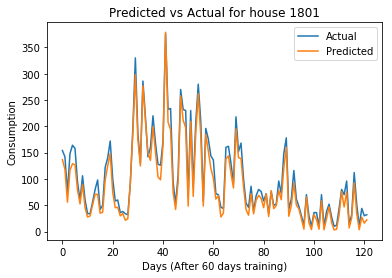

The mean difference between actual and predicted readings is 14.088241
The std between actual and predicted readings is 8.796039



LSTM For house no. 2018


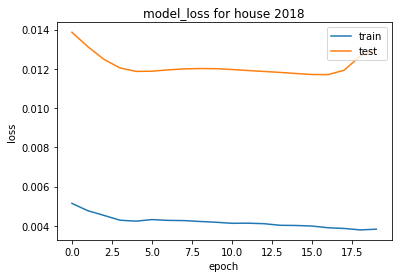

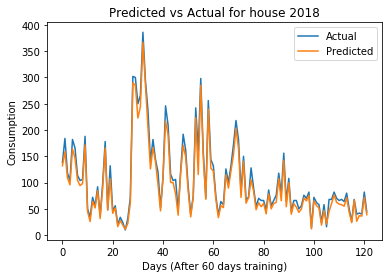

The mean difference between actual and predicted readings is 10.125308
The std between actual and predicted readings is 7.423846



LSTM For house no. 2034


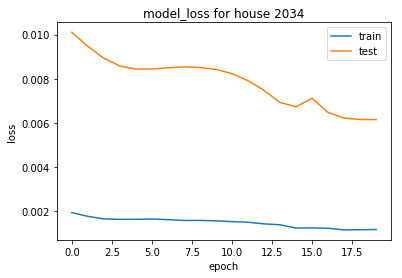

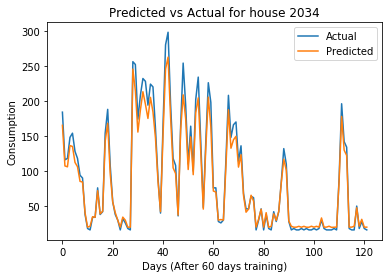

The mean difference between actual and predicted readings is 6.577366
The std between actual and predicted readings is 11.339839



LSTM For house no. 2072


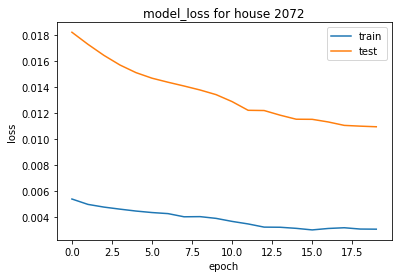

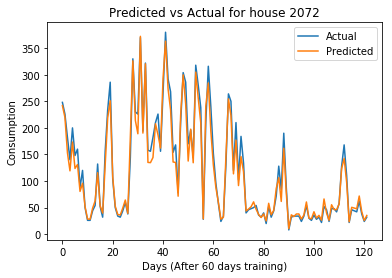

The mean difference between actual and predicted readings is 6.302165
The std between actual and predicted readings is 15.730453



LSTM For house no. 2094


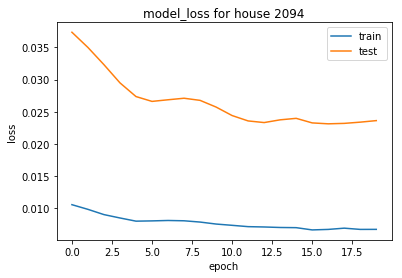

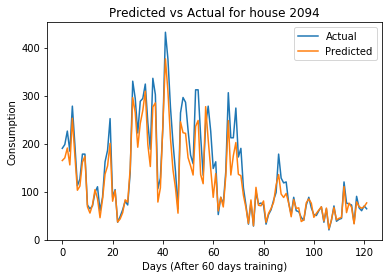

The mean difference between actual and predicted readings is 18.083918
The std between actual and predicted readings is 25.013512



LSTM For house no. 2129


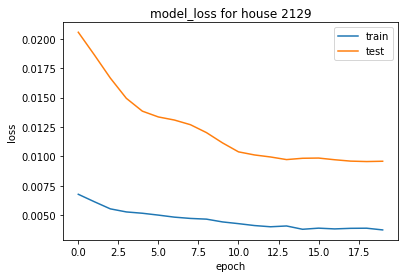

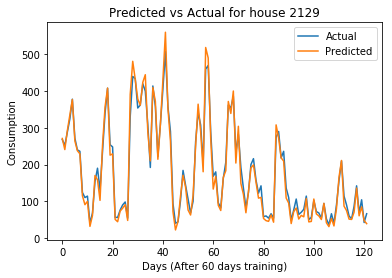

The mean difference between actual and predicted readings is 4.749910
The std between actual and predicted readings is 18.030613



LSTM For house no. 2233


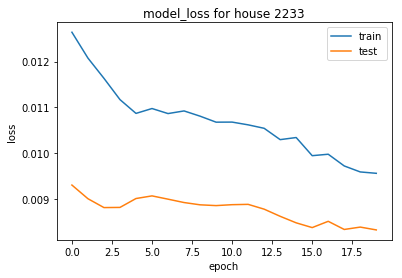

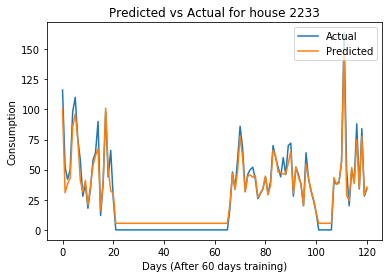

The mean difference between actual and predicted readings is -0.273219
The std between actual and predicted readings is 7.389616



LSTM For house no. 2335


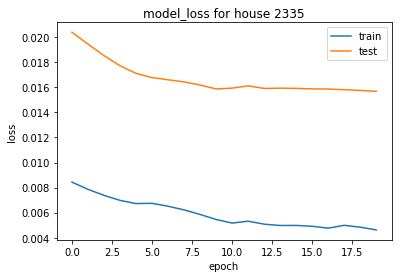

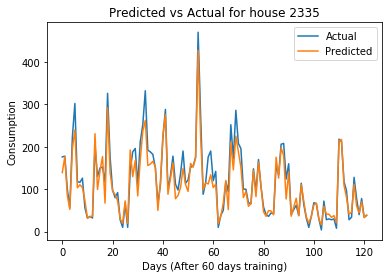

The mean difference between actual and predicted readings is 10.525702
The std between actual and predicted readings is 21.250813



LSTM For house no. 2378


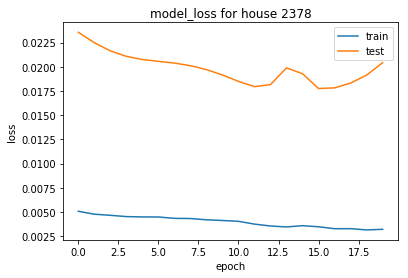

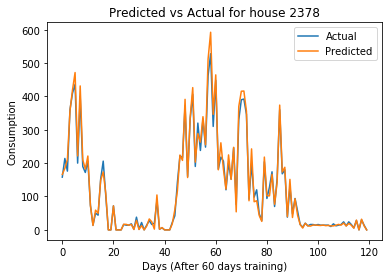

The mean difference between actual and predicted readings is -3.552368
The std between actual and predicted readings is 15.922772



LSTM For house no. 2449


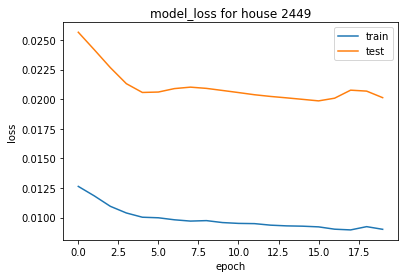

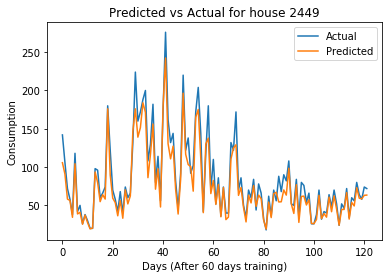

The mean difference between actual and predicted readings is 9.824580
The std between actual and predicted readings is 11.446569



LSTM For house no. 2461


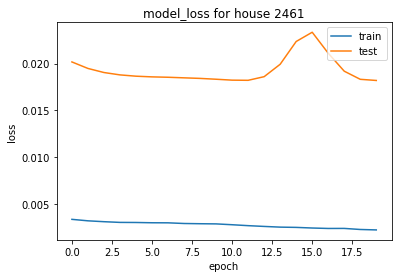

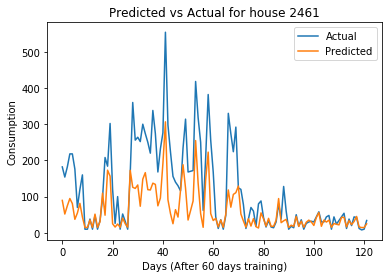

The mean difference between actual and predicted readings is 56.864800
The std between actual and predicted readings is 71.976671



LSTM For house no. 2470


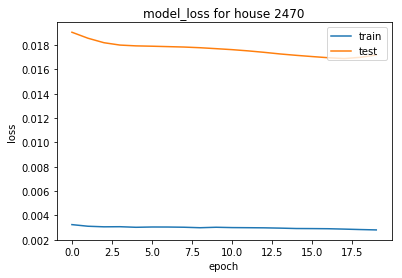

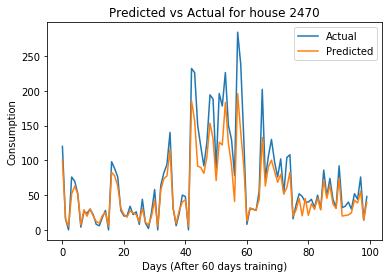

The mean difference between actual and predicted readings is 14.519131
The std between actual and predicted readings is 21.012252



LSTM For house no. 2575


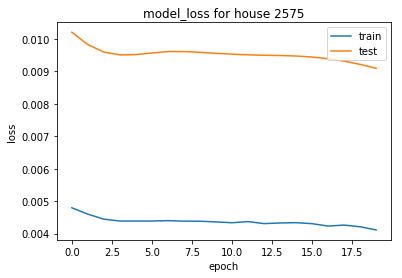

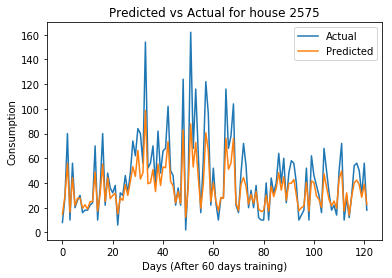

The mean difference between actual and predicted readings is 8.474127
The std between actual and predicted readings is 13.988294



LSTM For house no. 2638


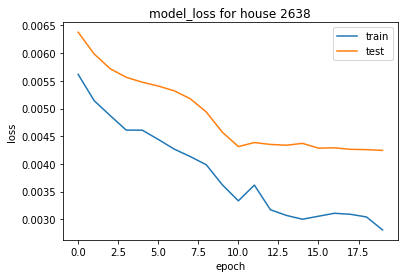

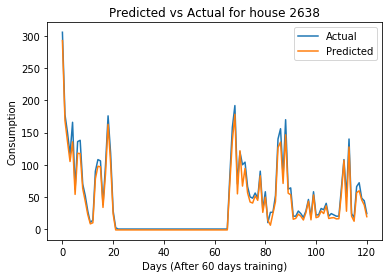

The mean difference between actual and predicted readings is 6.058928
The std between actual and predicted readings is 6.452171



LSTM For house no. 2645


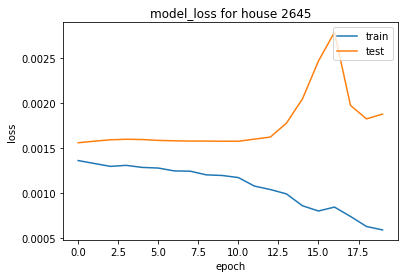

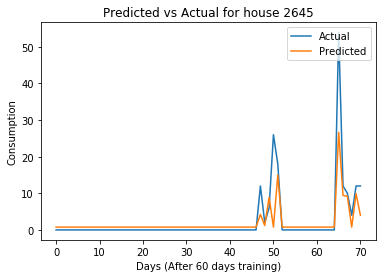

The mean difference between actual and predicted readings is 0.444733
The std between actual and predicted readings is 4.702357



LSTM For house no. 2755
2755 does not have enough data for accurate model fitting and prediction
LSTM For house no. 2814
2814 does not have enough data for accurate model fitting and prediction
LSTM For house no. 2818


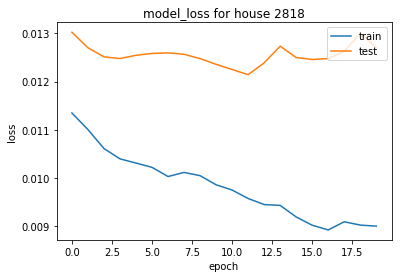

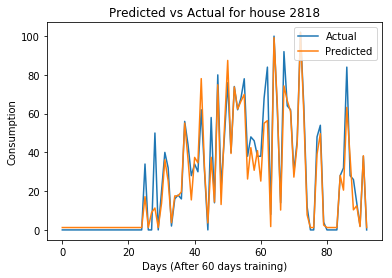

The mean difference between actual and predicted readings is 2.259081
The std between actual and predicted readings is 7.859731



LSTM For house no. 2945


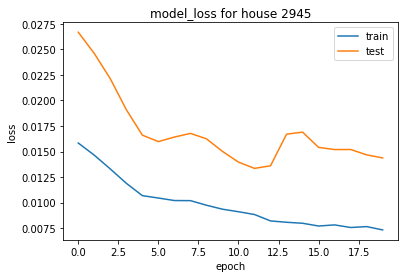

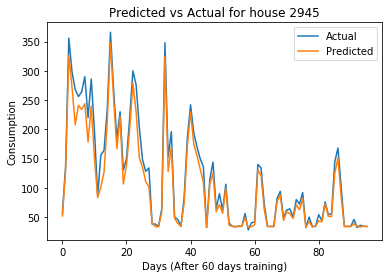

The mean difference between actual and predicted readings is 12.864857
The std between actual and predicted readings is 14.231281



LSTM For house no. 2946
2946 does not have enough data for accurate model fitting and prediction
LSTM For house no. 2965


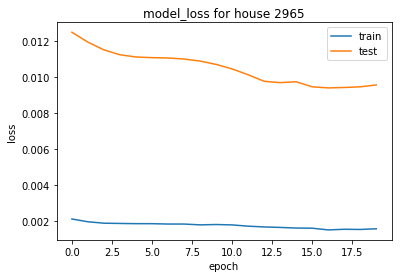

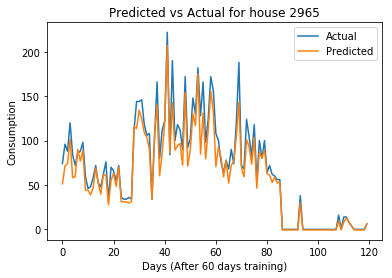

The mean difference between actual and predicted readings is 8.947157
The std between actual and predicted readings is 10.601800



LSTM For house no. 2980


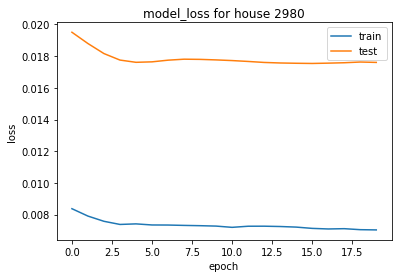

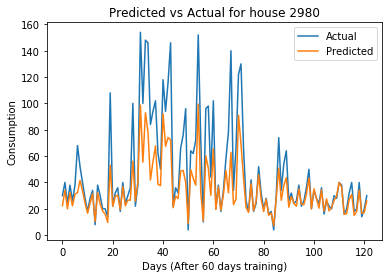

The mean difference between actual and predicted readings is 13.329313
The std between actual and predicted readings is 18.876177



LSTM For house no. 3036
3036 does not have enough data for accurate model fitting and prediction
LSTM For house no. 3039


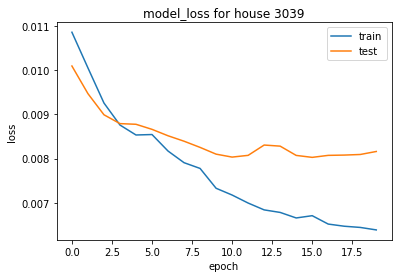

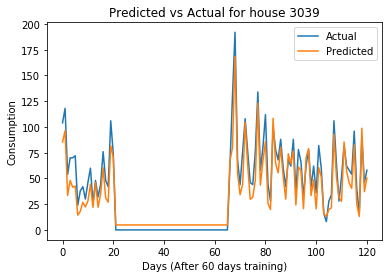

The mean difference between actual and predicted readings is 5.641283
The std between actual and predicted readings is 11.343681



LSTM For house no. 3134


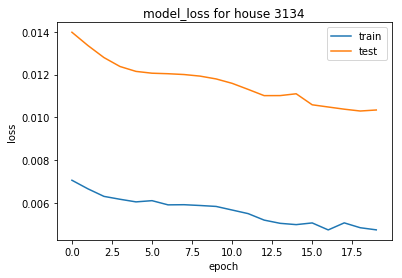

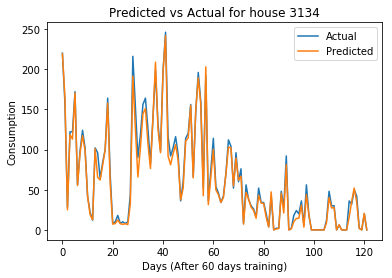

The mean difference between actual and predicted readings is 4.290292
The std between actual and predicted readings is 6.728509



LSTM For house no. 3310


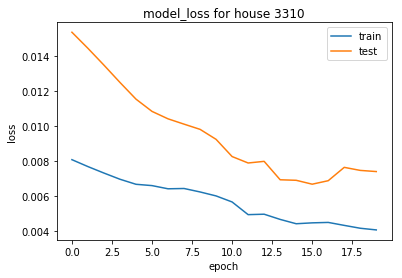

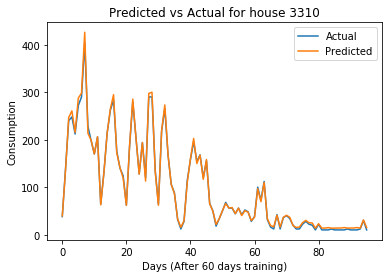

The mean difference between actual and predicted readings is -1.685487
The std between actual and predicted readings is 4.538325



LSTM For house no. 3367


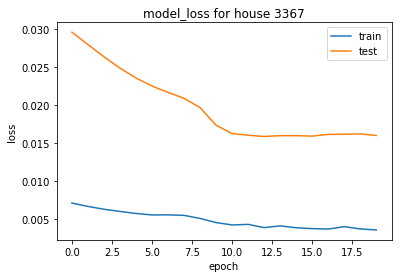

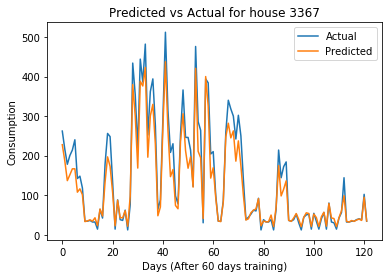

The mean difference between actual and predicted readings is 19.930507
The std between actual and predicted readings is 28.365820



LSTM For house no. 3527


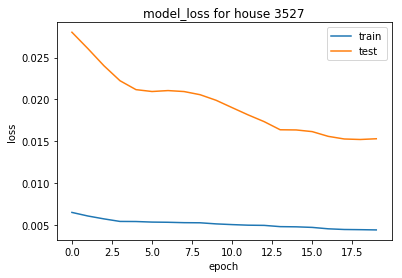

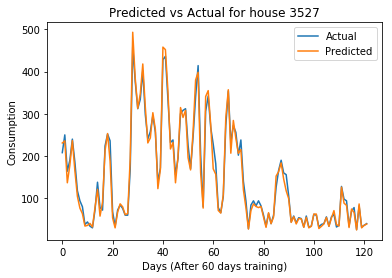

The mean difference between actual and predicted readings is 2.846117
The std between actual and predicted readings is 15.227185



LSTM For house no. 3544


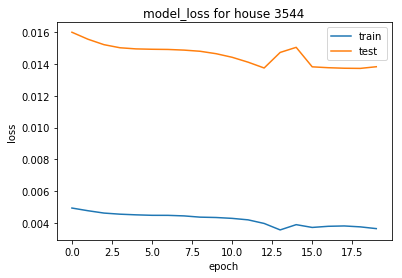

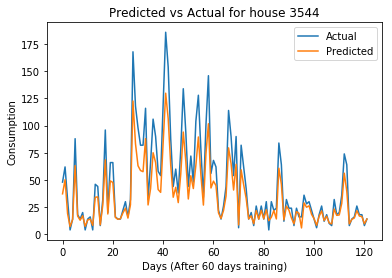

The mean difference between actual and predicted readings is 11.194531
The std between actual and predicted readings is 13.177987



LSTM For house no. 3577


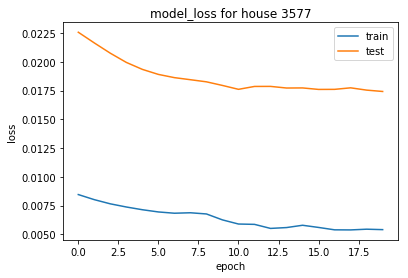

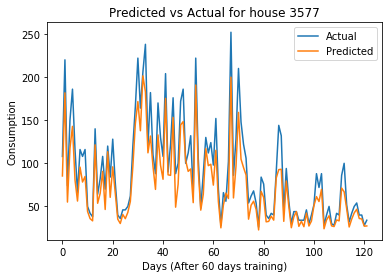

The mean difference between actual and predicted readings is 17.372707
The std between actual and predicted readings is 14.172883



LSTM For house no. 3635


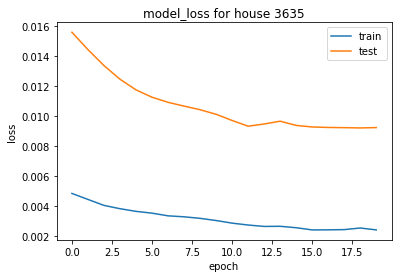

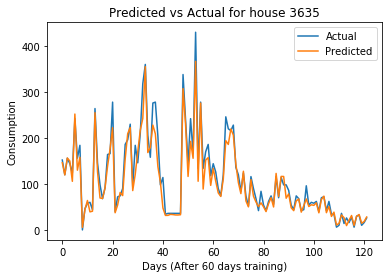

The mean difference between actual and predicted readings is 10.657984
The std between actual and predicted readings is 19.495860



LSTM For house no. 3723


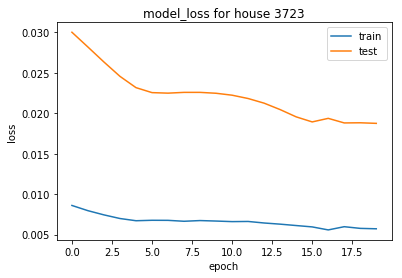

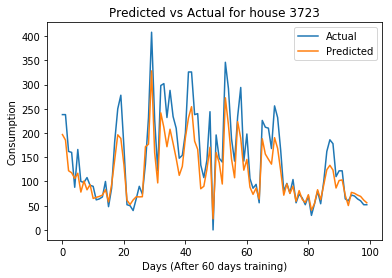

The mean difference between actual and predicted readings is 26.182429
The std between actual and predicted readings is 31.337654



LSTM For house no. 3778


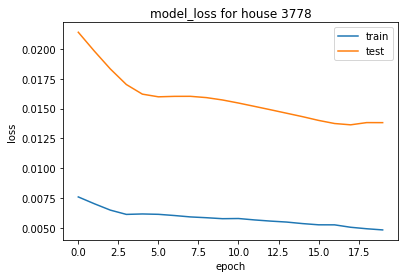

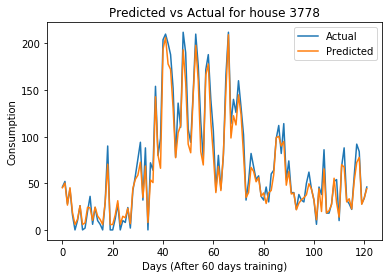

The mean difference between actual and predicted readings is 6.061008
The std between actual and predicted readings is 10.281852



LSTM For house no. 3849


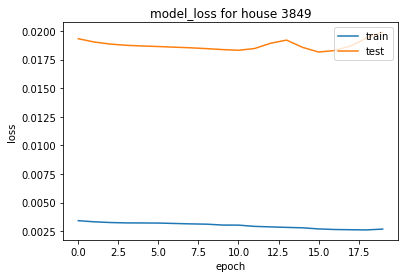

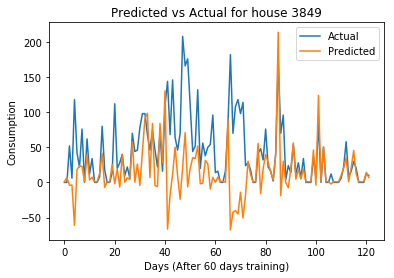

The mean difference between actual and predicted readings is 29.596040
The std between actual and predicted readings is 53.318885



LSTM For house no. 3893


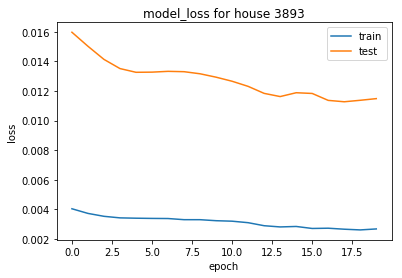

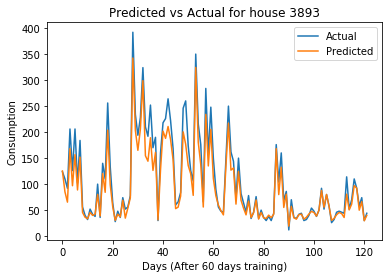

The mean difference between actual and predicted readings is 15.169131
The std between actual and predicted readings is 17.837435



LSTM For house no. 3918


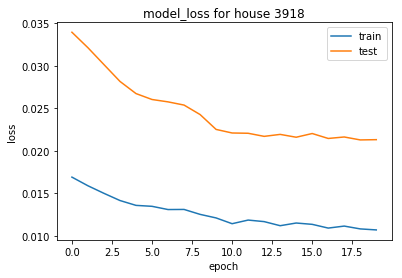

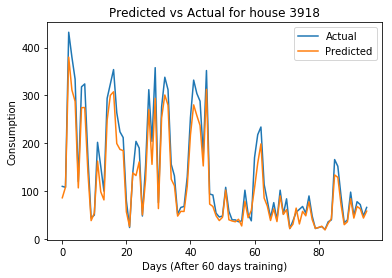

The mean difference between actual and predicted readings is 20.712589
The std between actual and predicted readings is 20.090681



LSTM For house no. 4029


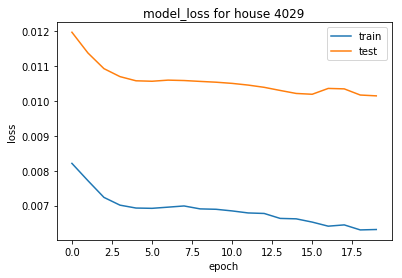

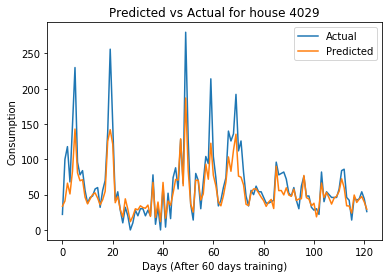

The mean difference between actual and predicted readings is 10.094759
The std between actual and predicted readings is 22.504046



LSTM For house no. 4031


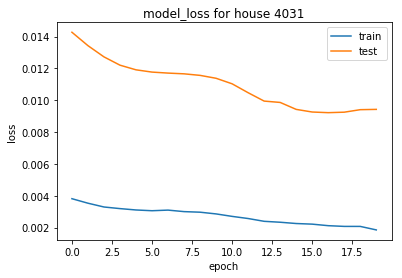

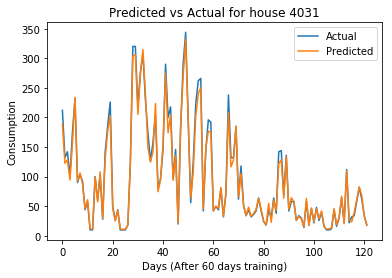

The mean difference between actual and predicted readings is 3.099573
The std between actual and predicted readings is 8.850021



LSTM For house no. 4193


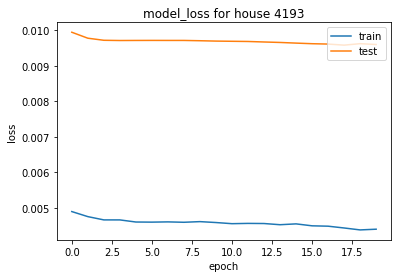

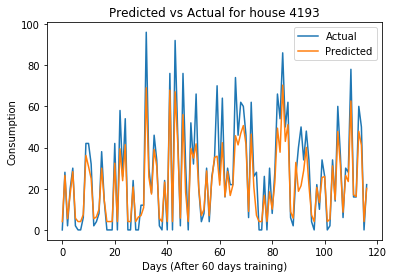

The mean difference between actual and predicted readings is 4.259217
The std between actual and predicted readings is 8.882345



LSTM For house no. 4228


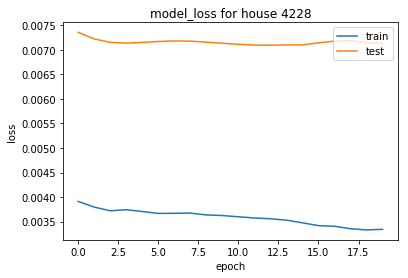

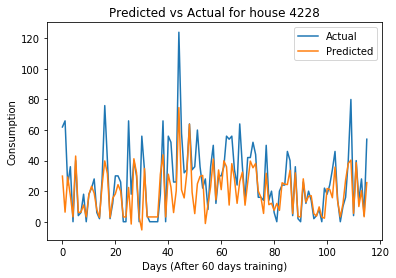

The mean difference between actual and predicted readings is 8.070073
The std between actual and predicted readings is 14.793761



LSTM For house no. 4296


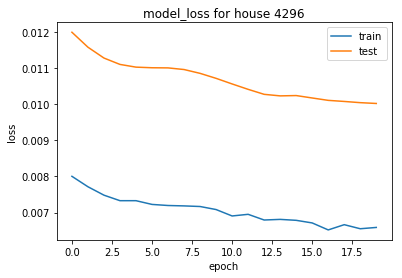

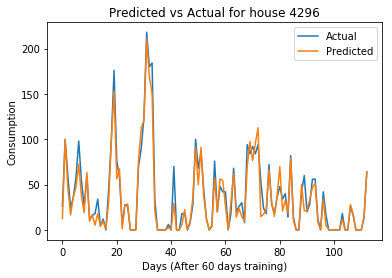

The mean difference between actual and predicted readings is 3.682658
The std between actual and predicted readings is 10.818092



LSTM For house no. 4352


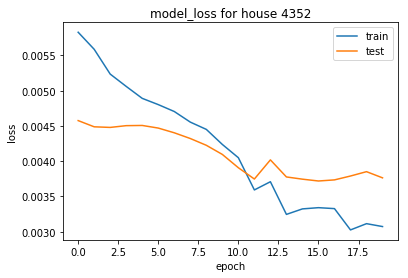

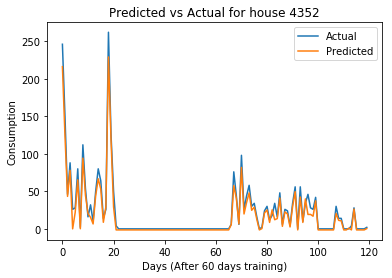

The mean difference between actual and predicted readings is 4.661499
The std between actual and predicted readings is 6.885479



LSTM For house no. 4356


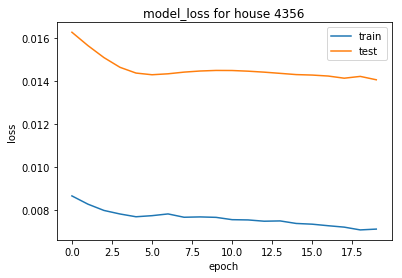

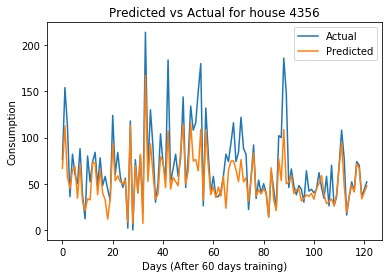

The mean difference between actual and predicted readings is 14.089740
The std between actual and predicted readings is 20.832419



LSTM For house no. 4373


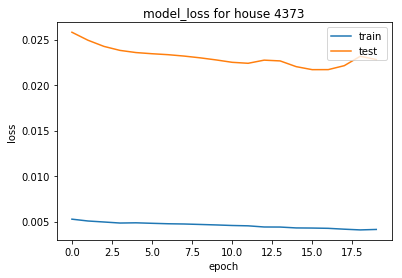

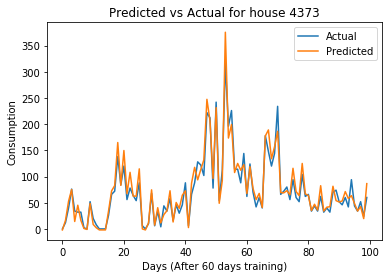

The mean difference between actual and predicted readings is -3.756198
The std between actual and predicted readings is 15.830381



LSTM For house no. 4421


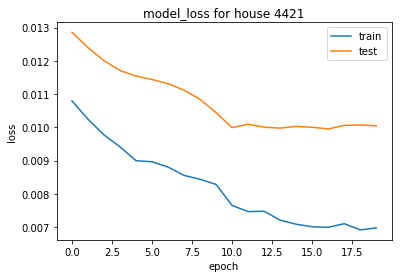

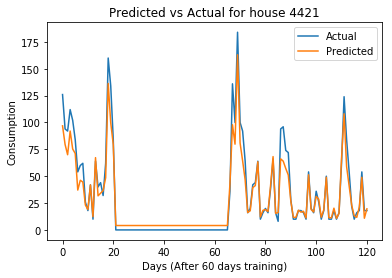

The mean difference between actual and predicted readings is 2.908050
The std between actual and predicted readings is 10.427491



LSTM For house no. 4447


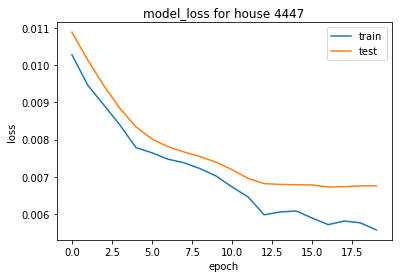

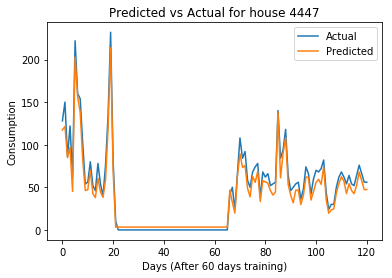

The mean difference between actual and predicted readings is 5.275136
The std between actual and predicted readings is 7.984163



LSTM For house no. 4514


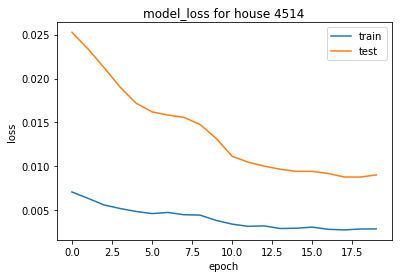

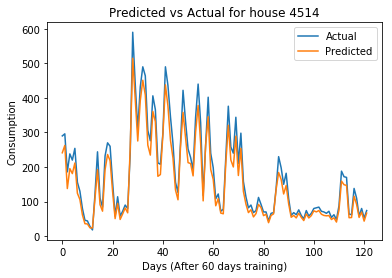

The mean difference between actual and predicted readings is 23.940506
The std between actual and predicted readings is 18.356225



LSTM For house no. 4671
4671 does not have enough data for accurate model fitting and prediction
LSTM For house no. 4732


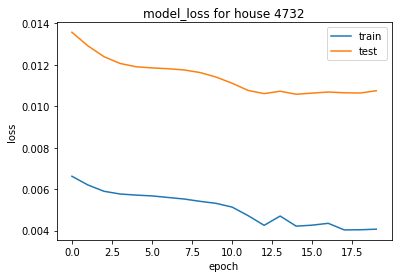

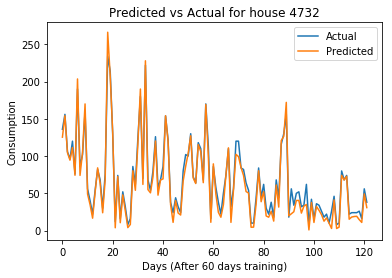

The mean difference between actual and predicted readings is 5.358906
The std between actual and predicted readings is 7.676952



LSTM For house no. 4767


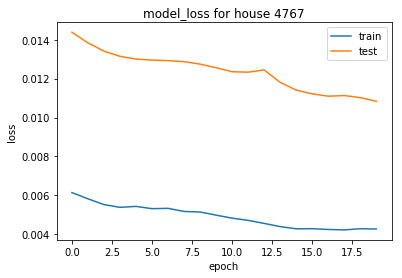

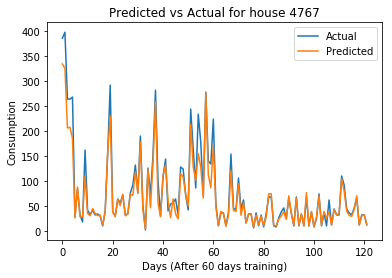

The mean difference between actual and predicted readings is 8.944729
The std between actual and predicted readings is 19.302995



LSTM For house no. 4874
4874 does not have enough data for accurate model fitting and prediction
LSTM For house no. 4998


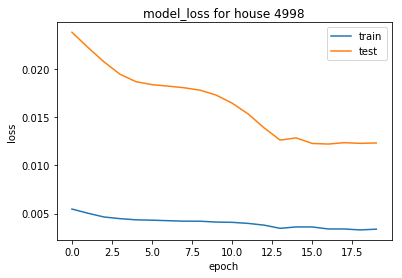

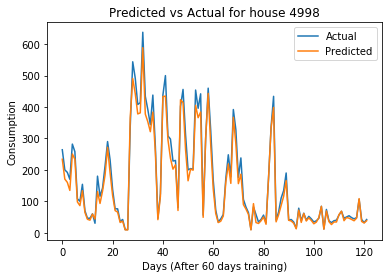

The mean difference between actual and predicted readings is 15.379215
The std between actual and predicted readings is 18.038921



LSTM For house no. 5129


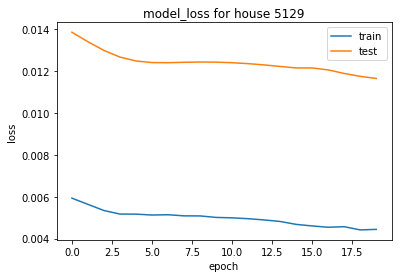

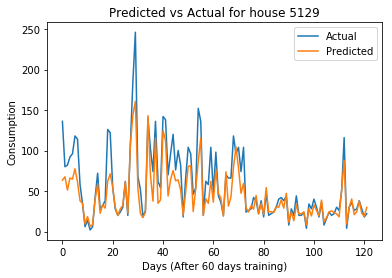

The mean difference between actual and predicted readings is 11.886300
The std between actual and predicted readings is 18.551641



LSTM For house no. 5131


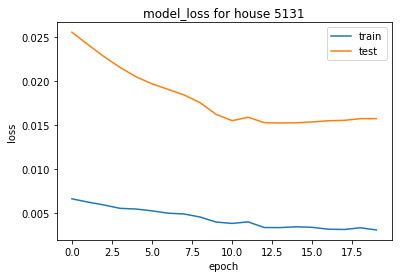

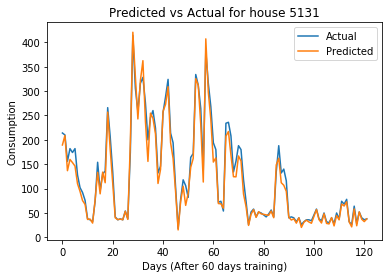

The mean difference between actual and predicted readings is 8.612651
The std between actual and predicted readings is 13.662000



LSTM For house no. 5193


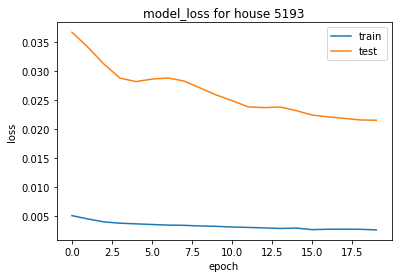

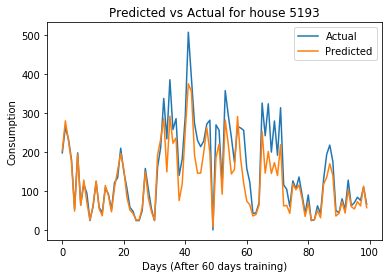

The mean difference between actual and predicted readings is 28.447522
The std between actual and predicted readings is 36.945392



LSTM For house no. 5275


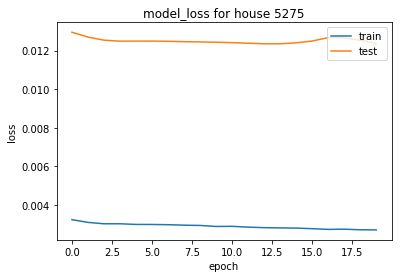

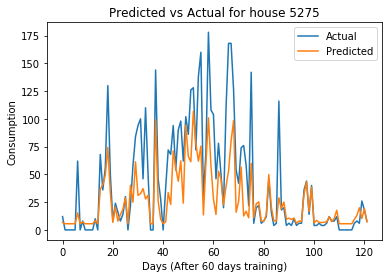

The mean difference between actual and predicted readings is 14.685761
The std between actual and predicted readings is 27.950572



LSTM For house no. 5317
5317 does not have enough data for accurate model fitting and prediction
LSTM For house no. 5395


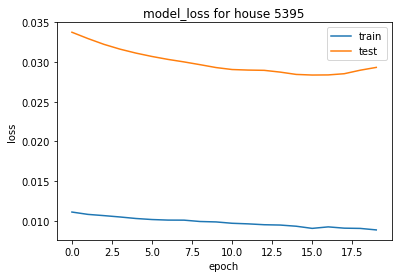

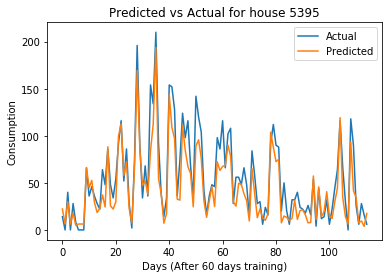

The mean difference between actual and predicted readings is 10.941937
The std between actual and predicted readings is 15.815961



LSTM For house no. 5403


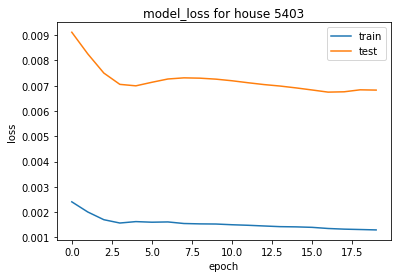

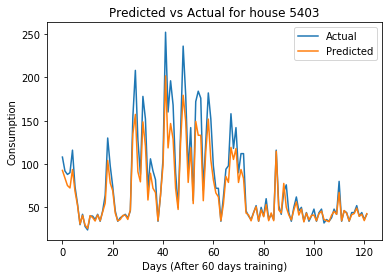

The mean difference between actual and predicted readings is 10.127052
The std between actual and predicted readings is 14.285190



LSTM For house no. 5439


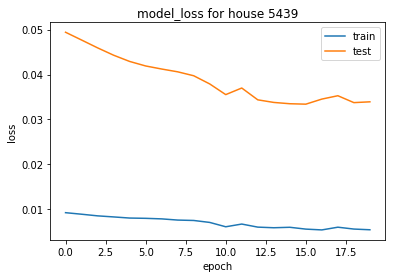

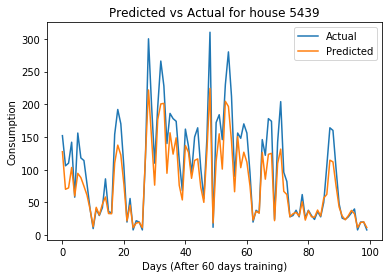

The mean difference between actual and predicted readings is 21.920137
The std between actual and predicted readings is 23.714789



LSTM For house no. 5484


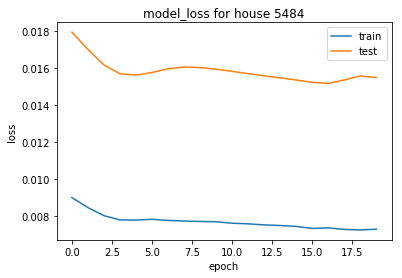

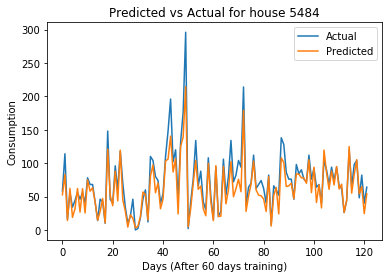

The mean difference between actual and predicted readings is 10.496012
The std between actual and predicted readings is 13.713577



LSTM For house no. 5545
5545 does not have enough data for accurate model fitting and prediction
LSTM For house no. 5636


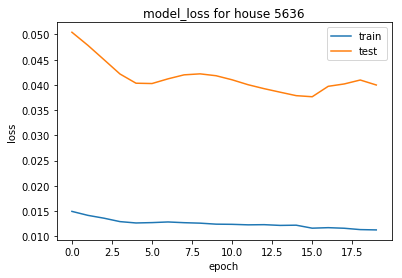

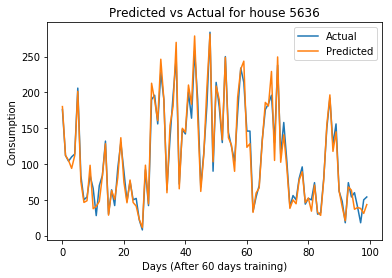

The mean difference between actual and predicted readings is 0.729454
The std between actual and predicted readings is 12.022223



LSTM For house no. 5658


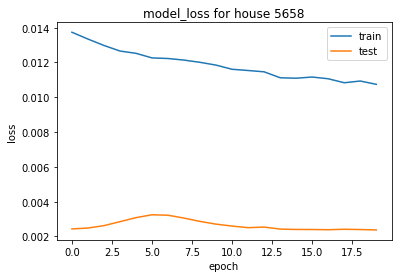

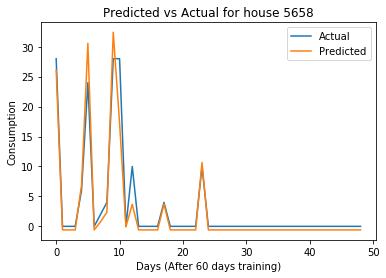

The mean difference between actual and predicted readings is 0.660646
The std between actual and predicted readings is 2.115949



LSTM For house no. 5785


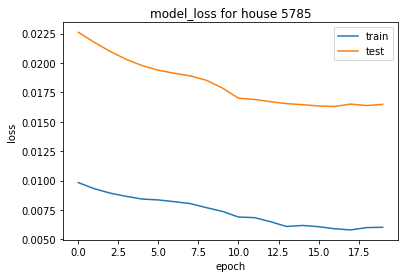

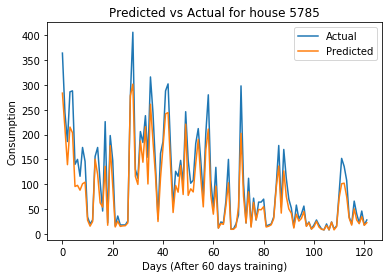

The mean difference between actual and predicted readings is 21.881400
The std between actual and predicted readings is 24.185368



LSTM For house no. 5810


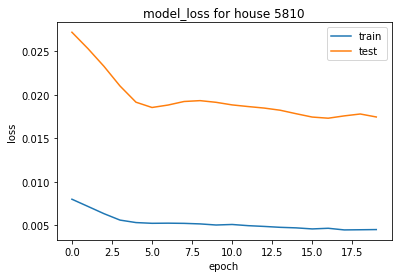

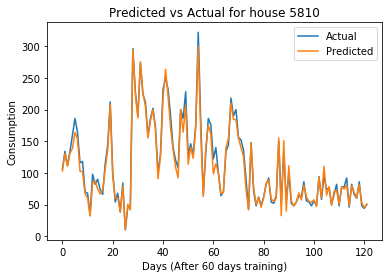

The mean difference between actual and predicted readings is 3.934137
The std between actual and predicted readings is 8.487203



LSTM For house no. 5814


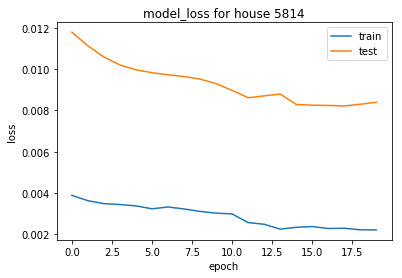

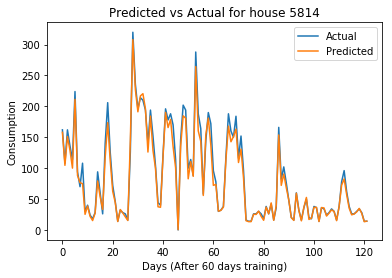

The mean difference between actual and predicted readings is 5.834982
The std between actual and predicted readings is 9.197713



LSTM For house no. 5892


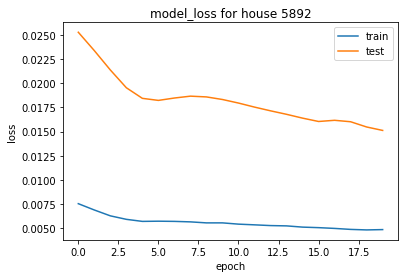

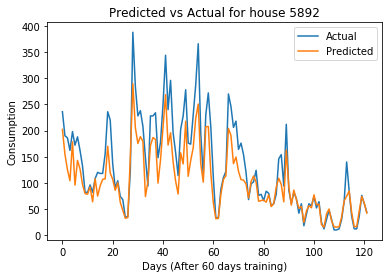

The mean difference between actual and predicted readings is 27.058082
The std between actual and predicted readings is 31.472119



LSTM For house no. 5972


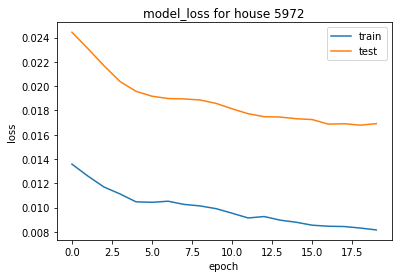

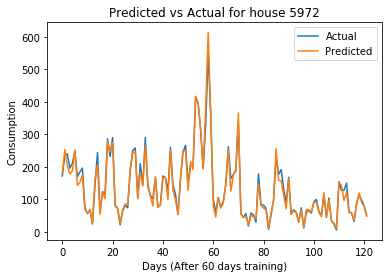

The mean difference between actual and predicted readings is 3.654633
The std between actual and predicted readings is 14.966734



LSTM For house no. 6101
6101 does not have enough data for accurate model fitting and prediction
LSTM For house no. 6412


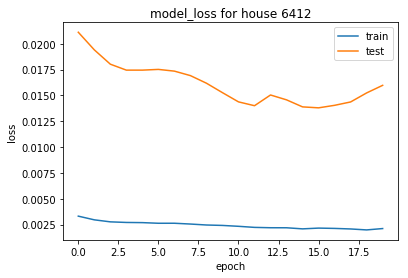

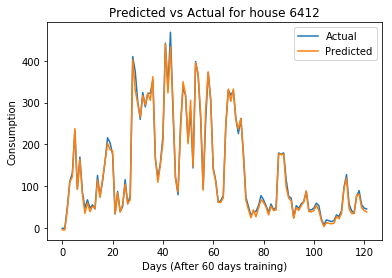

The mean difference between actual and predicted readings is 3.685201
The std between actual and predicted readings is 8.459053



LSTM For house no. 6505


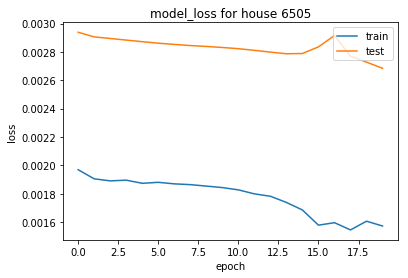

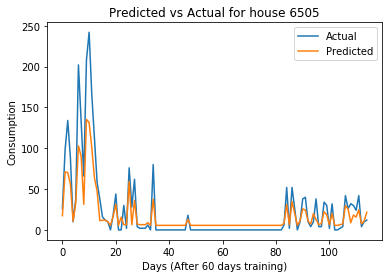

The mean difference between actual and predicted readings is 5.361650
The std between actual and predicted readings is 20.882822



LSTM For house no. 6578


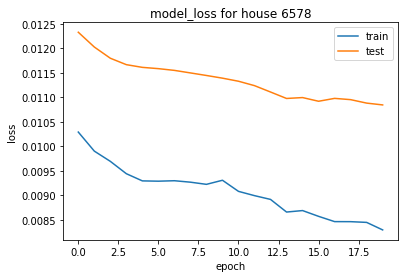

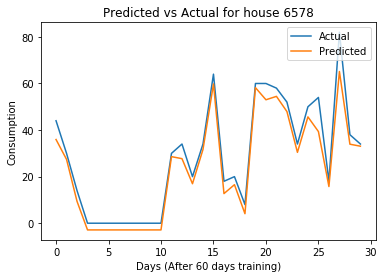

The mean difference between actual and predicted readings is 4.375814
The std between actual and predicted readings is 3.405939



LSTM For house no. 6673
6673 does not have enough data for accurate model fitting and prediction
LSTM For house no. 6685


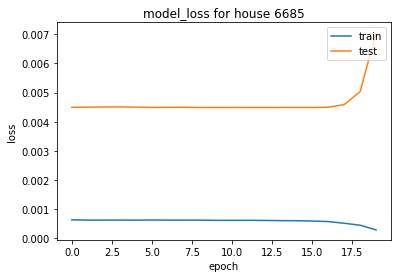

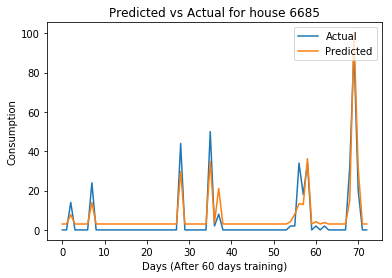

The mean difference between actual and predicted readings is -1.811581
The std between actual and predicted readings is 5.257672



LSTM For house no. 6830


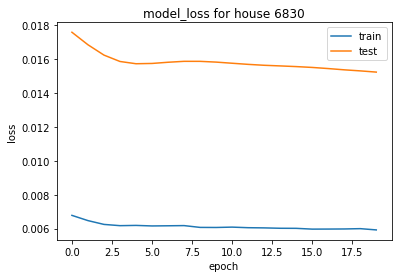

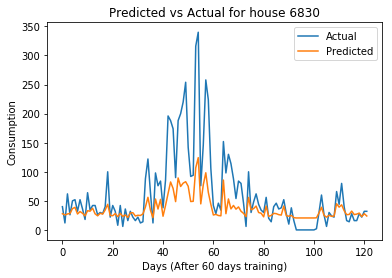

The mean difference between actual and predicted readings is 24.319954
The std between actual and predicted readings is 46.671998



LSTM For house no. 6836


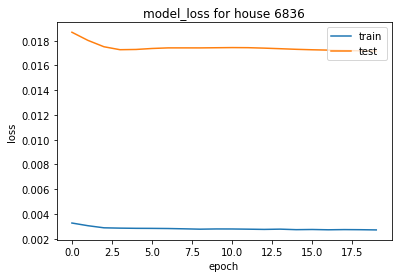

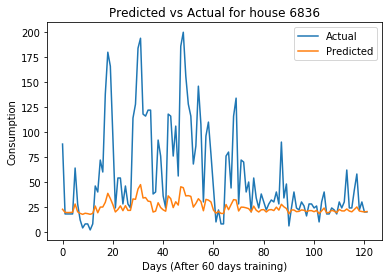

The mean difference between actual and predicted readings is 32.226160
The std between actual and predicted readings is 41.288154



LSTM For house no. 6863


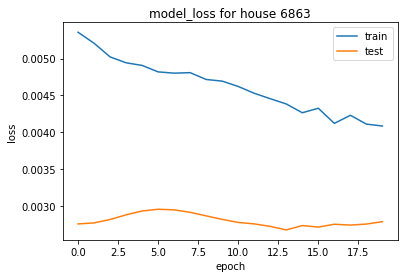

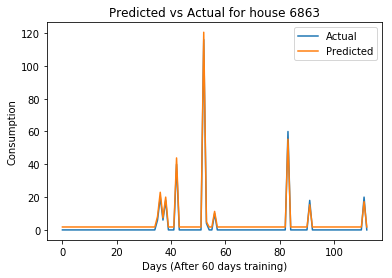

The mean difference between actual and predicted readings is -1.693920
The std between actual and predicted readings is 0.920471



LSTM For house no. 6910


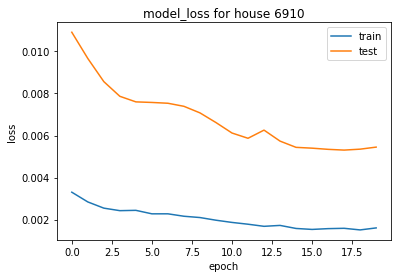

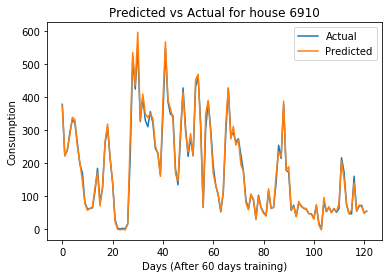

The mean difference between actual and predicted readings is -2.347388
The std between actual and predicted readings is 13.082335



LSTM For house no. 7016


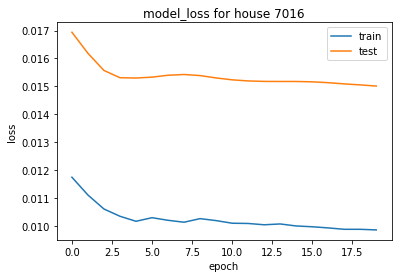

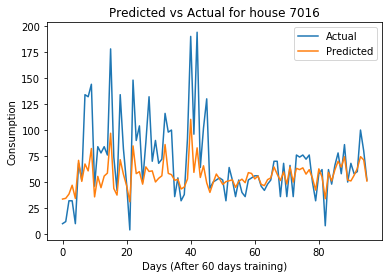

The mean difference between actual and predicted readings is 12.649744
The std between actual and predicted readings is 26.969218



LSTM For house no. 7017


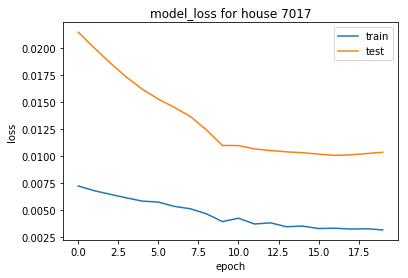

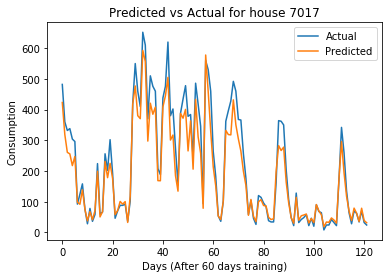

The mean difference between actual and predicted readings is 27.551969
The std between actual and predicted readings is 39.000461



LSTM For house no. 7030


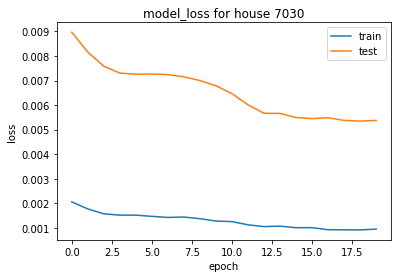

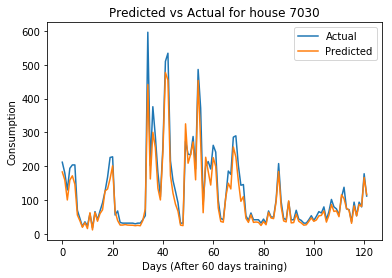

The mean difference between actual and predicted readings is 17.178594
The std between actual and predicted readings is 23.910381



LSTM For house no. 7117


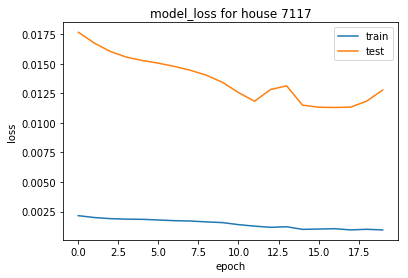

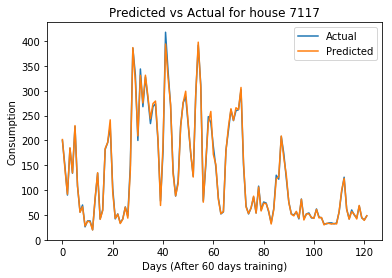

The mean difference between actual and predicted readings is 0.091519
The std between actual and predicted readings is 5.722516



LSTM For house no. 7287


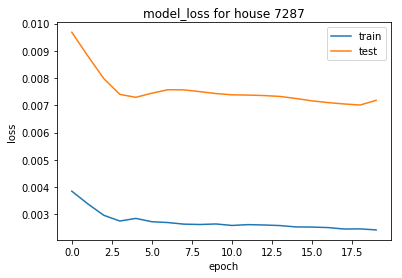

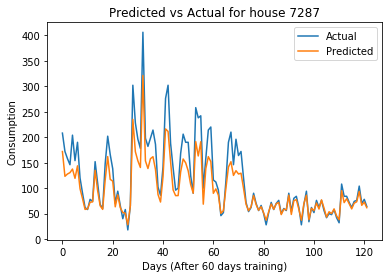

The mean difference between actual and predicted readings is 18.851909
The std between actual and predicted readings is 23.469619



LSTM For house no. 7429


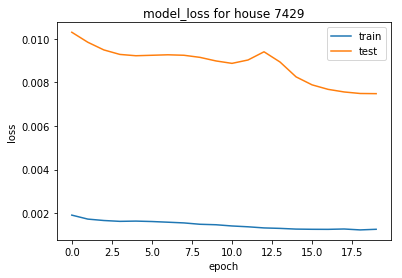

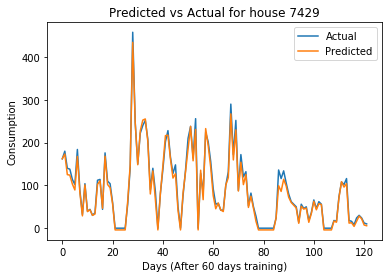

The mean difference between actual and predicted readings is 5.819875
The std between actual and predicted readings is 7.999254



LSTM For house no. 7460


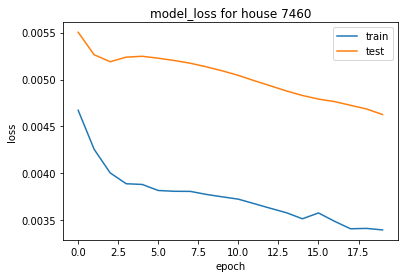

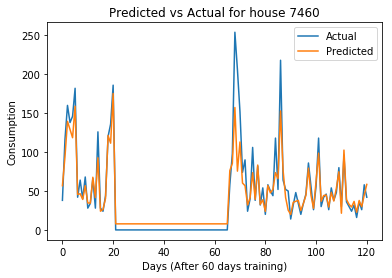

The mean difference between actual and predicted readings is 2.065689
The std between actual and predicted readings is 19.803394



LSTM For house no. 7566
7566 does not have enough data for accurate model fitting and prediction
LSTM For house no. 7674


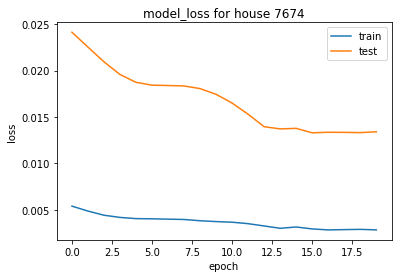

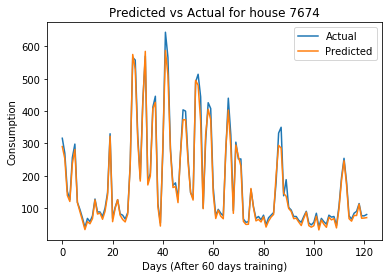

The mean difference between actual and predicted readings is 10.321252
The std between actual and predicted readings is 14.242093



LSTM For house no. 7682


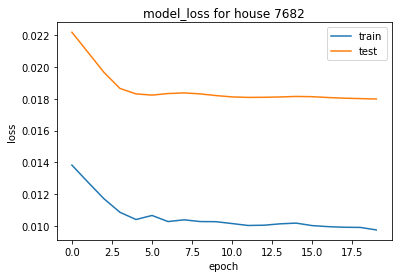

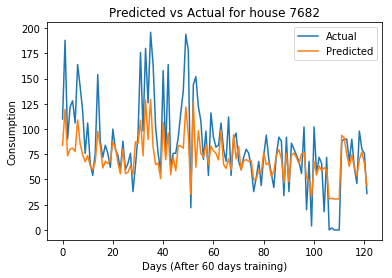

The mean difference between actual and predicted readings is 12.868135
The std between actual and predicted readings is 25.796555



LSTM For house no. 7739


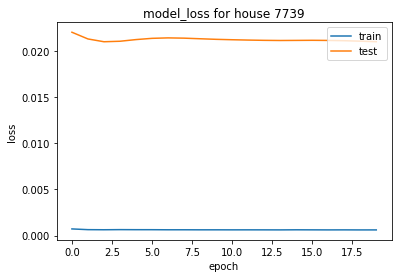

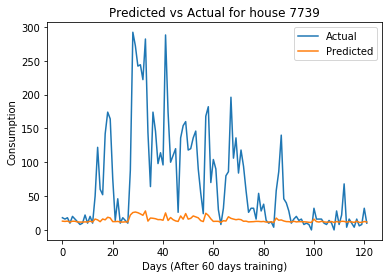

The mean difference between actual and predicted readings is 53.897415
The std between actual and predicted readings is 67.960086



LSTM For house no. 7741


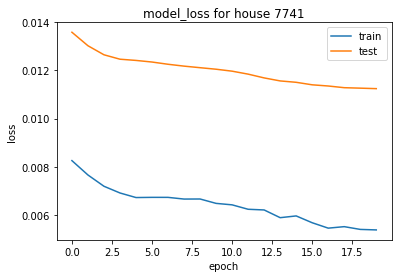

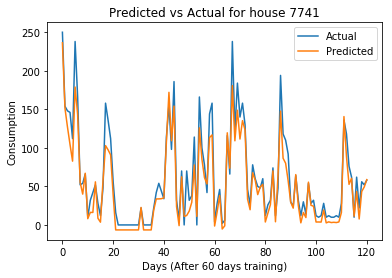

The mean difference between actual and predicted readings is 11.755233
The std between actual and predicted readings is 14.855030



LSTM For house no. 7794


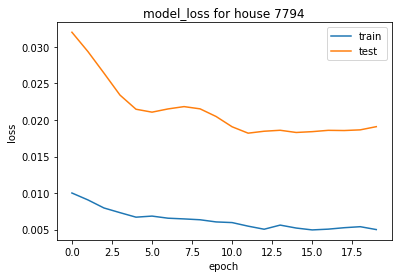

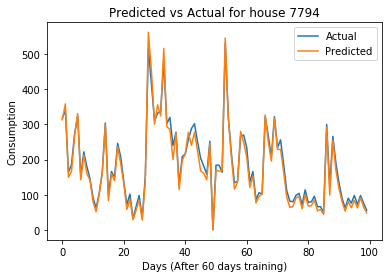

The mean difference between actual and predicted readings is 8.913163
The std between actual and predicted readings is 13.924863



LSTM For house no. 7900


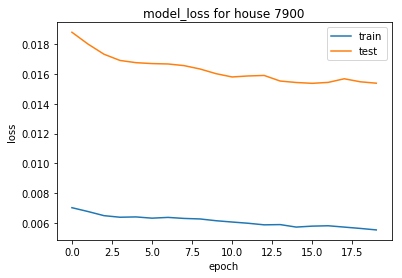

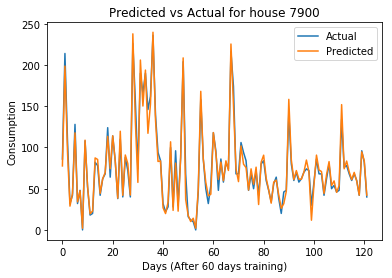

The mean difference between actual and predicted readings is 0.347509
The std between actual and predicted readings is 8.407738



LSTM For house no. 7919


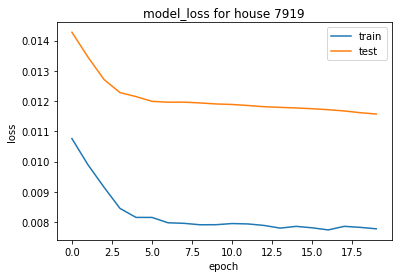

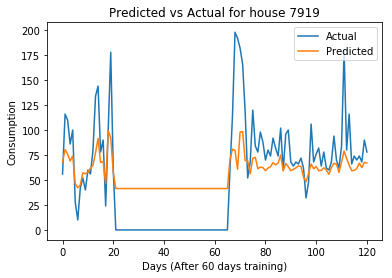

The mean difference between actual and predicted readings is -3.477424
The std between actual and predicted readings is 37.455280



LSTM For house no. 7965


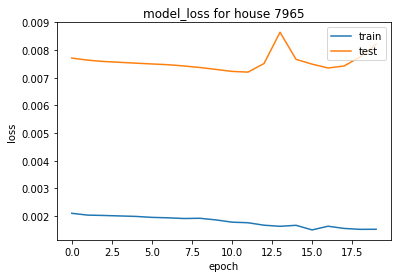

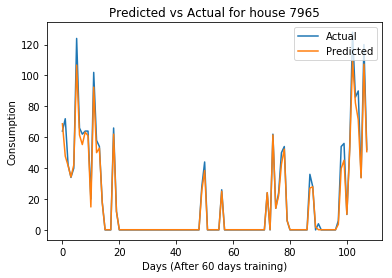

The mean difference between actual and predicted readings is 1.723998
The std between actual and predicted readings is 4.576423



LSTM For house no. 7989


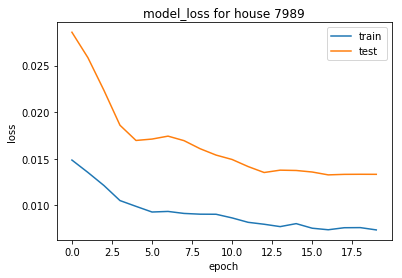

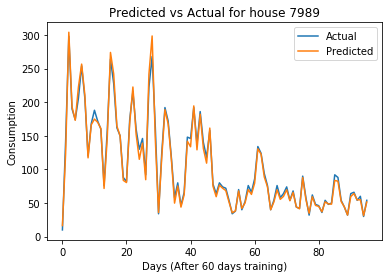

The mean difference between actual and predicted readings is 1.857571
The std between actual and predicted readings is 6.654158



LSTM For house no. 8059


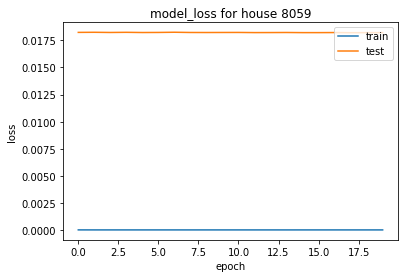

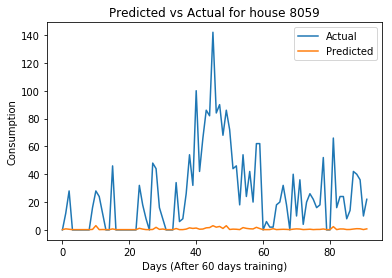

The mean difference between actual and predicted readings is 25.783528
The std between actual and predicted readings is 27.845182



LSTM For house no. 8084


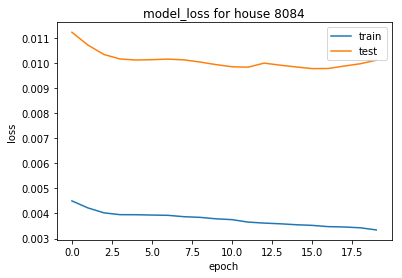

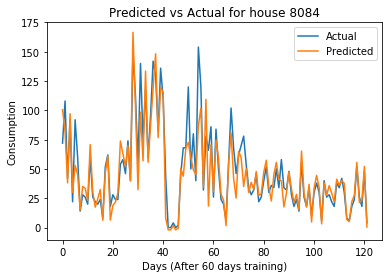

The mean difference between actual and predicted readings is 2.968575
The std between actual and predicted readings is 14.865782



LSTM For house no. 8086


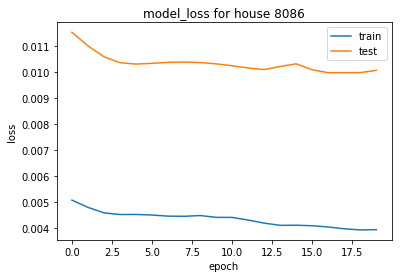

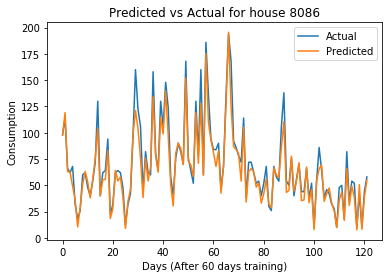

The mean difference between actual and predicted readings is 5.692628
The std between actual and predicted readings is 9.434013



LSTM For house no. 8155


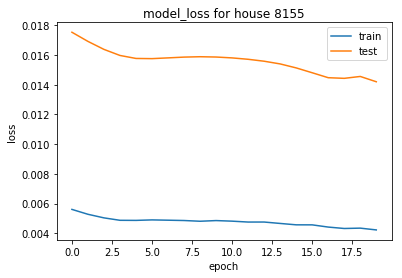

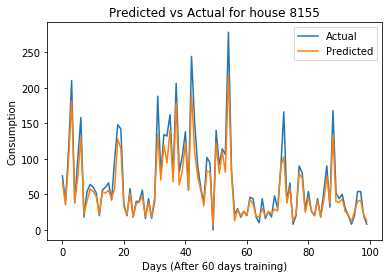

The mean difference between actual and predicted readings is 9.741201
The std between actual and predicted readings is 14.442535



LSTM For house no. 8156


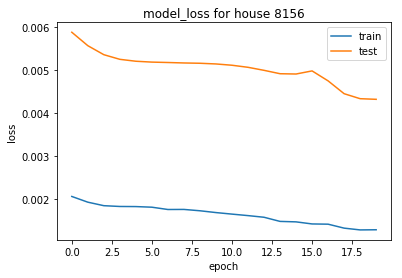

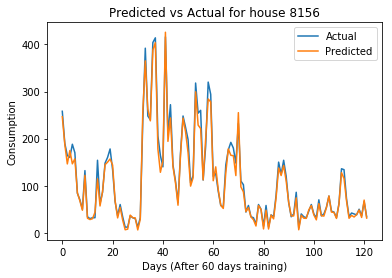

The mean difference between actual and predicted readings is 6.035432
The std between actual and predicted readings is 11.417321



LSTM For house no. 8244
8244 does not have enough data for accurate model fitting and prediction
LSTM For house no. 8386


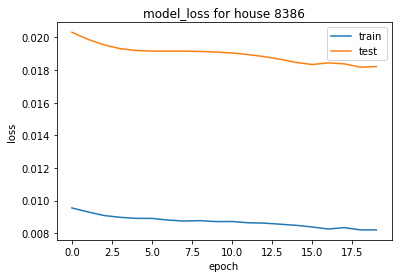

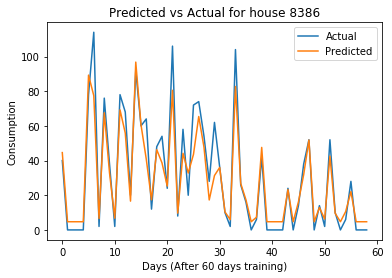

The mean difference between actual and predicted readings is 2.321069
The std between actual and predicted readings is 10.413847



LSTM For house no. 8467


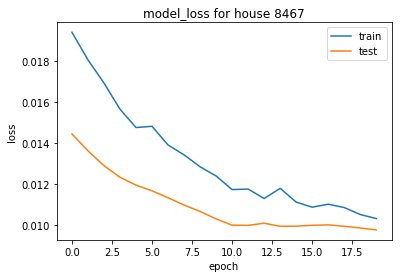

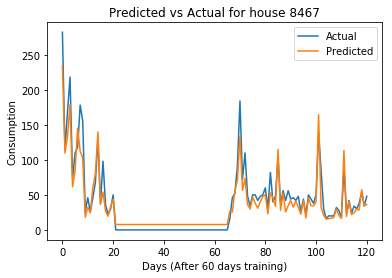

The mean difference between actual and predicted readings is 3.062031
The std between actual and predicted readings is 16.061751



LSTM For house no. 8703


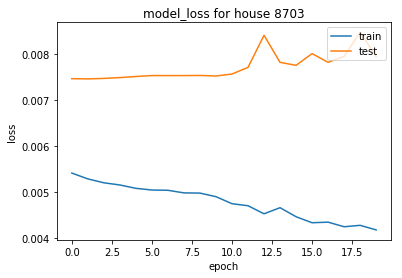

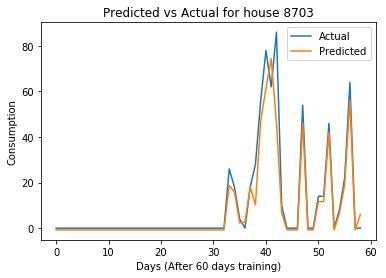

The mean difference between actual and predicted readings is 2.306784
The std between actual and predicted readings is 6.371526



LSTM For house no. 8829


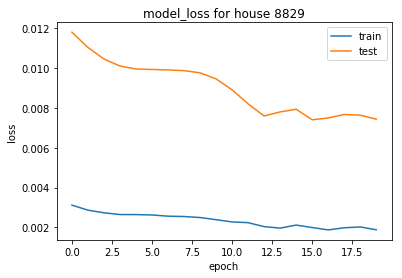

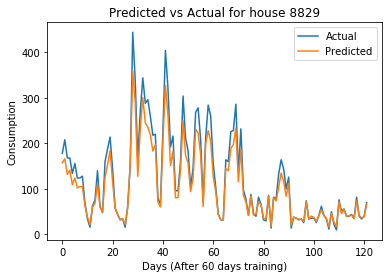

The mean difference between actual and predicted readings is 16.026651
The std between actual and predicted readings is 19.868944



LSTM For house no. 8890


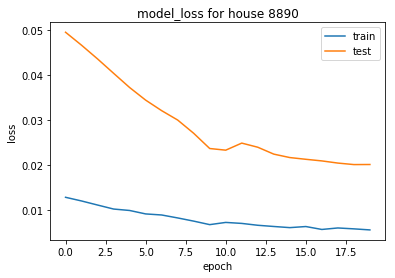

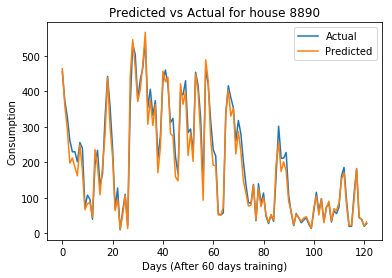

The mean difference between actual and predicted readings is 12.533817
The std between actual and predicted readings is 24.170915



LSTM For house no. 8967


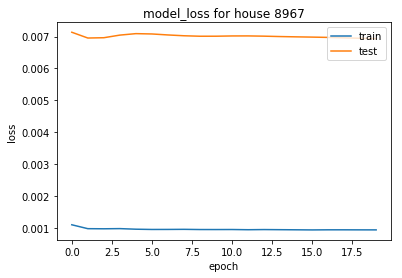

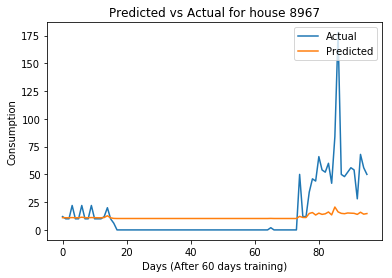

The mean difference between actual and predicted readings is 3.308258
The std between actual and predicted readings is 25.068545



LSTM For house no. 9052


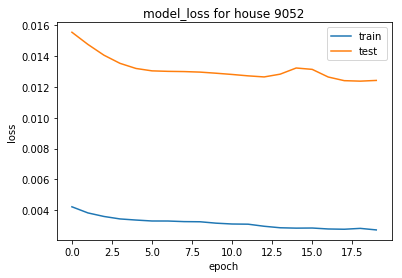

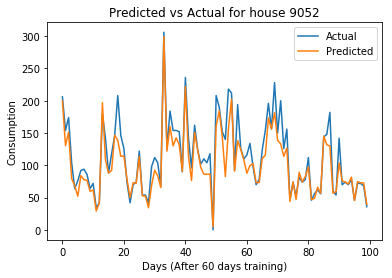

The mean difference between actual and predicted readings is 12.591218
The std between actual and predicted readings is 17.792975



LSTM For house no. 9121


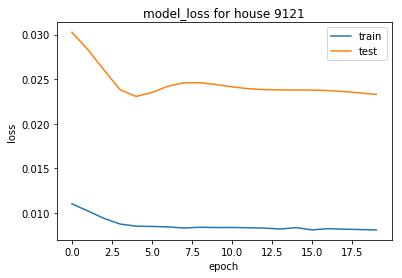

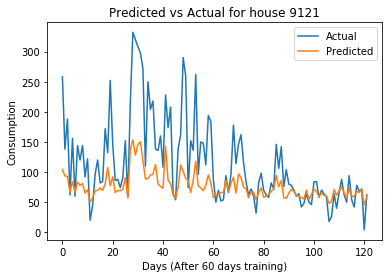

The mean difference between actual and predicted readings is 37.458076
The std between actual and predicted readings is 53.554640



LSTM For house no. 9134


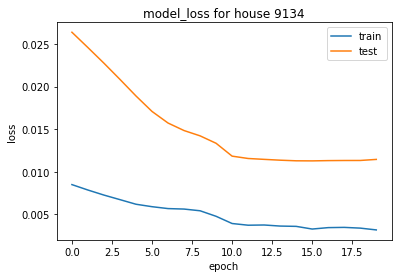

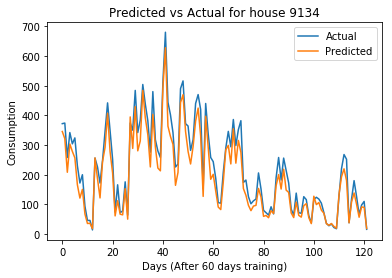

The mean difference between actual and predicted readings is 32.412268
The std between actual and predicted readings is 24.435370



LSTM For house no. 9160
9160 does not have enough data for accurate model fitting and prediction
LSTM For house no. 9278


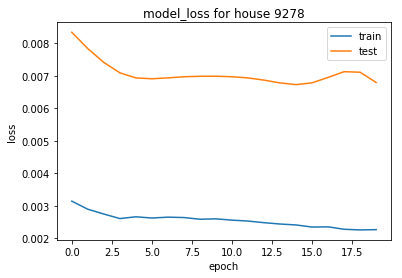

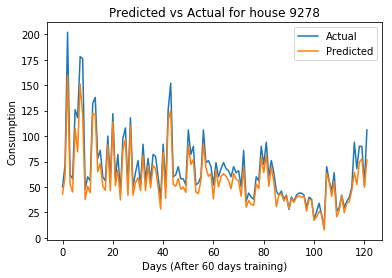

The mean difference between actual and predicted readings is 9.578114
The std between actual and predicted readings is 7.872273



LSTM For house no. 9295


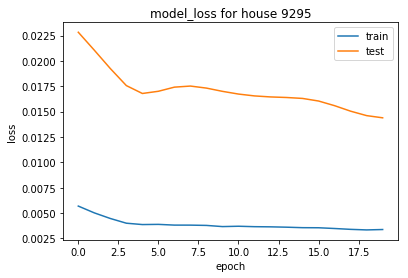

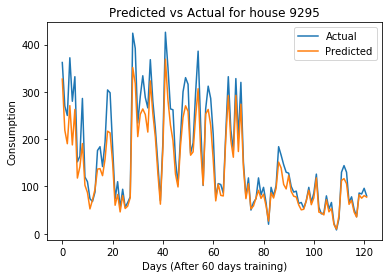

The mean difference between actual and predicted readings is 25.198041
The std between actual and predicted readings is 24.918443



LSTM For house no. 9474


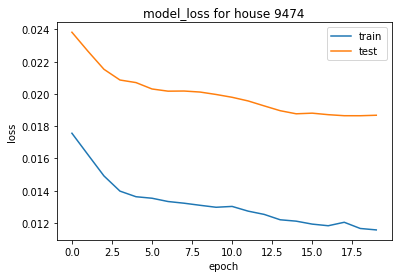

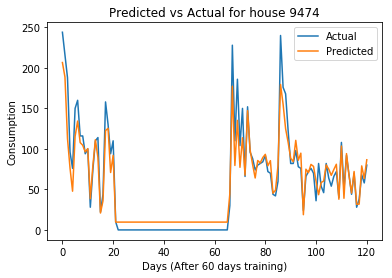

The mean difference between actual and predicted readings is 0.797086
The std between actual and predicted readings is 17.576960



LSTM For house no. 9600
9600 does not have enough data for accurate model fitting and prediction
LSTM For house no. 9620


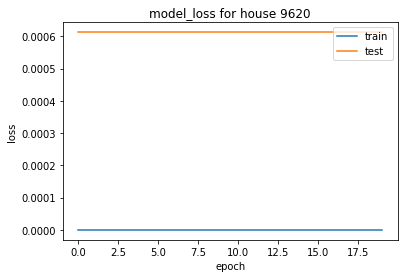

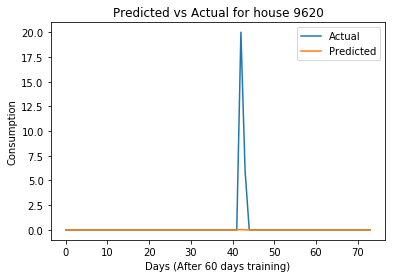

The mean difference between actual and predicted readings is 0.350819
The std between actual and predicted readings is 2.397498



LSTM For house no. 9631


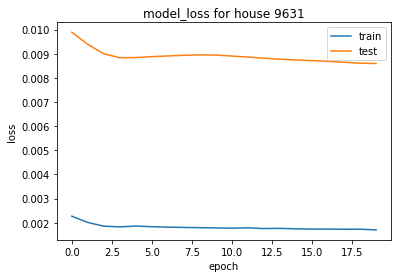

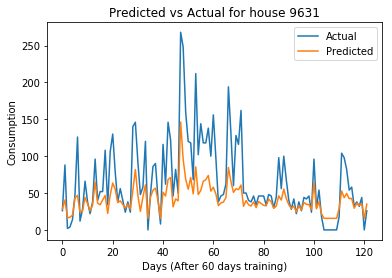

The mean difference between actual and predicted readings is 24.520103
The std between actual and predicted readings is 34.228675



LSTM For house no. 9639


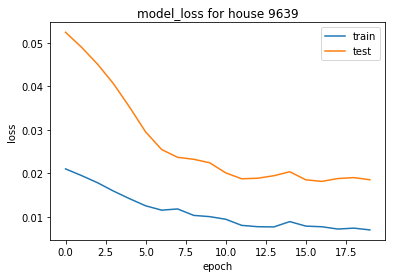

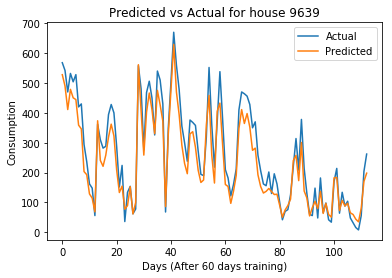

The mean difference between actual and predicted readings is 34.593508
The std between actual and predicted readings is 37.521044



LSTM For house no. 9729


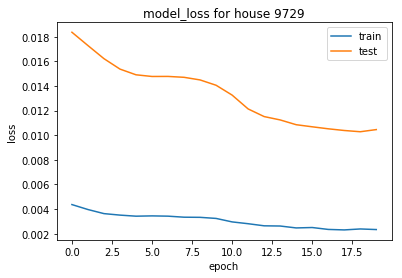

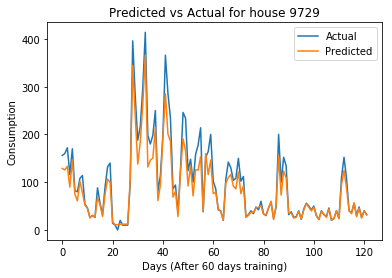

The mean difference between actual and predicted readings is 15.602992
The std between actual and predicted readings is 20.430226



LSTM For house no. 9766


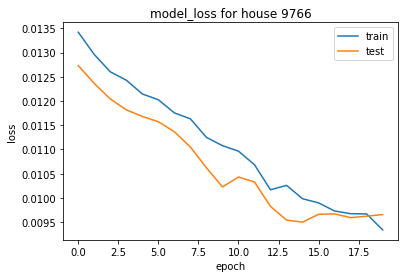

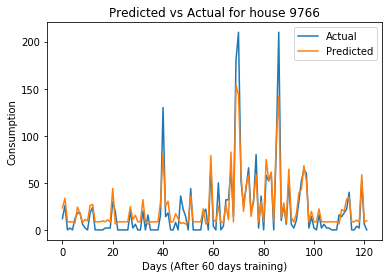

The mean difference between actual and predicted readings is -2.510906
The std between actual and predicted readings is 13.364093



LSTM For house no. 9849


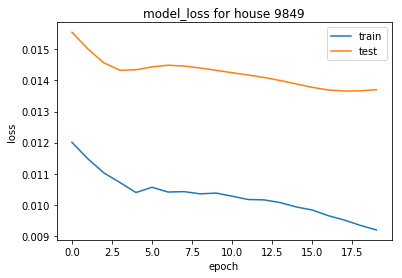

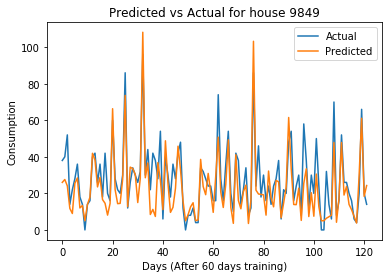

The mean difference between actual and predicted readings is 4.897913
The std between actual and predicted readings is 9.864743



LSTM For house no. 9956


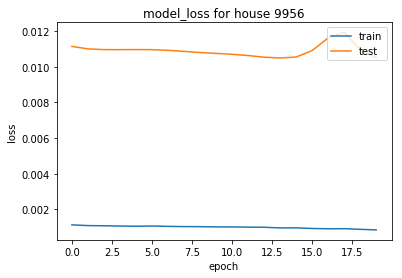

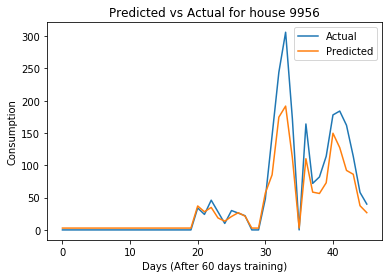

The mean difference between actual and predicted readings is 13.047613
The std between actual and predicted readings is 27.063845



LSTM For house no. 9982


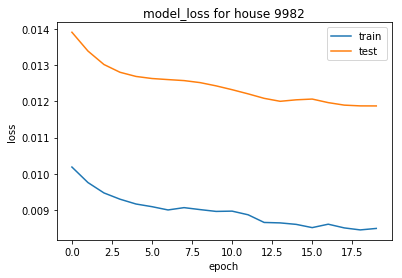

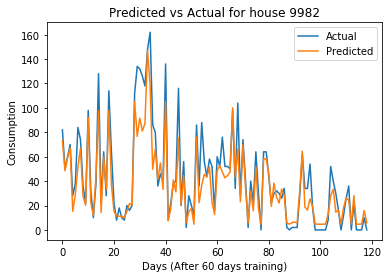

The mean difference between actual and predicted readings is 7.093831
The std between actual and predicted readings is 13.815075





In [31]:
#Code block to iterate through all 157 houses and produce prediction vs time plots and loss vs epochs plots

#Code takes about ~ 1 hour to complete for all 157 graphs

#x-axis on the graphs will vary depending on how many days of test data present in dataset.

#If the dataset started on 1-8-2015, the first reading on the graph will correspond to 1-10-2015 since 
    #the first 60 days of data is used in the training phase

houses_dup = houses
selected_house = 0

for house in houses_dup:
    difference_array = []
    selected_house = house
    print('LSTM For house no. %d' % selected_house)

    first_instance = True
    predict_consumption = []
    total_consumption = []
    
    selected_house = house
    concat_dataframe = house_selection(selected_house, concat_dataframe_ori)
    reframed, array_maxVal, array_minVal = scaling(concat_dataframe)
    train_Y1, train_X1, test_Y1, test_X1 = reshape_dataframe(reframed, 24, 60) #60
    
    #Make sure that all graphs that are plotted have at least 60 training points and 30 prediction points
    if train_X1.shape[0] >= 60 and train_Y1.shape[0] >= 60 and test_X1.shape[0] >=30 and test_Y1.shape[0] >=30:

        predict_daily_out, test_daily_out = run_LSTM(train_Y1, train_X1, test_Y1, test_X1, 24, array_maxVal, array_minVal, selected_house)
      

        i=0
        while i<len(predict_daily_out):
            difference_array.append(test_daily_out[i] - predict_daily_out[i])
            i+=1
        
        difference_mean = np.mean(difference_array)
        difference_std = np.std(difference_array)
        print("The mean difference between actual and predicted readings is %f" %difference_mean)
        print("The std between actual and predicted readings is %f" %difference_std)

        print("\n\n")

    else:
        print('%d does not have enough data for accurate model fitting and prediction' %selected_house)

**LSTM for the whole set of data**

The data obtained at this stage was largely accurate as shown in the majority of the predicted vs actual dataset plots exhibiting mean differences and std deviations below 10. That said, several of the individual datasets were very poorly predicted - pertinent examples include houses 5892, 7739, 7919 and 9121. In all 4 cases, the mean difference and std between the actual and predicted data were both in excess of 25 each - making them very poorly learned.

At this juncture, we noted that was that while all the individual houses were being trained for the same 60 day time period, and then validated across a minimum of 25 days, combining these predicted results to compare the gross efficacy of the predictions generated by the LSTM model as comapred to the actual obtained readings was slightly more involved.

This was primarily the start date for data captures for each of the houses was not necessarily the same. In this vein, omitting the first 60 days (since it was used for training) and plotting the remaining actual vs predicted data, it stands to reason that summing the predicted data that is arriving from different time periods will not match the actual data - even if the prediction from each of the individual house datasets is a 100% match with regards to the actual data. 

From this standpoint, we opted to aggregate the data from all the houses into a single dataset running for the entirety of the 6 month duration. This effectively meant that we were zero padding the original dataset for houses with insufficient data points (such as house 44). The findings for the subsequent section are shown in the following section.

Besides implementing the LSTM model for each individual house, we decided to implement the LSTM model for the combined readings per hour throughout the whole time period. The mean difference and sd between the actual and predicted readings are within the desired range. 

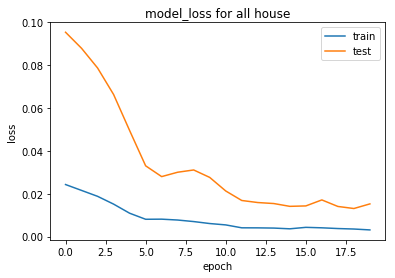

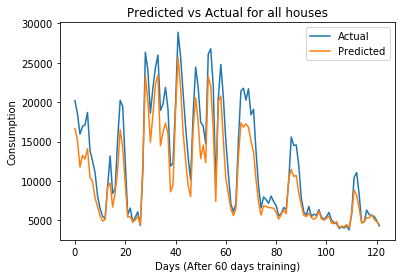

The mean difference between actual and predicted readings is 1999.931535
The std between actual and predicted readings is 1764.704515


In [32]:
## Copy dataframe derived for Linear regression model in section 2.1
df_LSTM_combined = df_altogether.copy()
## Padding to fit the input of helper function 
df_LSTM_combined['pp'] = list(range(0,4392))
df_LSTM_combined['qq'] = list(range(0,4392))

## Rearranging 
df_LSTM_combined = df_LSTM_combined[['num_houses','meter_reading','meter_usage','pp','qq','averaged']]

difference_array = []
reframed, array_maxVal, array_minVal = scaling(df_LSTM_combined)
train_Y1, train_X1, test_Y1, test_X1 = reshape_dataframe(reframed, 24, 60)
predict_daily_out, test_daily_out = run_LSTM(train_Y1, train_X1, test_Y1, test_X1, 24, array_maxVal, array_minVal, 'all')

i=0
while i<len(predict_daily_out):
    difference_array.append(test_daily_out[i] - predict_daily_out[i])
    i+=1

difference_mean = np.mean(difference_array)
difference_std = np.std(difference_array)
print("The mean difference between actual and predicted readings is %f" %difference_mean)
print("The std between actual and predicted readings is %f" %difference_std)

**Conclusion**

In conclusion, the LSTM model shows a relatively accurate prediction of the forecasted gas consumption given 60 days of training. The output predictions from the LSTM appear to be far more accurate that those genereated by the lienar regression model. This shows the importance and the superiority of a non-linear model as compared to a linear one. 

The LSTM does come with its limitations. Several of the individual datasets were very poorly predicted - pertinent examples include houses 5892, 7739, 7919 and 9121. In all 4 cases, the mean difference and std between the actual and predicted data were both in excess of 25 each - making them very poorly learned. This could likely be mitigated with better tuning hyperparameters that promote better learning without subjecting the model to overfitting. 

The aggregated model showed good accuracy and can be taken as a good starting point for the gas provider in predicting daily consumption of gas data. Further work is necessary in improving the prediction accuracy even further.

From a conceptual perspective, the memory cell within the LSTM adds several more weights to each node, all of which must be trained. This increases the dimensionality to the hidden layer, and may potentially take more iterations to find an optimal solution. In this case, the training was set to 20 epochs, but could potentially be increased to in order to further reduce the validation loss after the training phase.


**Future Work**

For future work, the LSTM can be applied for different time periods such as monthly and weekly readings. This is particularly relevant for the gas provider as its contractual agreemnents may only permit changes in the amount of gas purchased on either a daily, weekly or monthly basis.

In addition, we would like to incorporate multiple inputs into the LSTM. Datasets from pecanstreet.org containing as water and electricity consumption can be factored into the learning to find more trends, enhancing the accuracy of the model. Currently the LSTM is takes in a single featured input and produces a singule featured output. Having more input features will better allow the LSTM to identify patterns in the data and better anticipate and predict the output data. Furthermore, with additional datasets from Pecan Street, the LSTM model will only get more accurate with more training data  without being subject to the vanishing gradient problem due to its memory cell.


**Learning Points**

The project has equipped us with a better appreciation importance of basic signal processing and data manipulation. The raw data provided for this project depicting the gas consumption of the 157 houses had irregular sampling frequencies, noise, erronous readings and different reading intervals - necessitating the need for initial data manipulation. Even though the data manipulation techniques that we had employed were fairly simple, they proved to be effective in improving the clarity of the data that was subsequently operated on. Without this step, any subsequent steps such as forecasting future readings would have been inaccurate due to the pre-existing anomalies or errors in the given dataset.

Another factor that we appreciated in this project was the flexibility offered in terms of how to interpret the data as we saw best. This was a relatively new experience, as most other projects allocated to us generally have much tighter guidelines. This made the project far more interesting, and made the presentation sessions a great learning oppourtunity when it came to understanding how differently other teams interpreted and manipulated the same data.